In [1]:
from typing import List
from torch import Tensor
import torch
import torchaudio
import os

import sys
sys.path.append("/home/arunima/ASR/whisper")
import whisper
from whisper import DecodingOptions
from whisper.tokenizer import get_tokenizer

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

class LibriSpeech(torch.utils.data.Dataset):
    """
    A simple class to wrap LibriSpeech and trim/pad the audio to 30 seconds.
    It will drop the last few seconds of a very small portion of the utterances.
    """
    def __init__(self, split="test-clean", device=DEVICE):
        self.dataset = torchaudio.datasets.LIBRISPEECH(
            root=os.path.expanduser("~/.cache"),
            url=split,
            download=True,
        )
        self.device = device

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, item):
        audio, sample_rate, text, _, _, _ = self.dataset[item]
        assert sample_rate == 16000
        duration = audio.shape[1]
        audio = whisper.pad_or_trim(audio.flatten()).to(self.device)
        mel = whisper.log_mel_spectrogram(audio)
        
        return [mel, text, duration]
    

In [42]:


dataset = LibriSpeech("test-clean")
# loader = torch.utils.data.DataLoader(dataset,batch_size=2)
loader = [dataset.__getitem__(i) for i in range(0,4)]

model = whisper.load_model("tiny")
language =  "english"
tokenizer = get_tokenizer(
            model.is_multilingual,
            num_languages=model.num_languages,
            language=language,
            task="transcribe",
        )

/home/arunima/ASR/whisper/whisper/__init__.py:150: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(fp, map_location=device)


ModelDimensions(n_mels=80, n_audio_ctx=1500, n_audio_state=384, n_audio_head=6, n_audio_layer=4, n_vocab=51865, n_text_ctx=448, n_text_state=384, n_text_head=6, n_text_layer=4)


In [43]:
import ipywidgets as widgets

languages = {"af_za": "Afrikaans", "am_et": "Amharic", "ar_eg": "Arabic", "as_in": "Assamese", "az_az": "Azerbaijani", "be_by": "Belarusian", "bg_bg": "Bulgarian", "bn_in": "Bengali", "bs_ba": "Bosnian", "ca_es": "Catalan", "cmn_hans_cn": "Chinese", "cs_cz": "Czech", "cy_gb": "Welsh", "da_dk": "Danish", "de_de": "German", "el_gr": "Greek", "en_us": "English", "es_419": "Spanish", "et_ee": "Estonian", "fa_ir": "Persian", "fi_fi": "Finnish", "fil_ph": "Tagalog", "fr_fr": "French", "gl_es": "Galician", "gu_in": "Gujarati", "ha_ng": "Hausa", "he_il": "Hebrew", "hi_in": "Hindi", "hr_hr": "Croatian", "hu_hu": "Hungarian", "hy_am": "Armenian", "id_id": "Indonesian", "is_is": "Icelandic", "it_it": "Italian", "ja_jp": "Japanese", "jv_id": "Javanese", "ka_ge": "Georgian", "kk_kz": "Kazakh", "km_kh": "Khmer", "kn_in": "Kannada", "ko_kr": "Korean", "lb_lu": "Luxembourgish", "ln_cd": "Lingala", "lo_la": "Lao", "lt_lt": "Lithuanian", "lv_lv": "Latvian", "mi_nz": "Maori", "mk_mk": "Macedonian", "ml_in": "Malayalam", "mn_mn": "Mongolian", "mr_in": "Marathi", "ms_my": "Malay", "mt_mt": "Maltese", "my_mm": "Myanmar", "nb_no": "Norwegian", "ne_np": "Nepali", "nl_nl": "Dutch", "oc_fr": "Occitan", "pa_in": "Punjabi", "pl_pl": "Polish", "ps_af": "Pashto", "pt_br": "Portuguese", "ro_ro": "Romanian", "ru_ru": "Russian", "sd_in": "Sindhi", "sk_sk": "Slovak", "sl_si": "Slovenian", "sn_zw": "Shona", "so_so": "Somali", "sr_rs": "Serbian", "sv_se": "Swedish", "sw_ke": "Swahili", "ta_in": "Tamil", "te_in": "Telugu", "tg_tj": "Tajik", "th_th": "Thai", "tr_tr": "Turkish", "uk_ua": "Ukrainian", "ur_pk": "Urdu", "uz_uz": "Uzbek", "vi_vn": "Vietnamese", "yo_ng": "Yoruba"}
selection = widgets.Dropdown(
    options=[("Select language", None), ("----------", None)] + sorted([(f"{v} ({k})", k) for k, v in languages.items()]),
    value="ko_kr",
    description='Language:',
    disabled=False,
)

selection

Dropdown(description='Language:', index=39, options=(('Select language', None), ('----------', None), ('Afrika…

In [44]:
import string
import matplotlib.pyplot as plt
import matplotlib.font_manager as fm
import matplotlib.ticker as ticker

from IPython.display import display, HTML
from whisper.tokenizer import get_tokenizer
from dtw import dtw
from scipy.ndimage import median_filter

%matplotlib inline
%config InlineBackend.figure_format = "retina"

In [45]:
AUDIO_SAMPLES_PER_TOKEN = whisper.audio.HOP_LENGTH * 2
AUDIO_TIME_PER_TOKEN = AUDIO_SAMPLES_PER_TOKEN / whisper.audio.SAMPLE_RATE

medfilt_width = 7
qk_scale = 1.0


In [46]:
def split_tokens_on_unicode(tokens: torch.Tensor):
    words = []
    word_tokens = []
    current_tokens = []
    
    for token in tokens.tolist():
        current_tokens.append(token)
        decoded = tokenizer.decode_with_timestamps(current_tokens)
        if "\ufffd" not in decoded:
            words.append(decoded)
            word_tokens.append(current_tokens)
            current_tokens = []
    
    return words, word_tokens

In [47]:
def split_tokens_on_spaces(tokens: torch.Tensor):
    subwords, subword_tokens_list = split_tokens_on_unicode(tokens)
    words = []
    word_tokens = []
    
    for subword, subword_tokens in zip(subwords, subword_tokens_list):
        special = subword_tokens[0] >= tokenizer.eot
        with_space = subword.startswith(" ")
        punctuation = subword.strip() in string.punctuation
        if special or with_space or punctuation:
            words.append(subword)
            word_tokens.append(subword_tokens)
        else:
            words[-1] = words[-1] + subword
            word_tokens[-1].extend(subword_tokens)
    
    return words, word_tokens

In [48]:

import pandas as pd
import urllib

from tqdm.notebook import tqdm

def download(url: str, target_path: str):
    with urllib.request.urlopen(url) as source, open(target_path, "wb") as output:
        with tqdm(total=int(source.info().get("Content-Length")), ncols=80, unit='iB', unit_scale=True, unit_divisor=1024) as loop:
            while True:
                buffer = source.read(8192)
                if not buffer:
                    break

                output.write(buffer)
                loop.update(len(buffer))

In [49]:
# This part downloads a repackaged version of the Noto Sans font (either CJK or non-CJK)
# to render various languages in Matplotlib figures.
lang = 'english'
# if languages[lang] in {"Chinese", "Japanese", "Korean"}:
#     font = "GoNotoCJKCore.ttf"
# else:
font = "GoNotoCurrent.ttf"

font_release = "https://github.com/satbyy/go-noto-universal/releases/download/v5.2"
if not os.path.exists(font):
    download(f"{font_release}/{font}", font)

prop = fm.FontProperties(fname=font)
props = {'fontproperties': prop}

In [50]:
# if languages[lang] in {"Chinese", "Japanese", "Thai", "Lao", "Myanmar"}:
#     # These languages don't typically use spaces, so it is difficult to split words
#     # without morpheme analysis. Here, we instead split words at any
#     # position where the tokens are decoded as valid unicode points
#     split_tokens = split_tokens_on_unicode
# else:
split_tokens = split_tokens_on_spaces

In [51]:
# install hooks on the cross attention layers to retrieve the attention weights
QKs = [None] * model.dims.n_text_layer

for i, block in enumerate(model.decoder.blocks):
    block.cross_attn.register_forward_hook(
        lambda _, ins, outs, index=i: QKs.__setitem__(index, outs[-1])
    )

  0%|          | 0/4 [00:00<?, ?it/s]

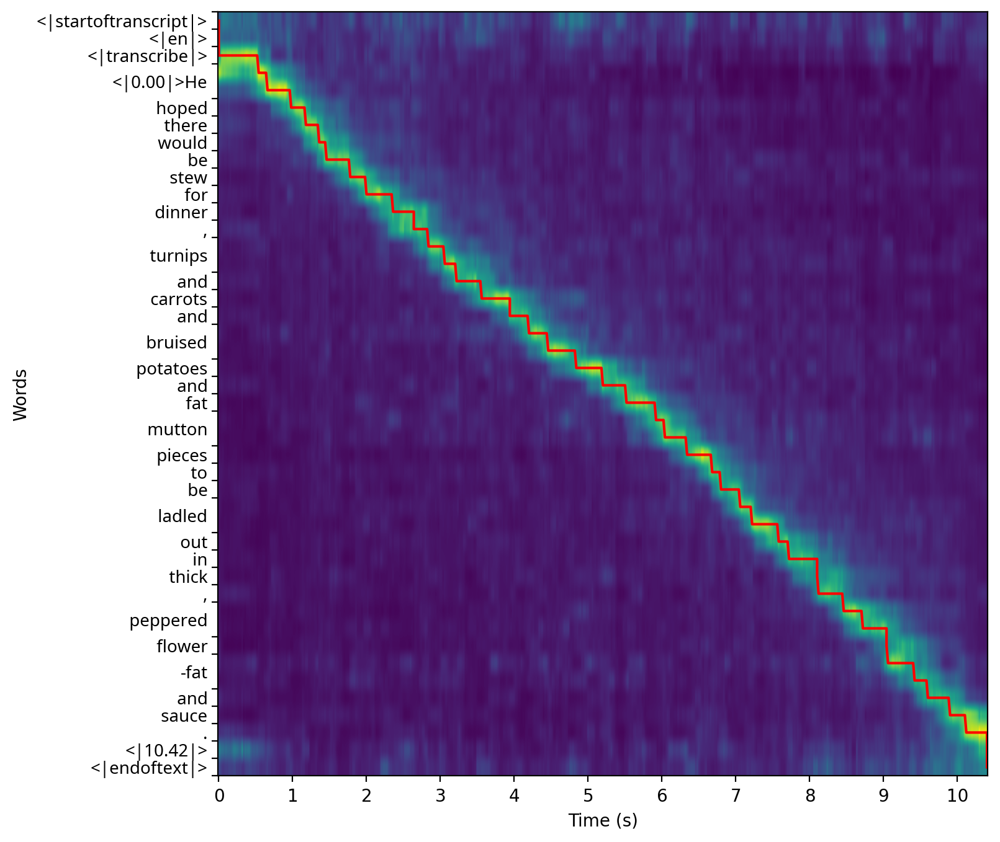

,word,begin,end
0,hoped,0.98,1.18
1,there,1.18,1.36
2,would,1.36,1.46
3,be,1.46,1.78
4,stew,1.78,2.00
5,for,2.00,2.36
6,dinner,2.36,2.64
7,turnips,2.84,3.22
8,and,3.22,3.56
9,carrots,3.56,3.94


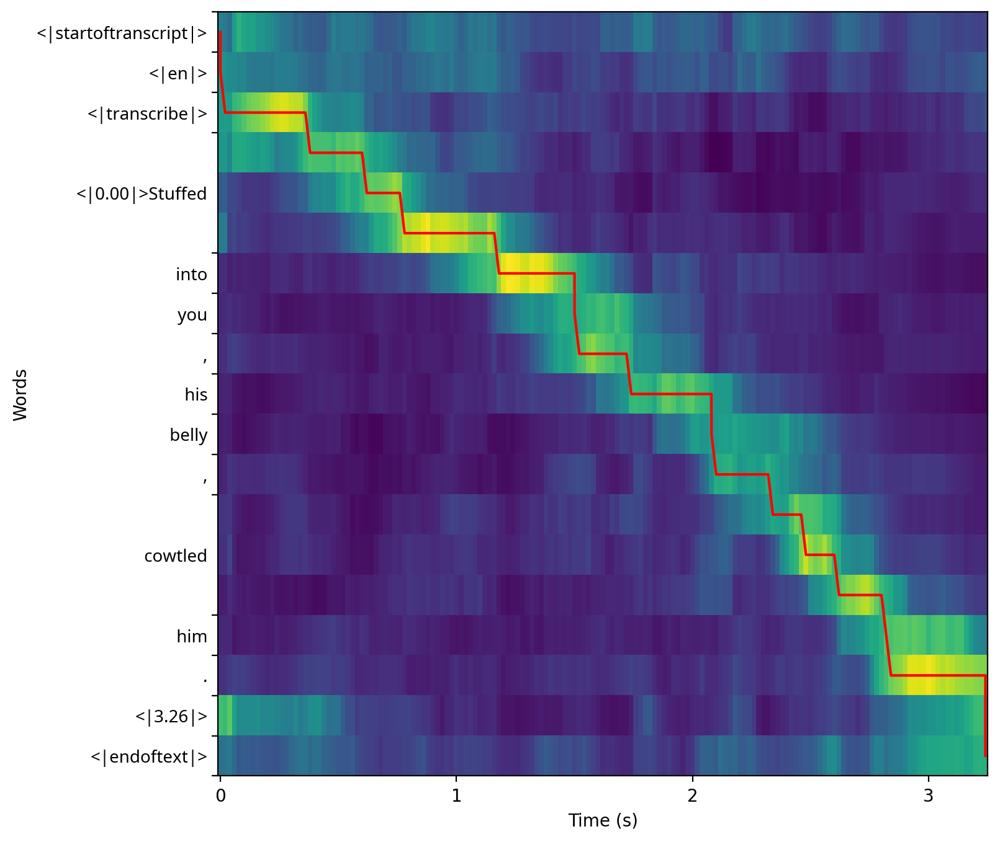

,word,begin,end
0,into,1.18,1.50
1,you,1.50,1.52
2,his,1.74,2.08
3,belly,2.08,2.10
4,cowtled,2.34,2.82
5,him,2.82,2.84


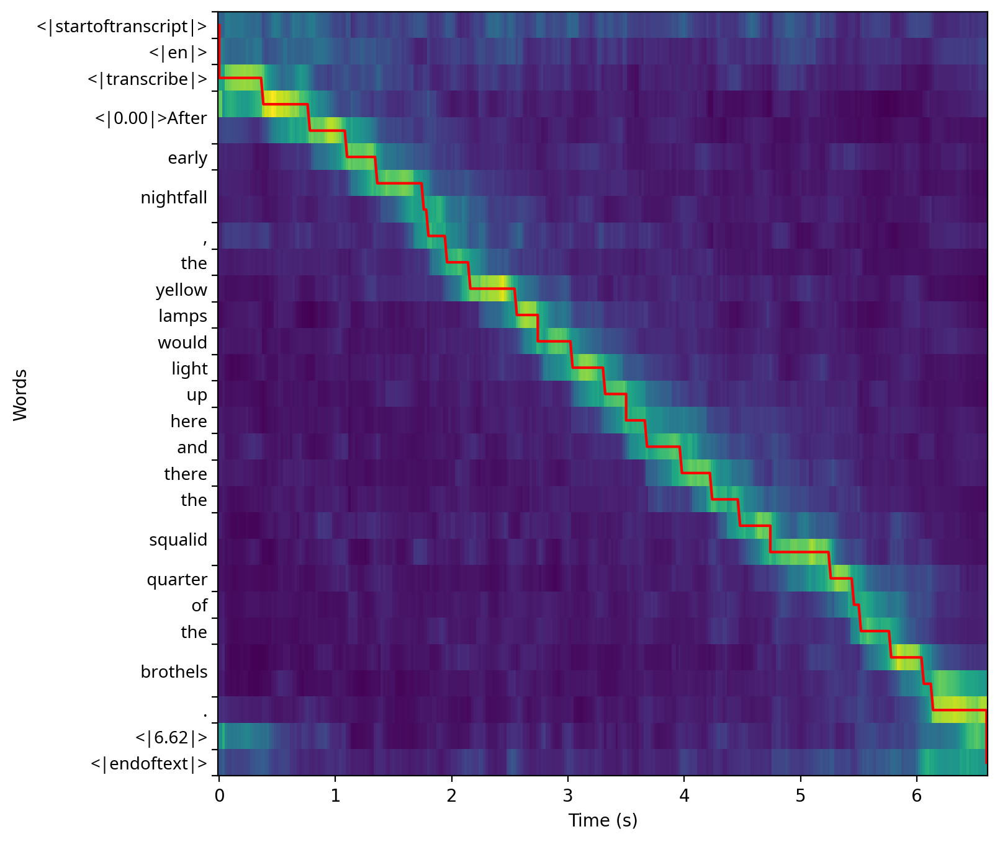

,word,begin,end
0,early,1.10,1.36
1,nightfall,1.36,1.80
2,the,1.96,2.16
3,yellow,2.16,2.56
4,lamps,2.56,2.74
5,would,2.74,3.04
6,light,3.04,3.32
7,up,3.32,3.50
8,here,3.50,3.68
9,and,3.68,3.98


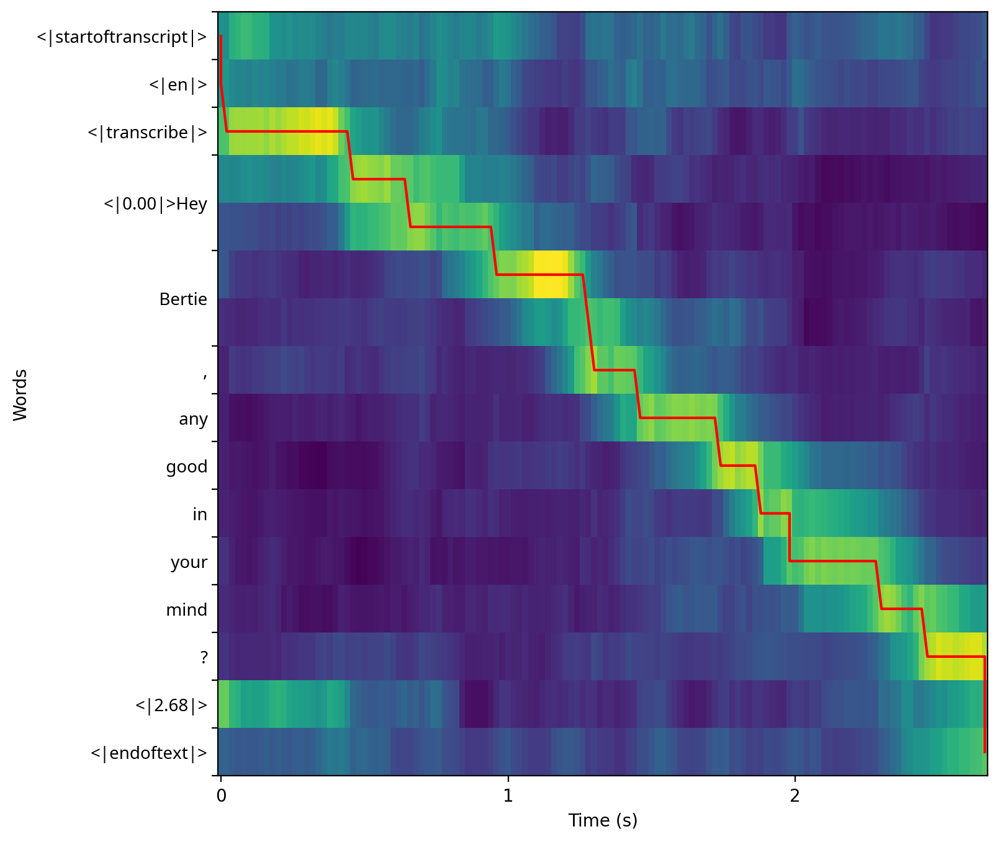

,word,begin,end
0,Bertie,0.96,1.30
1,any,1.46,1.74
2,good,1.74,1.88
3,in,1.88,1.98
4,your,1.98,2.30
5,mind,2.30,2.46


In [52]:
import numpy as np

perturbation_len = model.dims.n_audio_ctx
# for the  2 examples in the dataset
for mel, target_text,duration in tqdm(loader):
    decoded = model.decode(mel)
    transcription =decoded.text
  
    # mel = whisper.log_mel_spectrogram(whisper.pad_or_trim(audio)).cuda()
    tokens = torch.tensor(
        [
            *tokenizer.sot_sequence,
            tokenizer.timestamp_begin,
        ] + tokenizer.encode(transcription) + [
            tokenizer.timestamp_begin + duration // AUDIO_SAMPLES_PER_TOKEN,
            tokenizer.eot,
        ]
    )

    with torch.no_grad():
        logits = model(mel.unsqueeze(0).cuda(), tokens.unsqueeze(0).cuda())
        # torch.cuda.empty_cache()  # Clear GPU cache


    weights = torch.cat(QKs)  # layers * heads * tokens * frames    
    
  
    weights = weights[:, :, :, : duration // AUDIO_SAMPLES_PER_TOKEN].cpu().numpy()
  
    weights = median_filter(weights, (1, 1, 1, medfilt_width))
    
    weights = torch.tensor(weights * qk_scale).softmax(dim=-1)
    
    w = weights / weights.norm(dim=-2, keepdim=True)
 
    matrix = w[-6:].mean(axis=(0, 1))

    alignment = dtw(-matrix.double().numpy())

    jumps = np.pad(np.diff(alignment.index1s), (1, 0), constant_values=1).astype(bool)
    jump_times = alignment.index2s[jumps] * AUDIO_TIME_PER_TOKEN
    words, word_tokens = split_tokens(tokens)

    # display the normalized attention weights and the alignment
    plt.figure(figsize=(8, 8))
    plt.imshow(matrix, aspect="auto")
    plt.plot(alignment.index2s, alignment.index1s, color="red")

    xticks = np.arange(0, matrix.shape[1], 1 / AUDIO_TIME_PER_TOKEN)
    xticklabels = (xticks * AUDIO_TIME_PER_TOKEN).round().astype(np.int32) 
    plt.xticks(xticks, xticklabels)
    plt.xlabel("Time (s)")
    
    # display tokens and words as tick labels
    ylims = plt.gca().get_ylim()

    ax = plt.gca()
    ax.tick_params('both', length=0, width=0, which='minor', pad=6)

    ax.yaxis.set_ticks_position("left")
    ax.yaxis.set_label_position("left")
    ax.invert_yaxis()
    ax.set_ylim(ylims)

    major_ticks = [-0.5]
    minor_ticks = []
    current_y = 0
    
    for word, word_token in zip(words, word_tokens):
        minor_ticks.append(current_y + len(word_token) / 2 - 0.5)
        current_y += len(word_token)
        major_ticks.append(current_y - 0.5)
        
    ax.yaxis.set_minor_locator(ticker.FixedLocator(minor_ticks))
    ax.yaxis.set_minor_formatter(ticker.FixedFormatter(words))
    ax.set_yticks(major_ticks)
    ax.yaxis.set_major_formatter(ticker.NullFormatter())
    
    for label in ax.get_yminorticklabels():
        label.set_fontproperties(prop)

    plt.ylabel("Words")
    plt.show()

    # display the word-level timestamps in a table
    word_boundaries = np.pad(np.cumsum([len(t) for t in word_tokens[:-1]]), (1, 0))
    begin_times = jump_times[word_boundaries[:-1]]
    end_times = jump_times[word_boundaries[1:]]

    data = [
        dict(word=word, begin=begin, end=end)
        for word, begin, end in zip(words[:-1], begin_times, end_times)
        if not word.startswith("<|") and word.strip() not in ".,!?、。"
    ]

    display(pd.DataFrame(data))
    display(HTML("<hr>"))

  0%|          | 0/4 [00:00<?, ?it/s]


Baseline transcription: He hoped there would be stew for dinner, turnips and carrots and bruised potatoes and fat mutton pieces to be ladled out in thick, peppered flower-fat and sauce.

Testing suppression factor 0.3 with sequence length 5


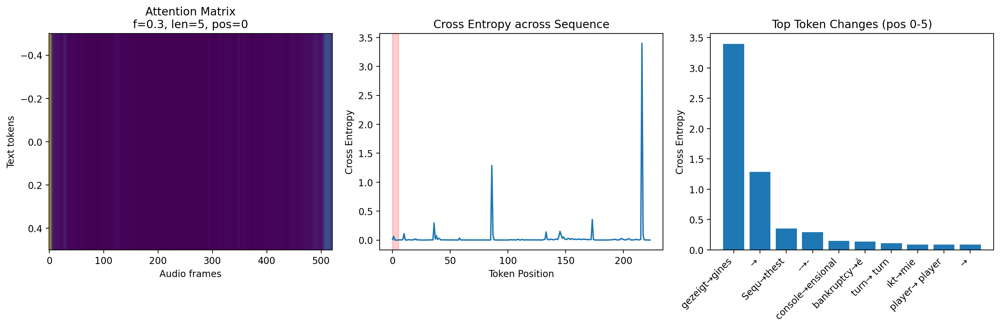


Significant changes detected at position 0:
Position 216:  gezeigt → gines
  Baseline prob: 0.062
  Perturbed prob: 0.035
  Cross Entropy: 3.398
Position 86:  → 
  Baseline prob: 0.193
  Perturbed prob: 0.009
  Cross Entropy: 1.287
Position 173:  Sequ → thest
  Baseline prob: 0.007
  Perturbed prob: 0.006
  Cross Entropy: 0.355
Position 36: - → -
  Baseline prob: 0.474
  Perturbed prob: 0.461
  Cross Entropy: 0.294
Position 145:  console → ensional
  Baseline prob: 0.007
  Perturbed prob: 0.011
  Cross Entropy: 0.151
Position 133:  bankruptcy → ẻ
  Baseline prob: 0.013
  Perturbed prob: 0.011
  Cross Entropy: 0.139
Position 10:  turn →  turn
  Baseline prob: 0.877
  Perturbed prob: 0.711
  Cross Entropy: 0.112


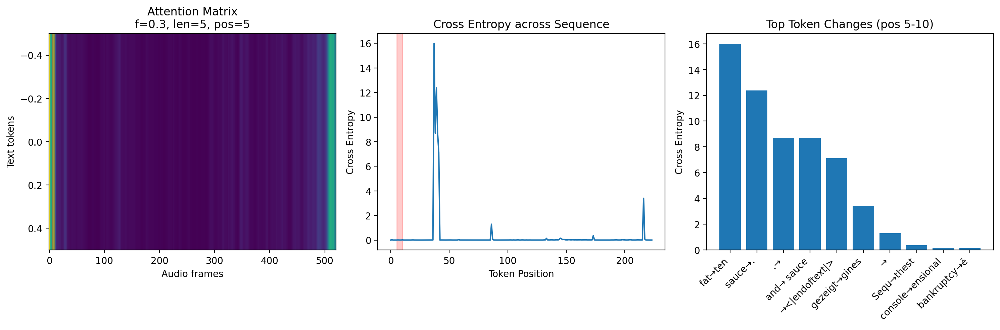


Significant changes detected at position 5:
Position 37: fat → ten
  Baseline prob: 0.884
  Perturbed prob: 0.562
  Cross Entropy: 16.001
Position 39:  sauce → .
  Baseline prob: 0.906
  Perturbed prob: 0.858
  Cross Entropy: 12.379
Position 40: . → 
  Baseline prob: 0.890
  Perturbed prob: 0.059
  Cross Entropy: 8.718
Position 38:  and →  sauce
  Baseline prob: 0.305
  Perturbed prob: 0.812
  Cross Entropy: 8.696
Position 41:  → <|endoftext|>
  Baseline prob: 0.064
  Perturbed prob: 0.994
  Cross Entropy: 7.127
Position 216:  gezeigt → gines
  Baseline prob: 0.062
  Perturbed prob: 0.035
  Cross Entropy: 3.398
Position 86:  → 
  Baseline prob: 0.193
  Perturbed prob: 0.009
  Cross Entropy: 1.287
Position 173:  Sequ → thest
  Baseline prob: 0.007
  Perturbed prob: 0.006
  Cross Entropy: 0.355
Position 145:  console → ensional
  Baseline prob: 0.007
  Perturbed prob: 0.011
  Cross Entropy: 0.151
Position 133:  bankruptcy → ẻ
  Baseline prob: 0.013
  Perturbed prob: 0.011
  Cross Entrop

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


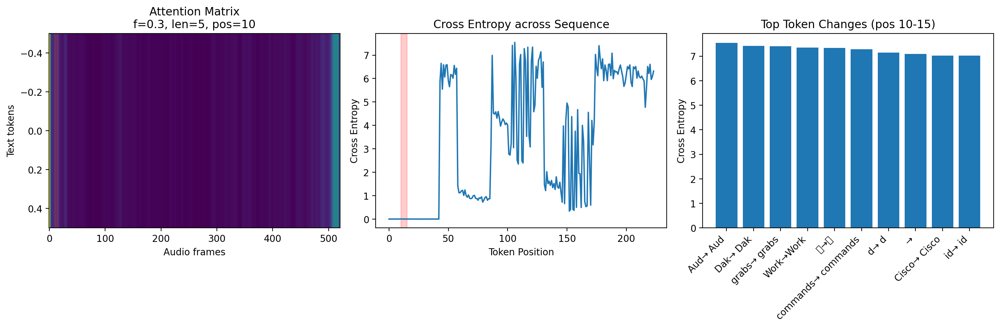


Significant changes detected at position 10:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7.

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


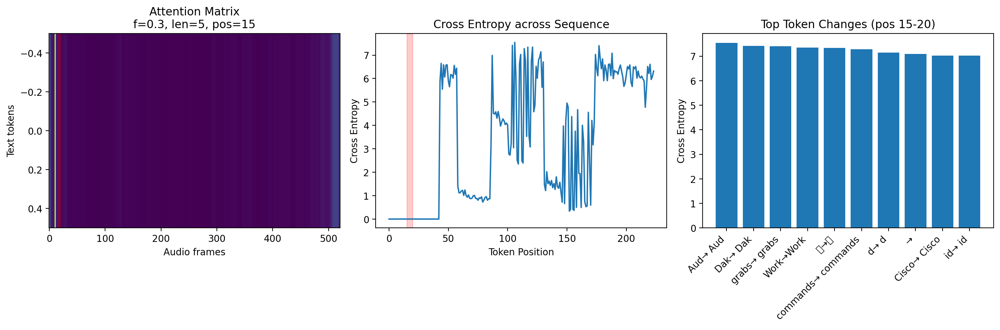


Significant changes detected at position 15:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7.

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


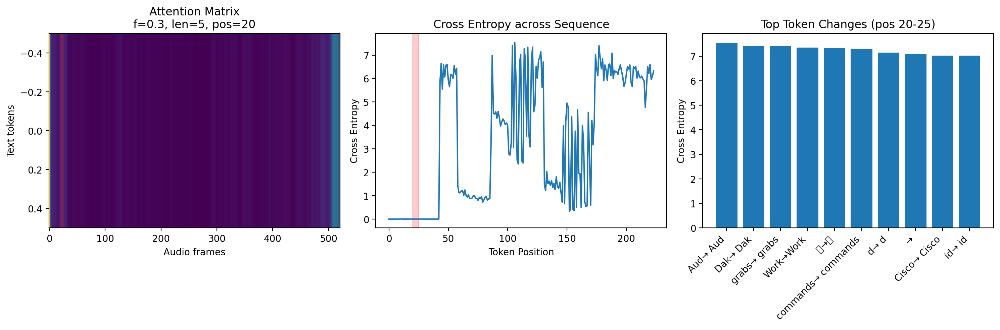


Significant changes detected at position 20:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7.

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


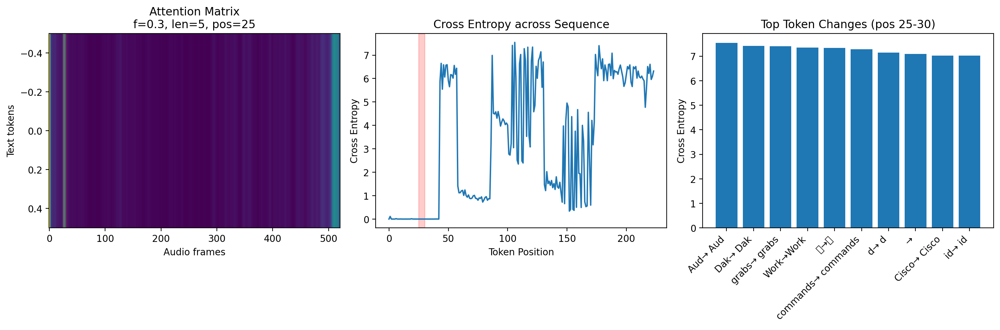


Significant changes detected at position 25:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7.

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


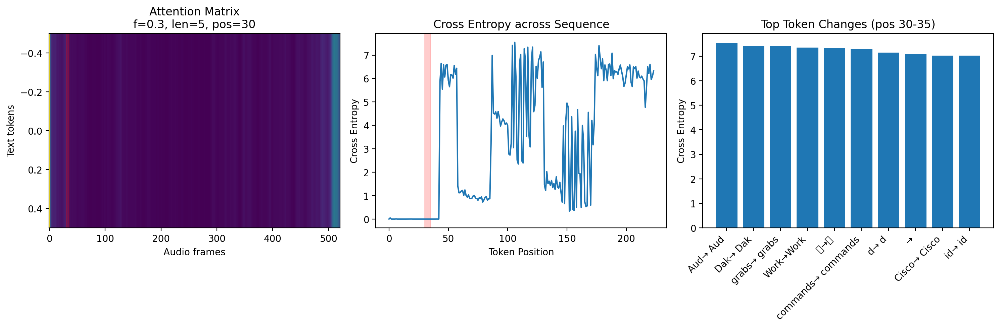


Significant changes detected at position 30:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7.

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


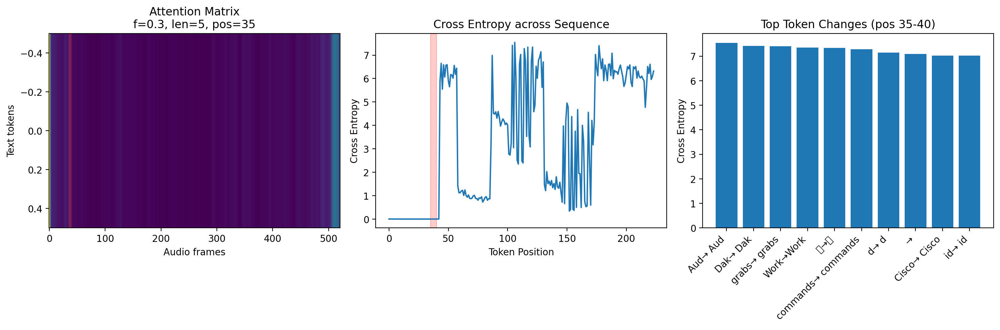


Significant changes detected at position 35:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7.

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


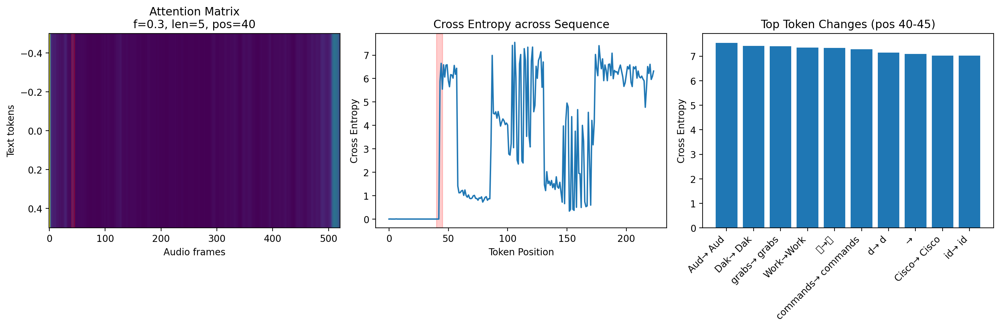


Significant changes detected at position 40:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7.

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


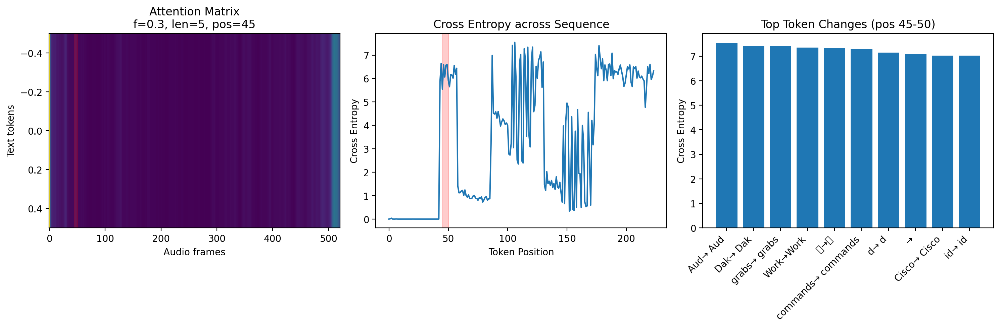


Significant changes detected at position 45:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7.

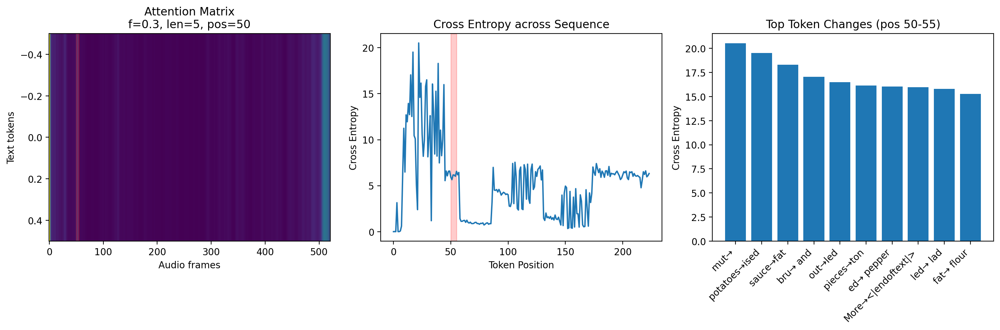


Significant changes detected at position 50:
Position 22:  mut → 
  Baseline prob: 0.904
  Perturbed prob: 0.995
  Cross Entropy: 20.519
Position 17:  potatoes → ised
  Baseline prob: 0.890
  Perturbed prob: 0.997
  Cross Entropy: 19.525
Position 39:  sauce → fat
  Baseline prob: 0.906
  Perturbed prob: 0.918
  Cross Entropy: 18.293
Position 15:  bru →  and
  Baseline prob: 0.929
  Perturbed prob: 0.657
  Cross Entropy: 17.048
Position 29:  out → led
  Baseline prob: 0.995
  Perturbed prob: 0.928
  Cross Entropy: 16.510
Position 24:  pieces → ton
  Baseline prob: 0.908
  Perturbed prob: 0.981
  Cross Entropy: 16.155
Position 34: ed →  pepper
  Baseline prob: 0.990
  Perturbed prob: 0.652
  Cross Entropy: 16.057
Position 44: More → <|endoftext|>
  Baseline prob: 0.132
  Perturbed prob: 0.996
  Cross Entropy: 15.989
Position 28: led →  lad
  Baseline prob: 0.929
  Perturbed prob: 0.912
  Cross Entropy: 15.789
Position 37: fat →  flour
  Baseline prob: 0.884
  Perturbed prob: 0.564
  Cro

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


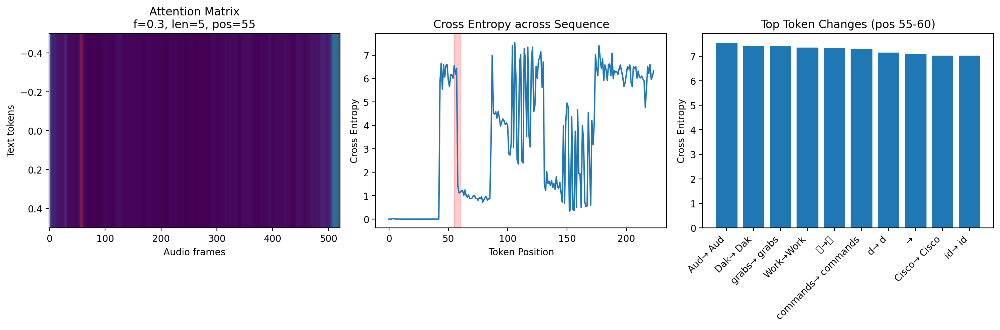


Significant changes detected at position 55:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7.

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


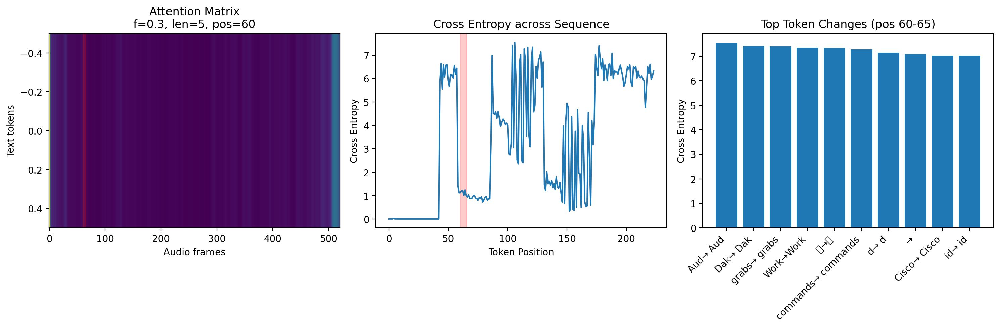


Significant changes detected at position 60:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7.

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


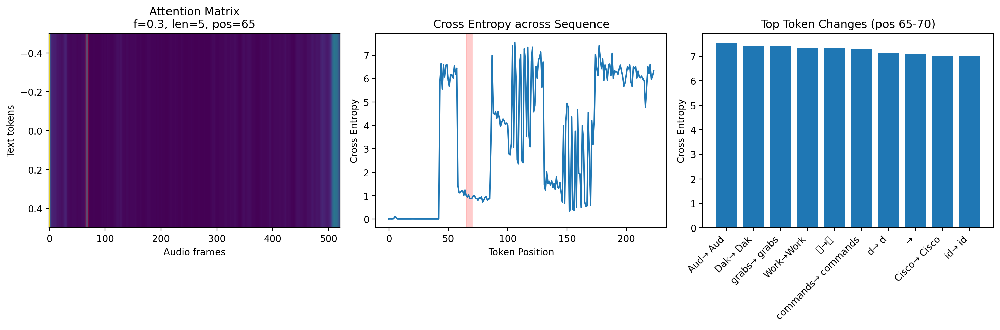


Significant changes detected at position 65:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7.

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


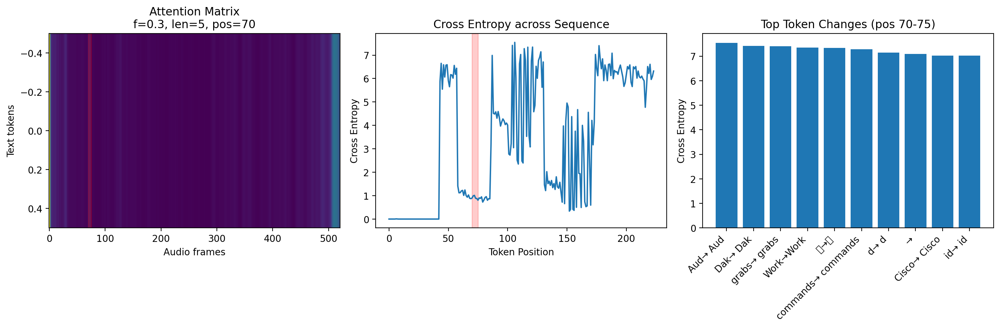


Significant changes detected at position 70:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7.

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


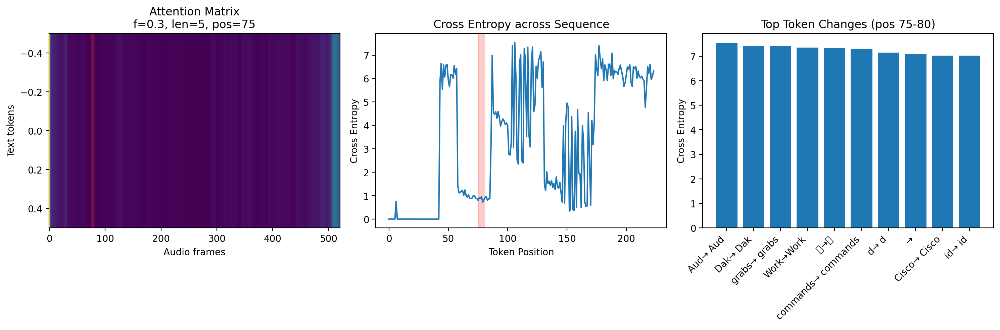


Significant changes detected at position 75:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7.

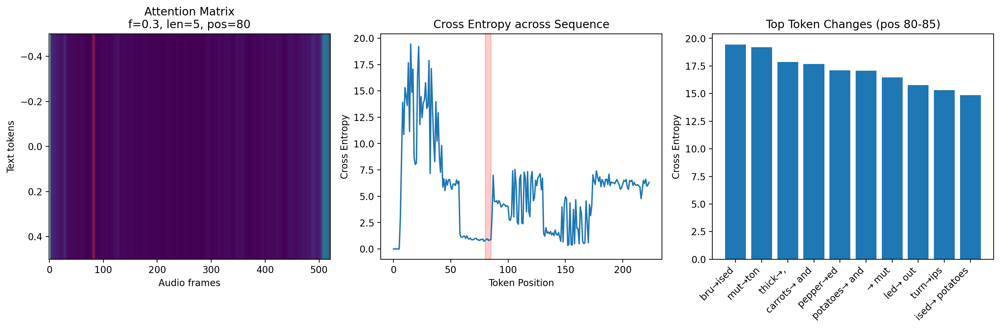


Significant changes detected at position 80:
Position 15:  bru → ised
  Baseline prob: 0.929
  Perturbed prob: 0.997
  Cross Entropy: 19.442
Position 22:  mut → ton
  Baseline prob: 0.904
  Perturbed prob: 0.975
  Cross Entropy: 19.208
Position 31:  thick → ,
  Baseline prob: 0.994
  Perturbed prob: 0.599
  Cross Entropy: 17.874
Position 13:  carrots →  and
  Baseline prob: 0.960
  Perturbed prob: 0.671
  Cross Entropy: 17.666
Position 33:  pepper → ed
  Baseline prob: 0.657
  Perturbed prob: 0.990
  Cross Entropy: 17.112
Position 17:  potatoes →  and
  Baseline prob: 0.890
  Perturbed prob: 0.757
  Cross Entropy: 17.065
Position 21:  →  mut
  Baseline prob: 0.993
  Perturbed prob: 0.894
  Cross Entropy: 16.459
Position 28: led →  out
  Baseline prob: 0.929
  Perturbed prob: 0.995
  Cross Entropy: 15.774
Position 10:  turn → ips
  Baseline prob: 0.877
  Perturbed prob: 0.879
  Cross Entropy: 15.302
Position 16: ised →  potatoes
  Baseline prob: 0.997
  Perturbed prob: 0.895
  Cross En

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


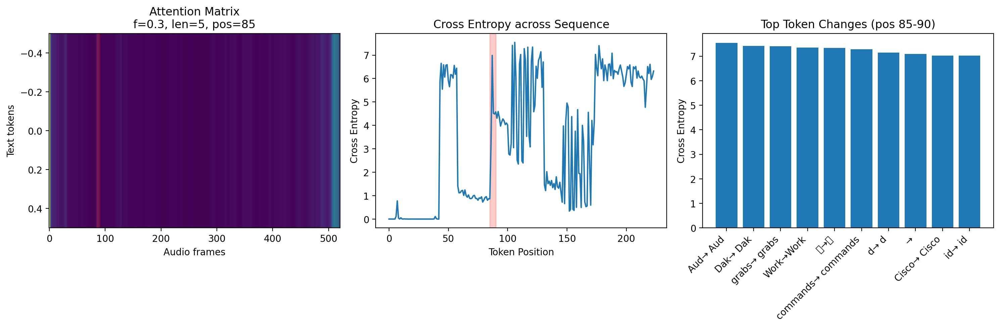


Significant changes detected at position 85:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7.

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


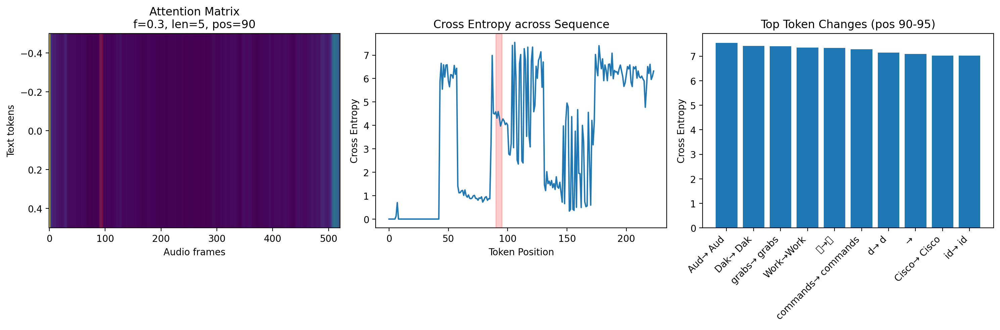


Significant changes detected at position 90:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7.

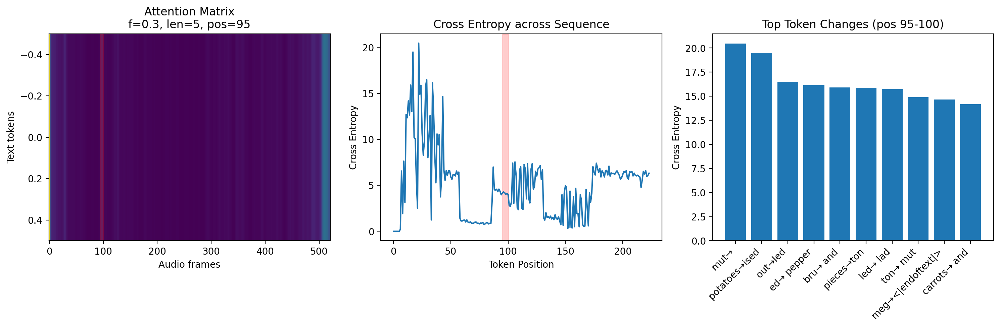


Significant changes detected at position 95:
Position 22:  mut → 
  Baseline prob: 0.904
  Perturbed prob: 0.995
  Cross Entropy: 20.460
Position 17:  potatoes → ised
  Baseline prob: 0.890
  Perturbed prob: 0.997
  Cross Entropy: 19.494
Position 29:  out → led
  Baseline prob: 0.995
  Perturbed prob: 0.930
  Cross Entropy: 16.487
Position 34: ed →  pepper
  Baseline prob: 0.990
  Perturbed prob: 0.651
  Cross Entropy: 16.149
Position 15:  bru →  and
  Baseline prob: 0.929
  Perturbed prob: 0.755
  Cross Entropy: 15.904
Position 24:  pieces → ton
  Baseline prob: 0.908
  Perturbed prob: 0.977
  Cross Entropy: 15.879
Position 28: led →  lad
  Baseline prob: 0.929
  Perturbed prob: 0.916
  Cross Entropy: 15.739
Position 23: ton →  mut
  Baseline prob: 0.979
  Perturbed prob: 0.910
  Cross Entropy: 14.912
Position 43:  meg → <|endoftext|>
  Baseline prob: 0.018
  Perturbed prob: 0.995
  Cross Entropy: 14.665
Position 13:  carrots →  and
  Baseline prob: 0.960
  Perturbed prob: 0.925
  Cr

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


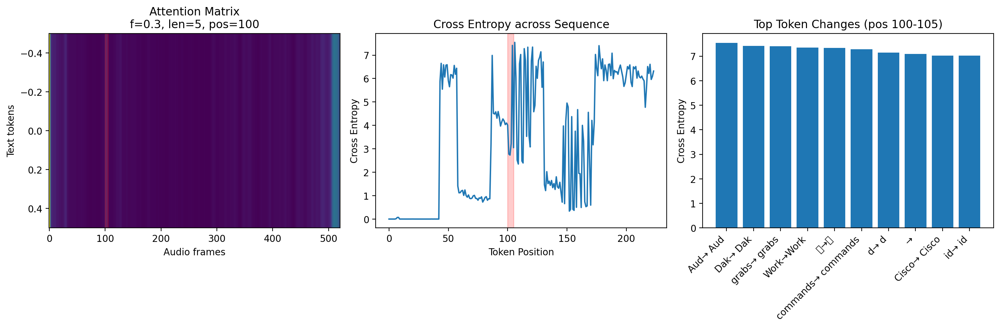


Significant changes detected at position 100:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


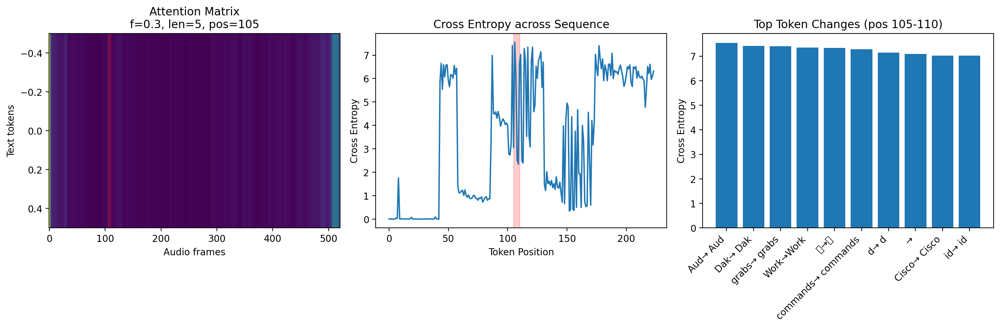


Significant changes detected at position 105:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


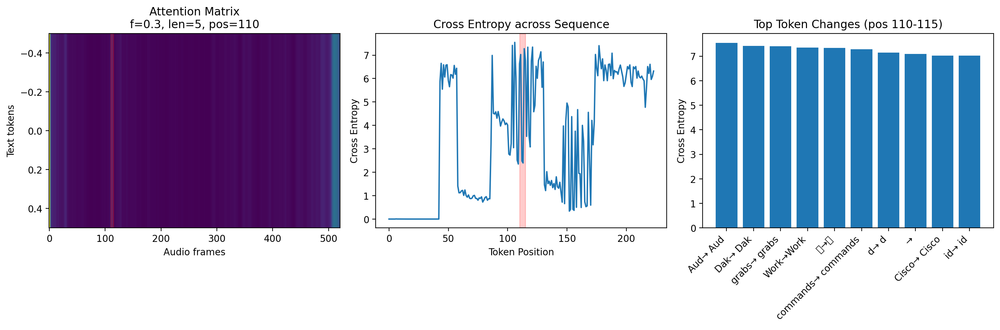


Significant changes detected at position 110:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


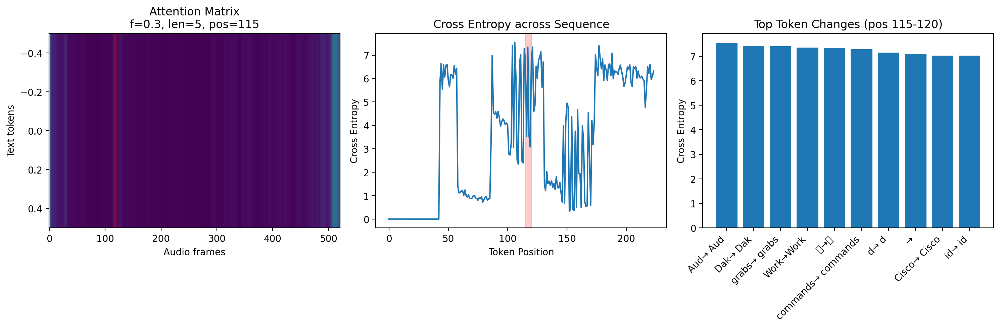


Significant changes detected at position 115:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


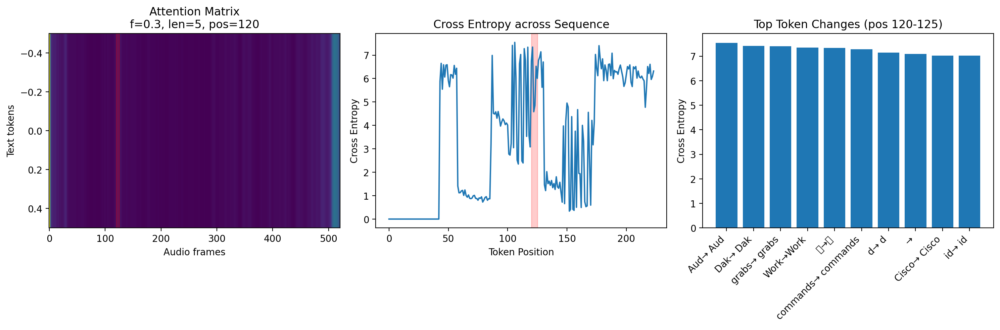


Significant changes detected at position 120:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


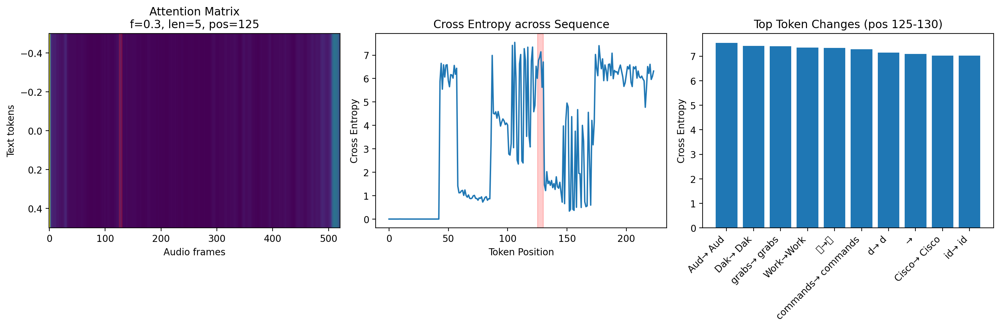


Significant changes detected at position 125:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

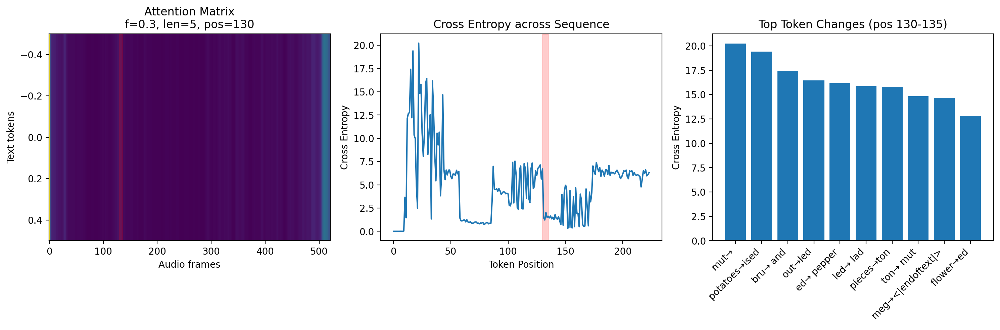


Significant changes detected at position 130:
Position 22:  mut → 
  Baseline prob: 0.904
  Perturbed prob: 0.994
  Cross Entropy: 20.234
Position 17:  potatoes → ised
  Baseline prob: 0.890
  Perturbed prob: 0.997
  Cross Entropy: 19.400
Position 15:  bru →  and
  Baseline prob: 0.929
  Perturbed prob: 0.661
  Cross Entropy: 17.427
Position 29:  out → led
  Baseline prob: 0.995
  Perturbed prob: 0.924
  Cross Entropy: 16.441
Position 34: ed →  pepper
  Baseline prob: 0.990
  Perturbed prob: 0.629
  Cross Entropy: 16.178
Position 28: led →  lad
  Baseline prob: 0.929
  Perturbed prob: 0.913
  Cross Entropy: 15.861
Position 24:  pieces → ton
  Baseline prob: 0.908
  Perturbed prob: 0.975
  Cross Entropy: 15.789
Position 23: ton →  mut
  Baseline prob: 0.979
  Perturbed prob: 0.905
  Cross Entropy: 14.841
Position 43:  meg → <|endoftext|>
  Baseline prob: 0.018
  Perturbed prob: 0.996
  Cross Entropy: 14.680
Position 35:  flower → ed
  Baseline prob: 0.350
  Perturbed prob: 0.982
  Cros

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


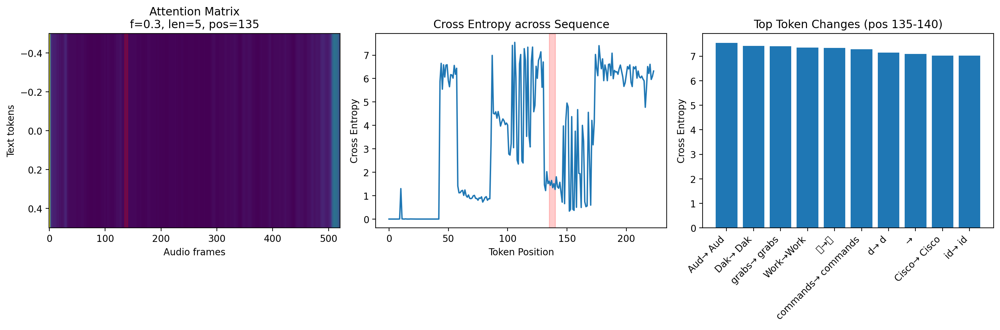


Significant changes detected at position 135:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


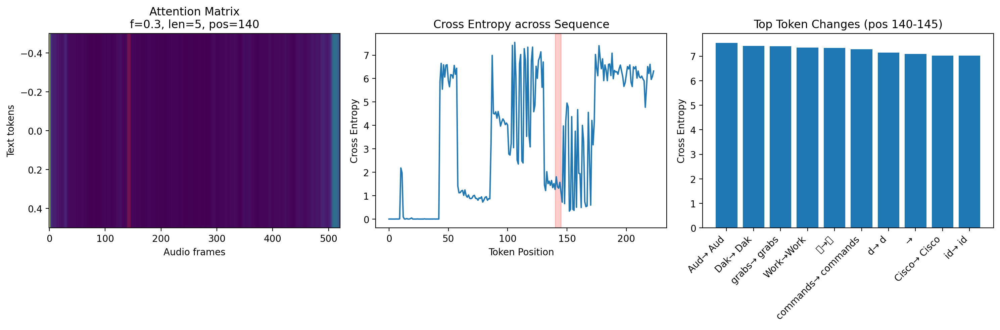


Significant changes detected at position 140:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


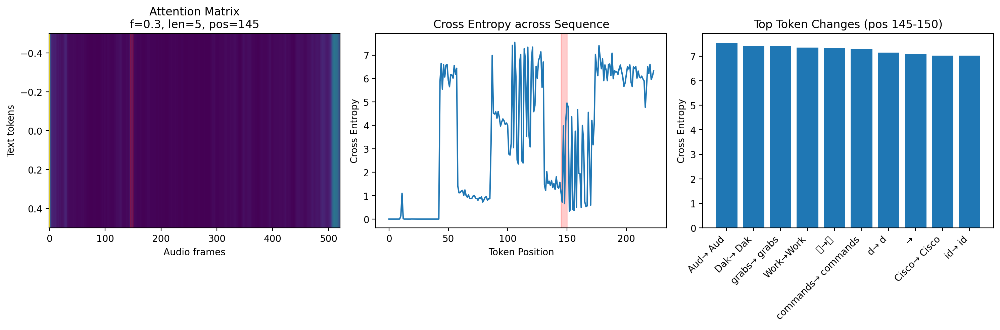


Significant changes detected at position 145:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


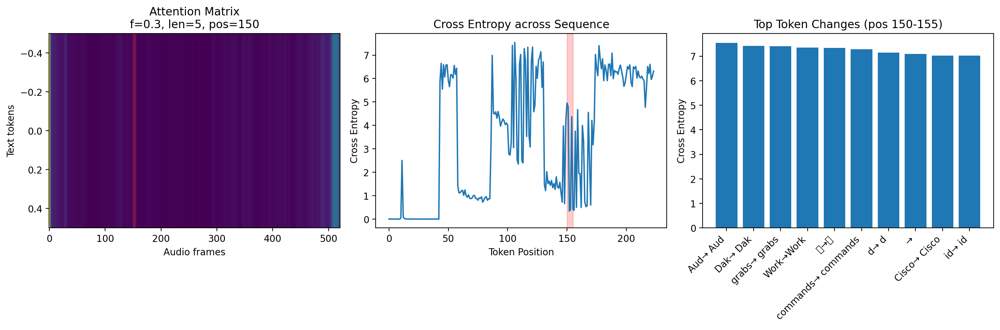


Significant changes detected at position 150:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


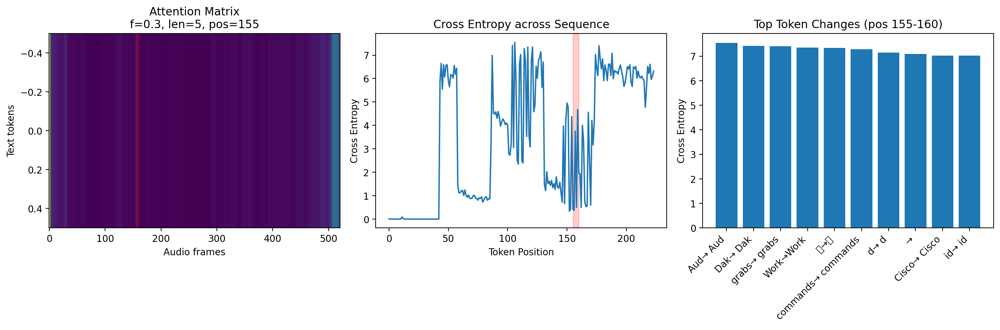


Significant changes detected at position 155:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


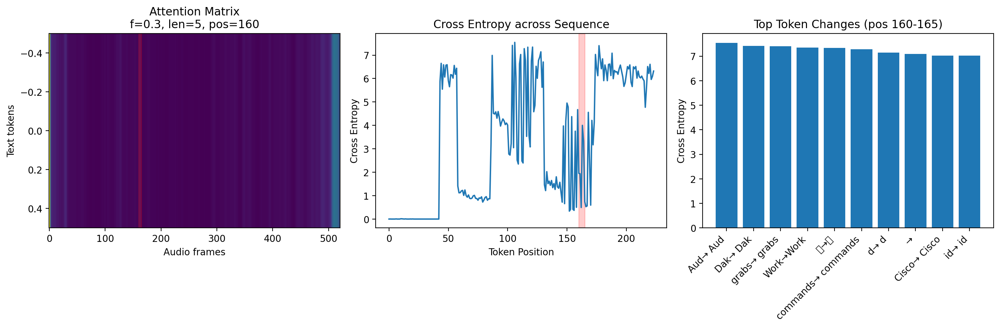


Significant changes detected at position 160:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


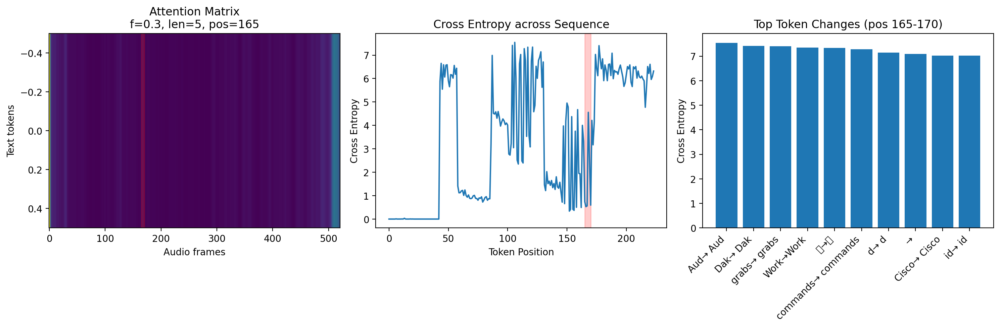


Significant changes detected at position 165:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


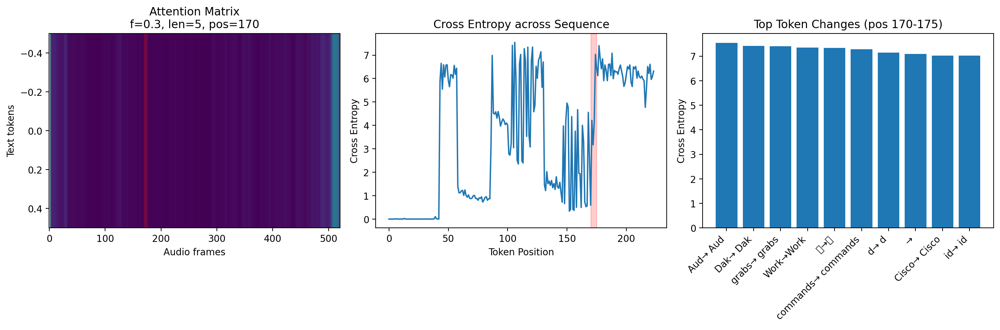


Significant changes detected at position 170:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


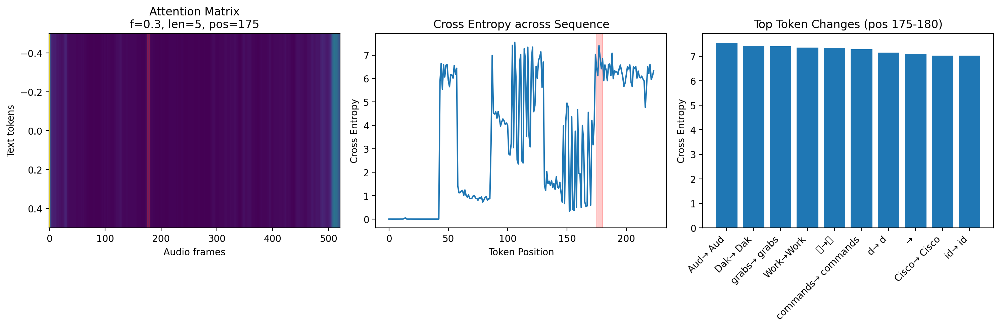


Significant changes detected at position 175:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


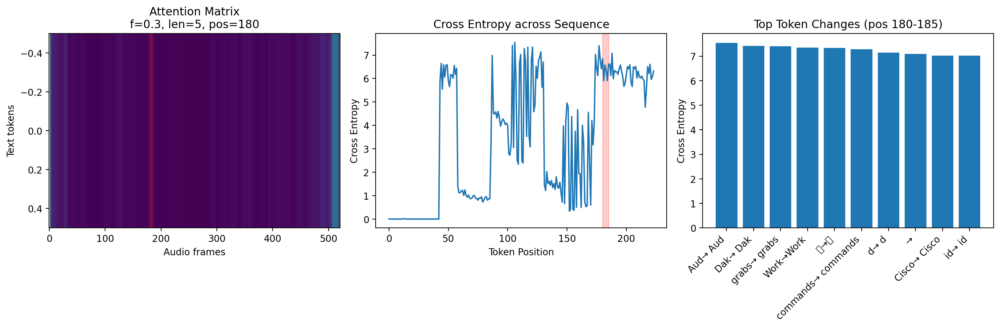


Significant changes detected at position 180:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


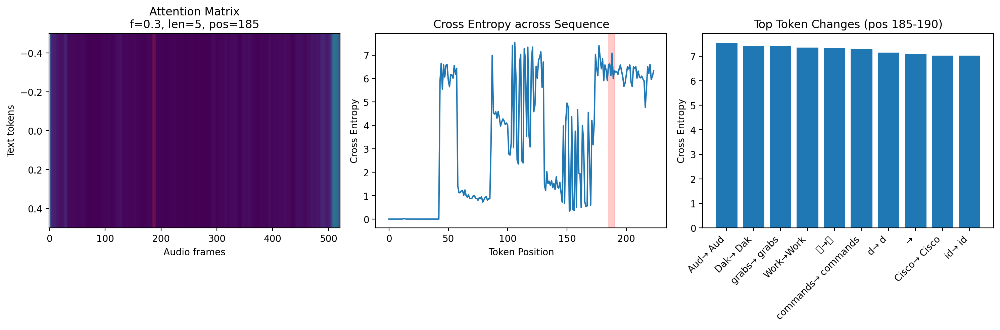


Significant changes detected at position 185:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


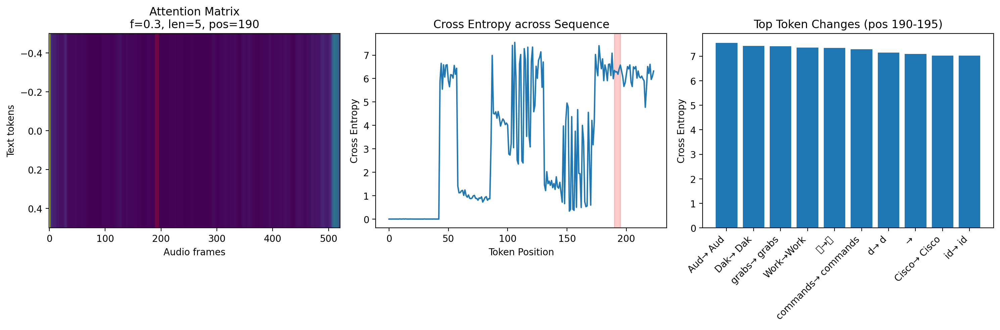


Significant changes detected at position 190:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


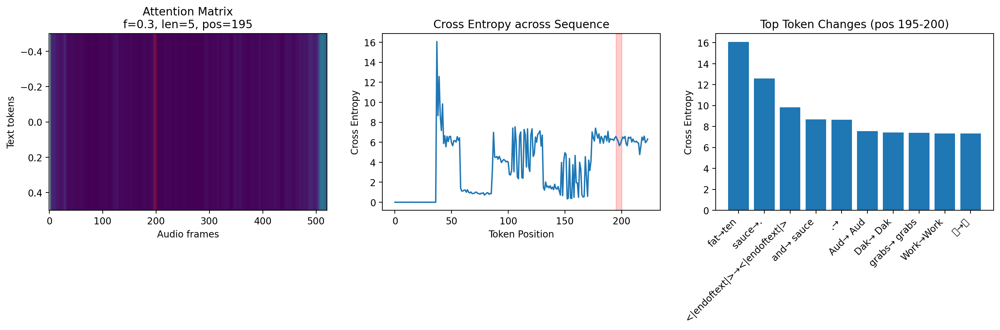


Significant changes detected at position 195:
Position 37: fat → ten
  Baseline prob: 0.884
  Perturbed prob: 0.553
  Cross Entropy: 16.066
Position 39:  sauce → .
  Baseline prob: 0.906
  Perturbed prob: 0.850
  Cross Entropy: 12.566
Position 42: <|endoftext|> → <|endoftext|>
  Baseline prob: 0.996
  Perturbed prob: 0.000
  Cross Entropy: 9.827
Position 38:  and →  sauce
  Baseline prob: 0.305
  Perturbed prob: 0.798
  Cross Entropy: 8.664
Position 40: . → 
  Baseline prob: 0.890
  Perturbed prob: 0.066
  Cross Entropy: 8.653
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Ent

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


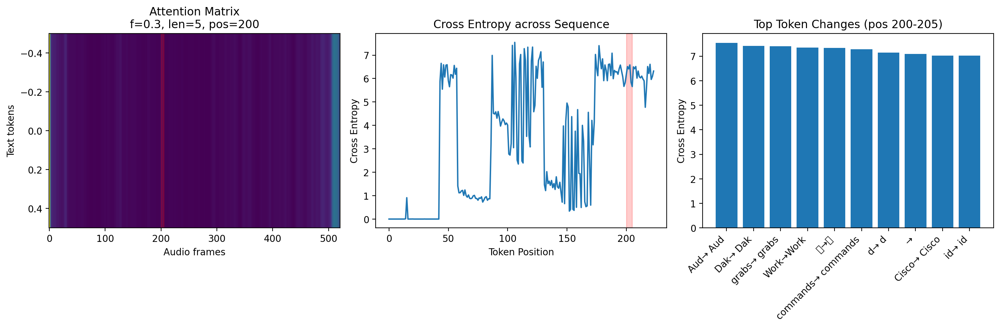


Significant changes detected at position 200:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


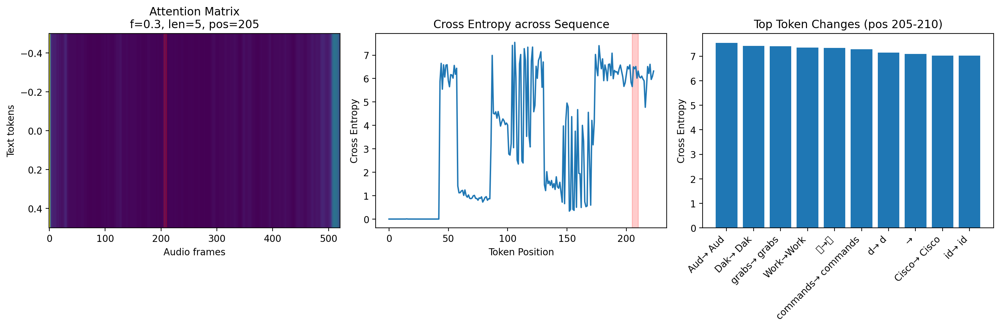


Significant changes detected at position 205:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


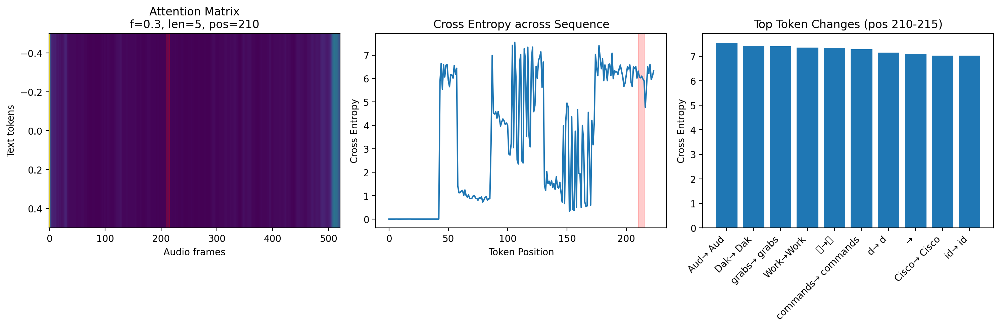


Significant changes detected at position 210:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


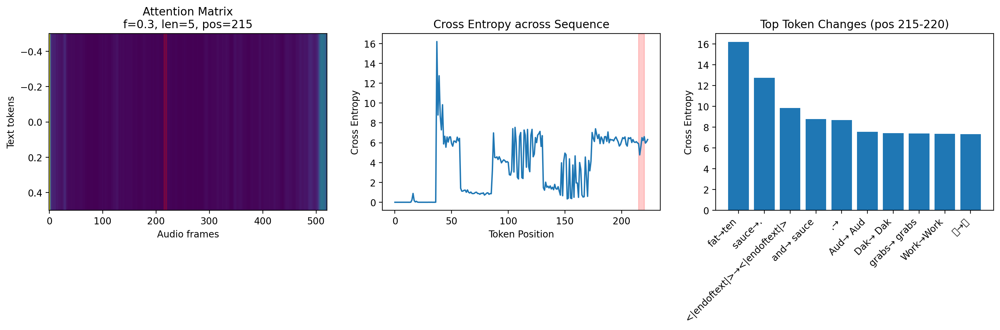


Significant changes detected at position 215:
Position 37: fat → ten
  Baseline prob: 0.884
  Perturbed prob: 0.571
  Cross Entropy: 16.192
Position 39:  sauce → .
  Baseline prob: 0.906
  Perturbed prob: 0.852
  Cross Entropy: 12.745
Position 42: <|endoftext|> → <|endoftext|>
  Baseline prob: 0.996
  Perturbed prob: 0.000
  Cross Entropy: 9.827
Position 38:  and →  sauce
  Baseline prob: 0.305
  Perturbed prob: 0.815
  Cross Entropy: 8.790
Position 40: . → 
  Baseline prob: 0.890
  Perturbed prob: 0.066
  Cross Entropy: 8.679
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Ent

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


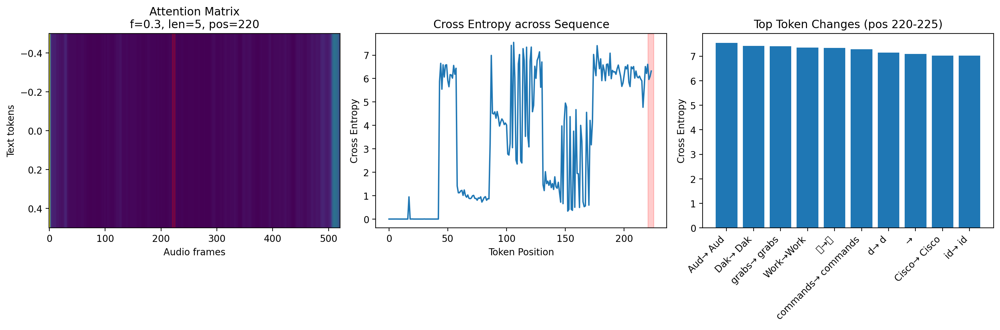


Significant changes detected at position 220:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


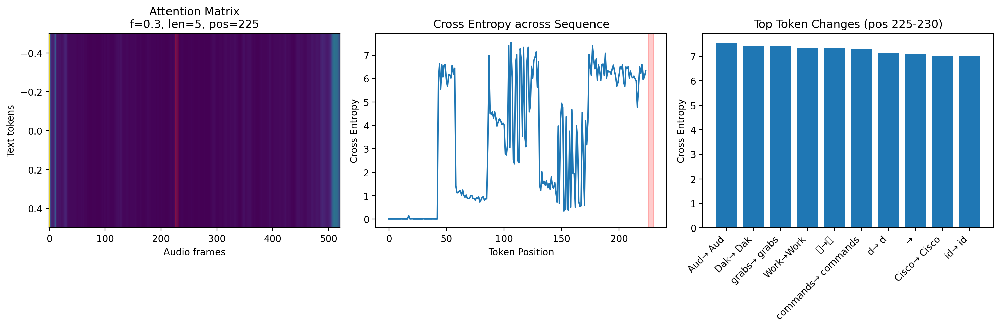


Significant changes detected at position 225:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


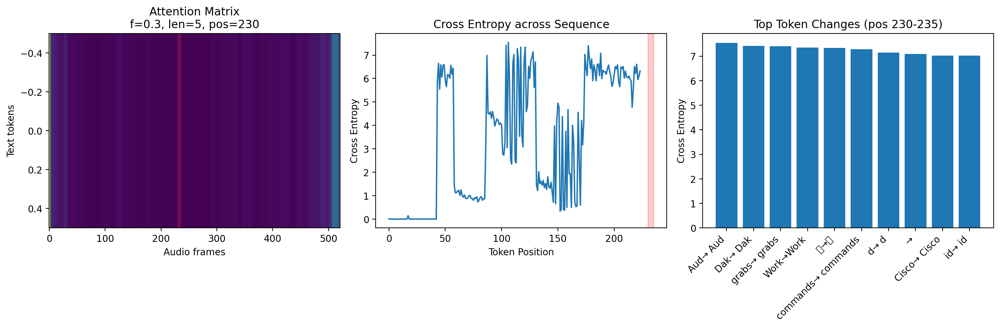


Significant changes detected at position 230:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


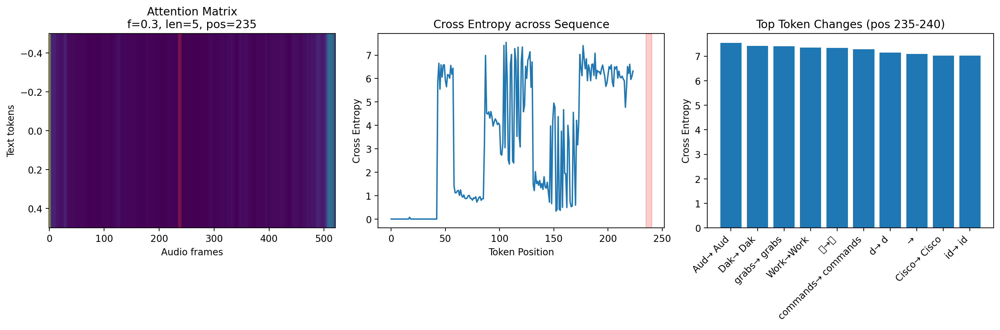


Significant changes detected at position 235:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


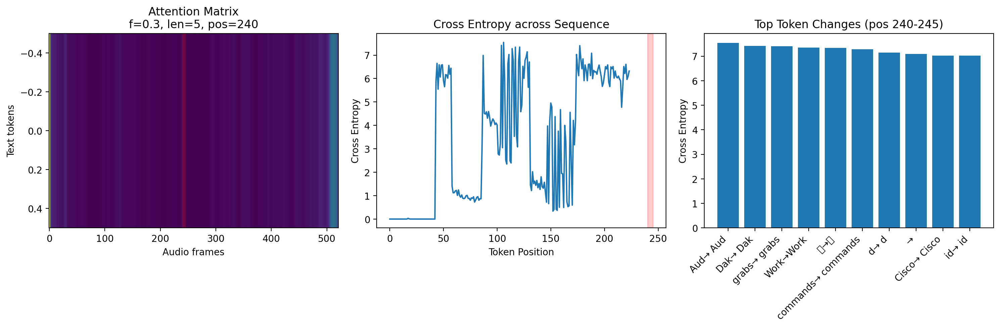


Significant changes detected at position 240:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


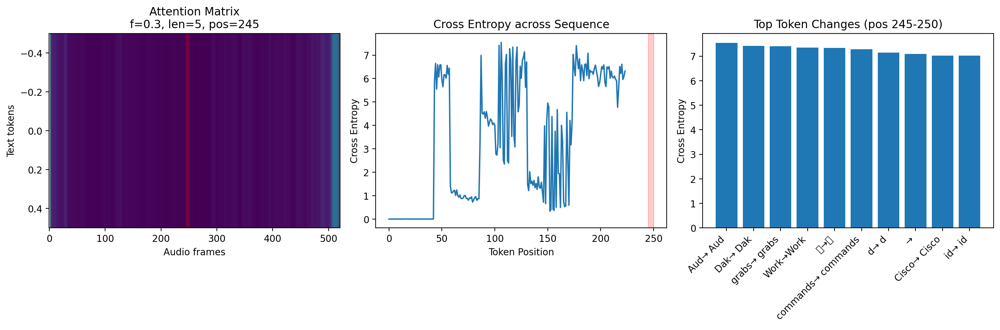


Significant changes detected at position 245:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


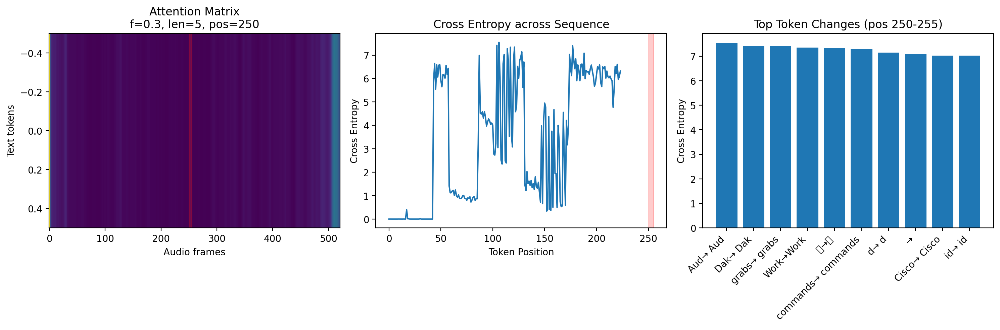


Significant changes detected at position 250:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


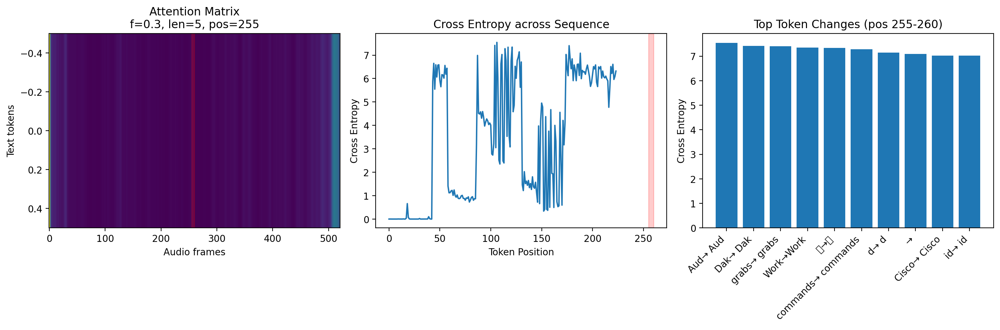


Significant changes detected at position 255:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


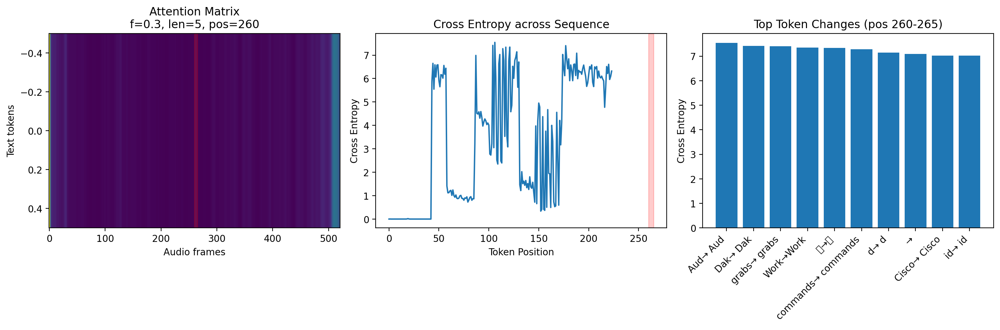


Significant changes detected at position 260:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

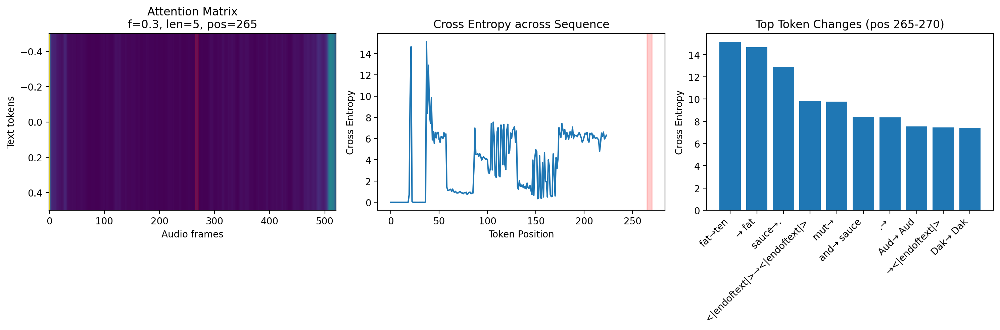


Significant changes detected at position 265:
Position 37: fat → ten
  Baseline prob: 0.884
  Perturbed prob: 0.443
  Cross Entropy: 15.137
Position 21:  →  fat
  Baseline prob: 0.993
  Perturbed prob: 0.805
  Cross Entropy: 14.659
Position 39:  sauce → .
  Baseline prob: 0.906
  Perturbed prob: 0.870
  Cross Entropy: 12.908
Position 42: <|endoftext|> → <|endoftext|>
  Baseline prob: 0.996
  Perturbed prob: 0.000
  Cross Entropy: 9.827
Position 20:  mut → 
  Baseline prob: 0.188
  Perturbed prob: 0.980
  Cross Entropy: 9.774
Position 38:  and →  sauce
  Baseline prob: 0.305
  Perturbed prob: 0.700
  Cross Entropy: 8.403
Position 40: . → 
  Baseline prob: 0.890
  Perturbed prob: 0.061
  Cross Entropy: 8.368
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 41:  → <|endoftext|>
  Baseline prob: 0.064
  Perturbed prob: 0.995
  Cross Entropy: 7.456
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entrop

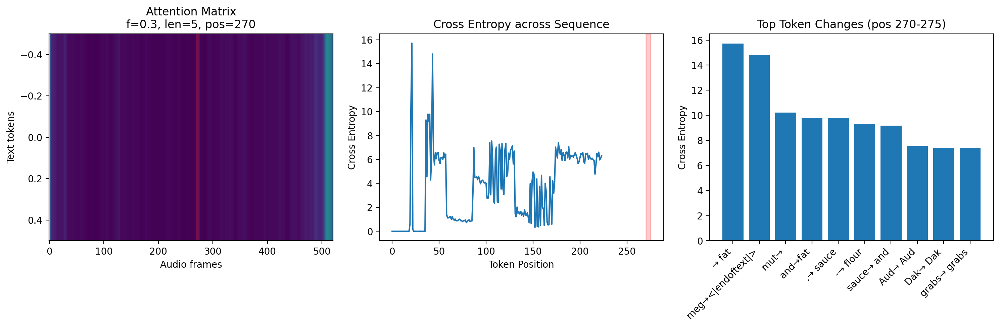


Significant changes detected at position 270:
Position 21:  →  fat
  Baseline prob: 0.993
  Perturbed prob: 0.886
  Cross Entropy: 15.716
Position 43:  meg → <|endoftext|>
  Baseline prob: 0.018
  Perturbed prob: 0.992
  Cross Entropy: 14.810
Position 20:  mut → 
  Baseline prob: 0.188
  Perturbed prob: 0.982
  Cross Entropy: 10.229
Position 38:  and → fat
  Baseline prob: 0.305
  Perturbed prob: 0.907
  Cross Entropy: 9.785
Position 40: . →  sauce
  Baseline prob: 0.890
  Perturbed prob: 0.922
  Cross Entropy: 9.782
Position 36: - →  flour
  Baseline prob: 0.474
  Perturbed prob: 0.560
  Cross Entropy: 9.299
Position 39:  sauce →  and
  Baseline prob: 0.906
  Perturbed prob: 0.432
  Cross Entropy: 9.176
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy:

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


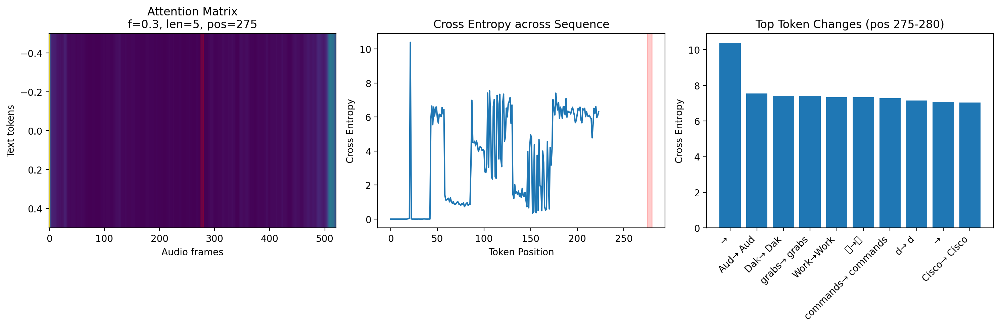


Significant changes detected at position 275:
Position 21:  → 
  Baseline prob: 0.993
  Perturbed prob: 0.994
  Cross Entropy: 10.390
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029


/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


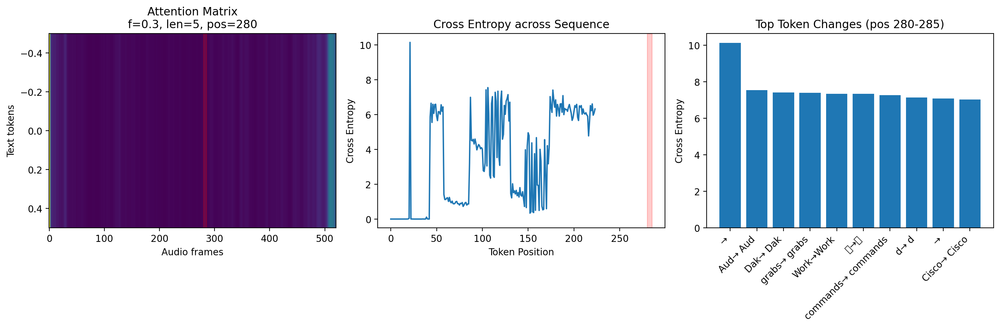


Significant changes detected at position 280:
Position 21:  → 
  Baseline prob: 0.993
  Perturbed prob: 0.993
  Cross Entropy: 10.141
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029


/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


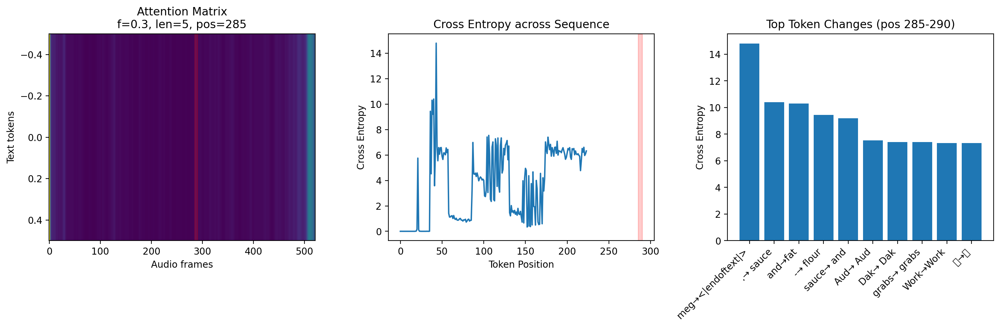


Significant changes detected at position 285:
Position 43:  meg → <|endoftext|>
  Baseline prob: 0.018
  Perturbed prob: 0.993
  Cross Entropy: 14.798
Position 40: . →  sauce
  Baseline prob: 0.890
  Perturbed prob: 0.934
  Cross Entropy: 10.402
Position 38:  and → fat
  Baseline prob: 0.305
  Perturbed prob: 0.929
  Cross Entropy: 10.311
Position 36: - →  flour
  Baseline prob: 0.474
  Perturbed prob: 0.547
  Cross Entropy: 9.440
Position 39:  sauce →  and
  Baseline prob: 0.906
  Perturbed prob: 0.427
  Cross Entropy: 9.203
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entr

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


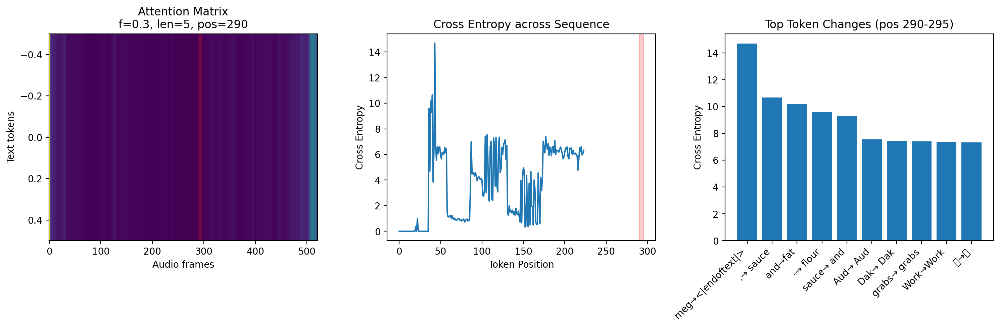


Significant changes detected at position 290:
Position 43:  meg → <|endoftext|>
  Baseline prob: 0.018
  Perturbed prob: 0.992
  Cross Entropy: 14.690
Position 40: . →  sauce
  Baseline prob: 0.890
  Perturbed prob: 0.941
  Cross Entropy: 10.667
Position 38:  and → fat
  Baseline prob: 0.305
  Perturbed prob: 0.922
  Cross Entropy: 10.173
Position 36: - →  flour
  Baseline prob: 0.474
  Perturbed prob: 0.557
  Cross Entropy: 9.602
Position 39:  sauce →  and
  Baseline prob: 0.906
  Perturbed prob: 0.425
  Cross Entropy: 9.269
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entr

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


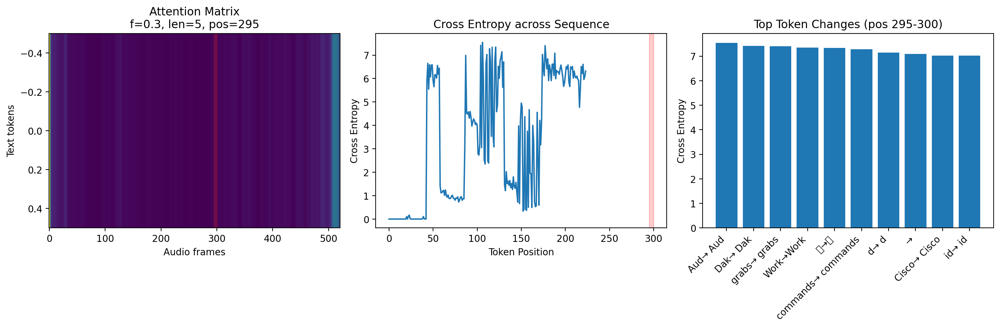


Significant changes detected at position 295:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


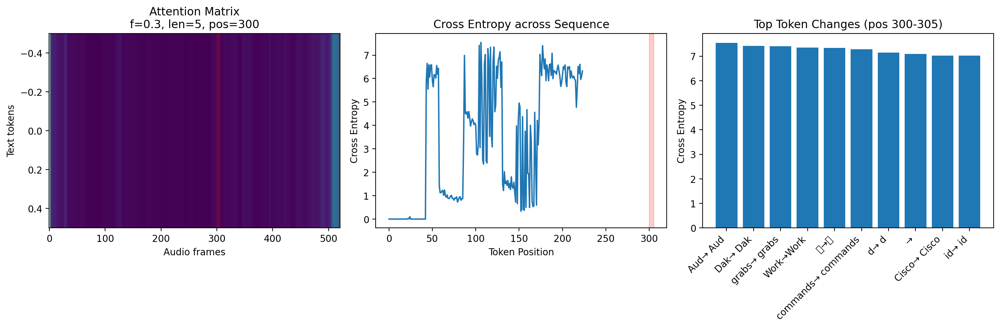


Significant changes detected at position 300:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

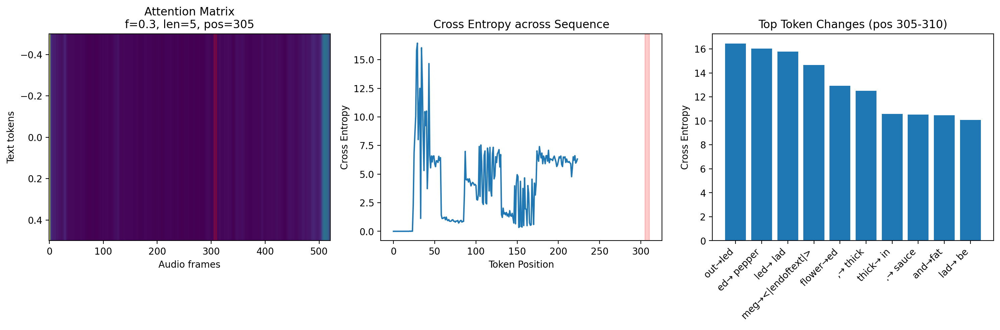


Significant changes detected at position 305:
Position 29:  out → led
  Baseline prob: 0.995
  Perturbed prob: 0.926
  Cross Entropy: 16.448
Position 34: ed →  pepper
  Baseline prob: 0.990
  Perturbed prob: 0.656
  Cross Entropy: 16.045
Position 28: led →  lad
  Baseline prob: 0.929
  Perturbed prob: 0.913
  Cross Entropy: 15.795
Position 43:  meg → <|endoftext|>
  Baseline prob: 0.018
  Perturbed prob: 0.995
  Cross Entropy: 14.663
Position 35:  flower → ed
  Baseline prob: 0.350
  Perturbed prob: 0.991
  Cross Entropy: 12.933
Position 32: , →  thick
  Baseline prob: 0.611
  Perturbed prob: 0.993
  Cross Entropy: 12.503
Position 31:  thick →  in
  Baseline prob: 0.994
  Perturbed prob: 0.771
  Cross Entropy: 10.571
Position 40: . →  sauce
  Baseline prob: 0.890
  Perturbed prob: 0.915
  Cross Entropy: 10.512
Position 38:  and → fat
  Baseline prob: 0.305
  Perturbed prob: 0.884
  Cross Entropy: 10.465
Position 27:  lad →  be
  Baseline prob: 0.911
  Perturbed prob: 0.999
  Cross Ent

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


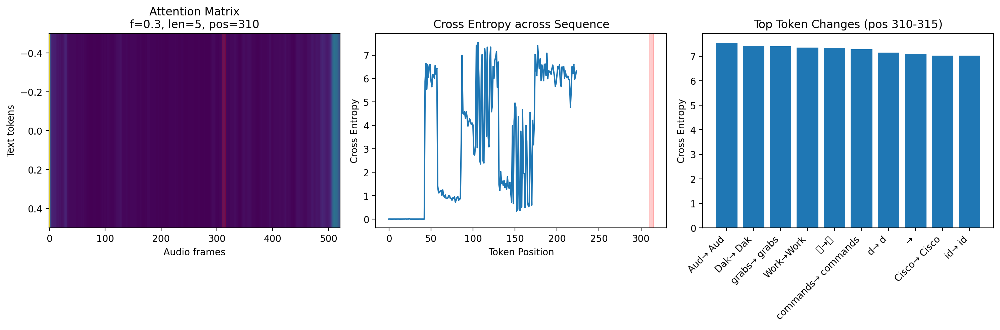


Significant changes detected at position 310:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


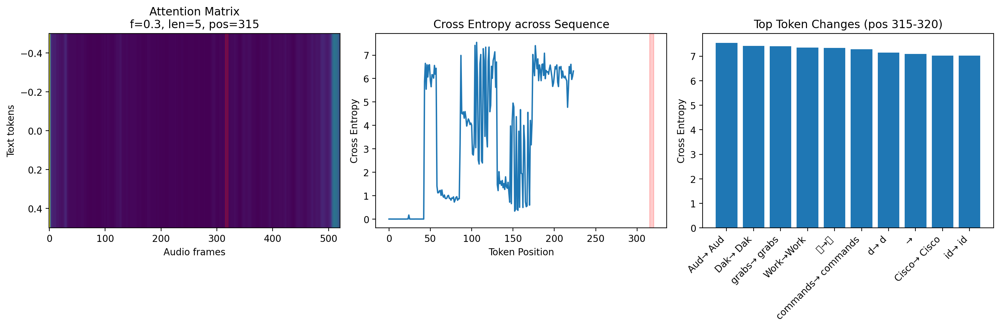


Significant changes detected at position 315:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


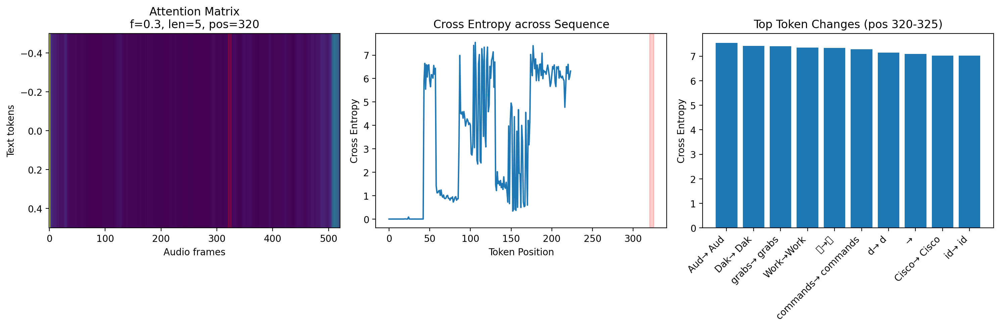


Significant changes detected at position 320:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


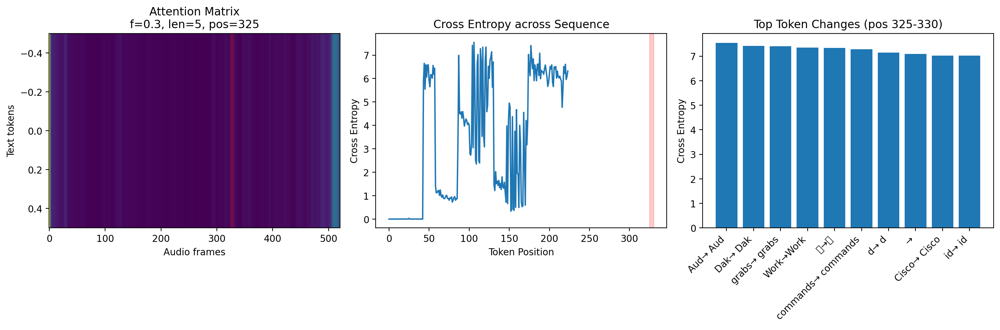


Significant changes detected at position 325:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


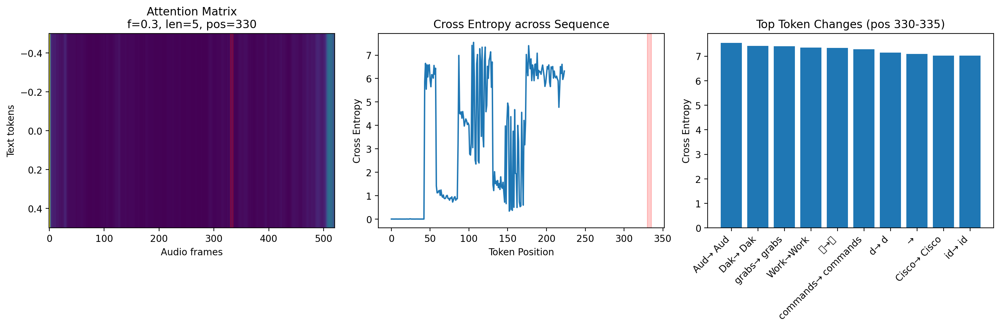


Significant changes detected at position 330:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


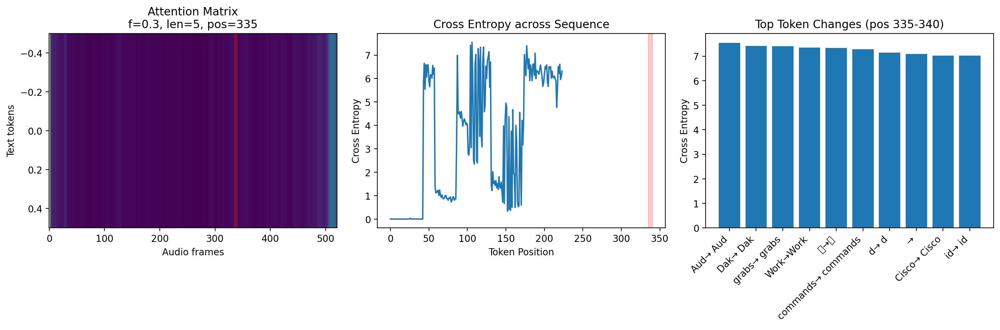


Significant changes detected at position 335:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


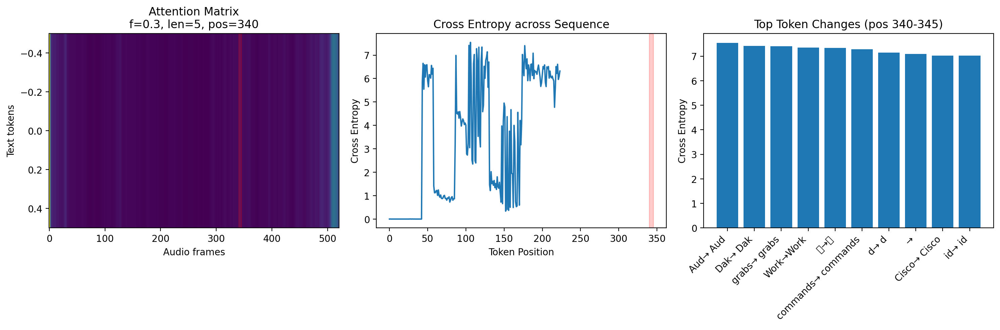


Significant changes detected at position 340:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


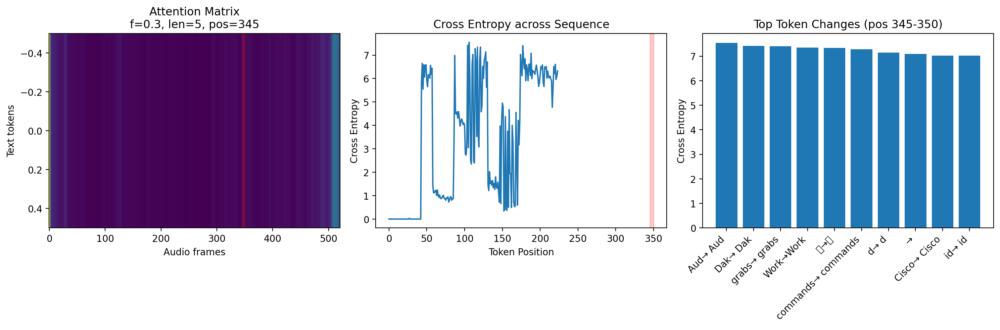


Significant changes detected at position 345:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


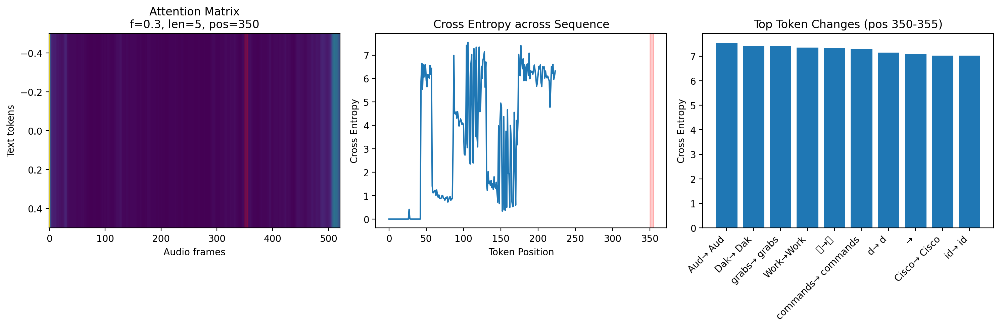


Significant changes detected at position 350:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


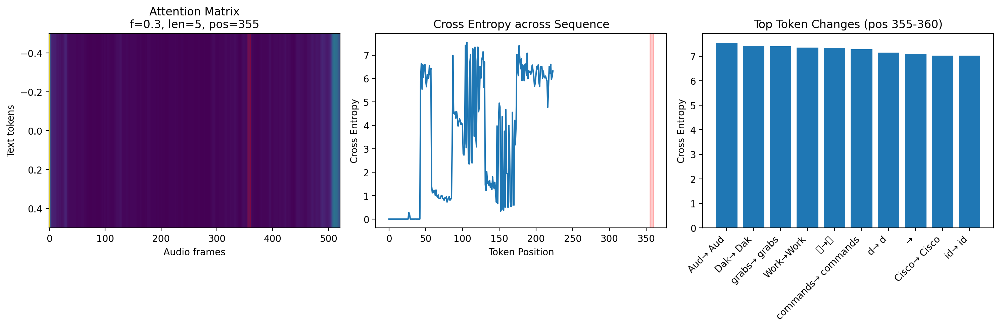


Significant changes detected at position 355:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


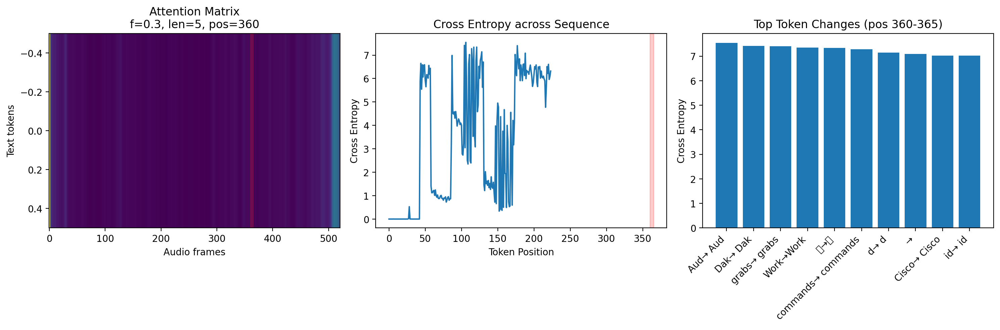


Significant changes detected at position 360:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


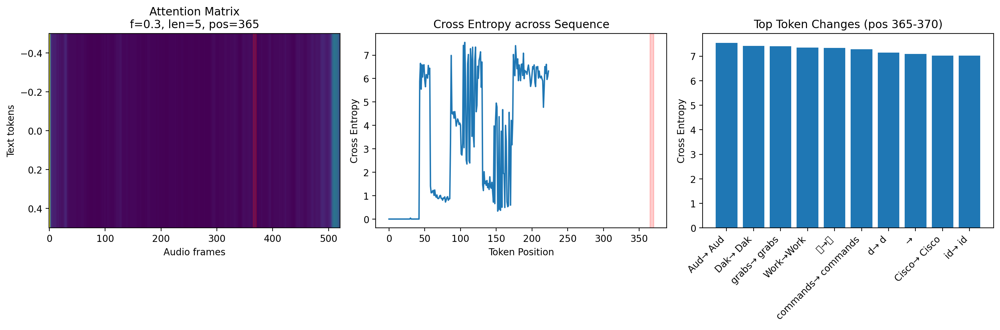


Significant changes detected at position 365:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


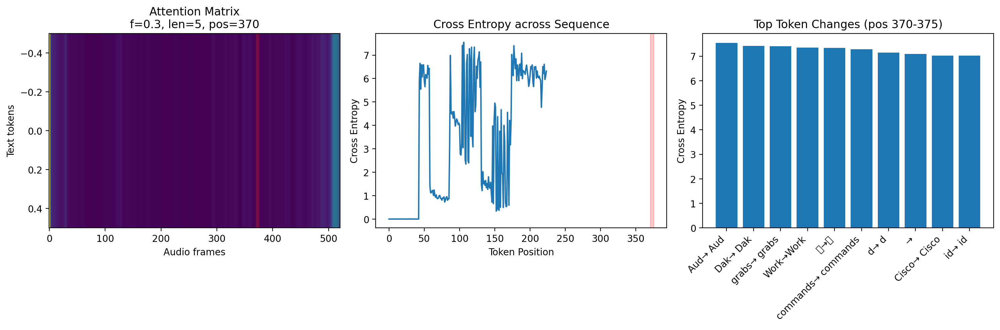


Significant changes detected at position 370:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


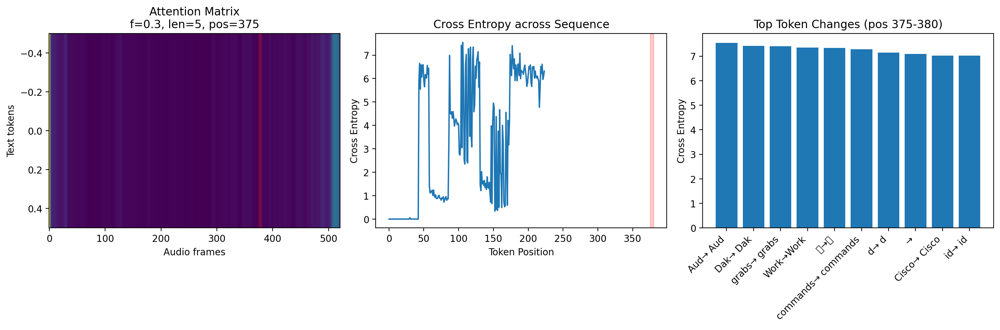


Significant changes detected at position 375:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


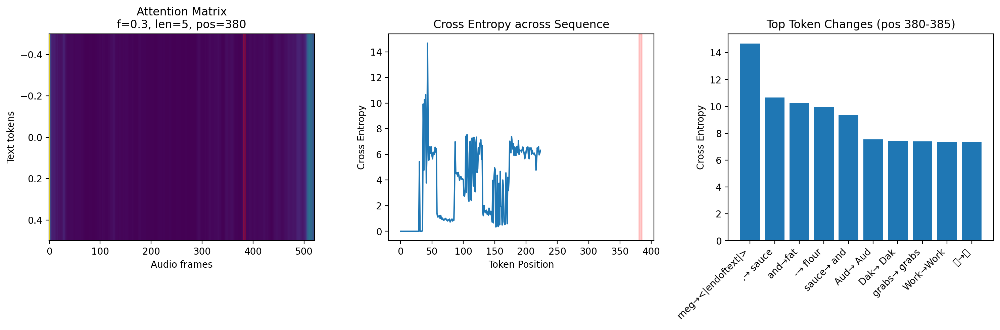


Significant changes detected at position 380:
Position 43:  meg → <|endoftext|>
  Baseline prob: 0.018
  Perturbed prob: 0.996
  Cross Entropy: 14.677
Position 40: . →  sauce
  Baseline prob: 0.890
  Perturbed prob: 0.942
  Cross Entropy: 10.668
Position 38:  and → fat
  Baseline prob: 0.305
  Perturbed prob: 0.925
  Cross Entropy: 10.277
Position 36: - →  flour
  Baseline prob: 0.474
  Perturbed prob: 0.537
  Cross Entropy: 9.934
Position 39:  sauce →  and
  Baseline prob: 0.906
  Perturbed prob: 0.390
  Cross Entropy: 9.339
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entr

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


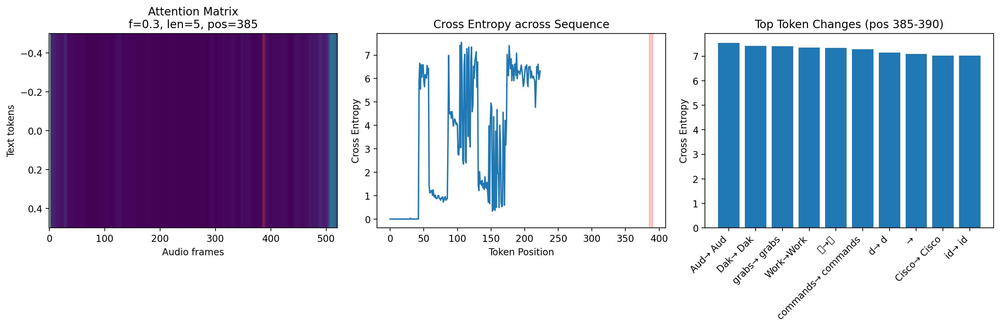


Significant changes detected at position 385:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


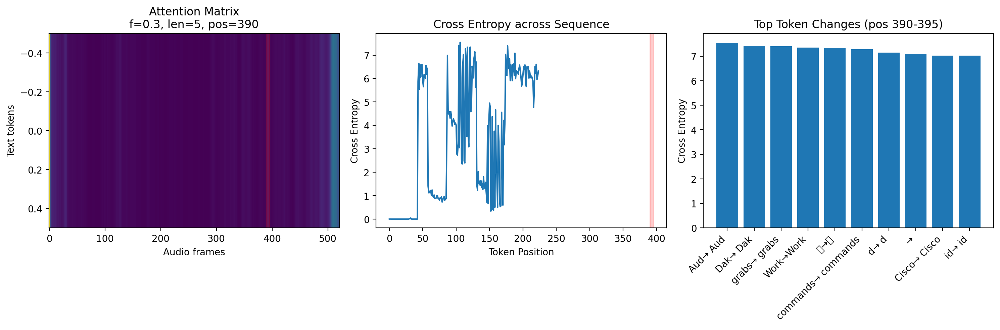


Significant changes detected at position 390:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


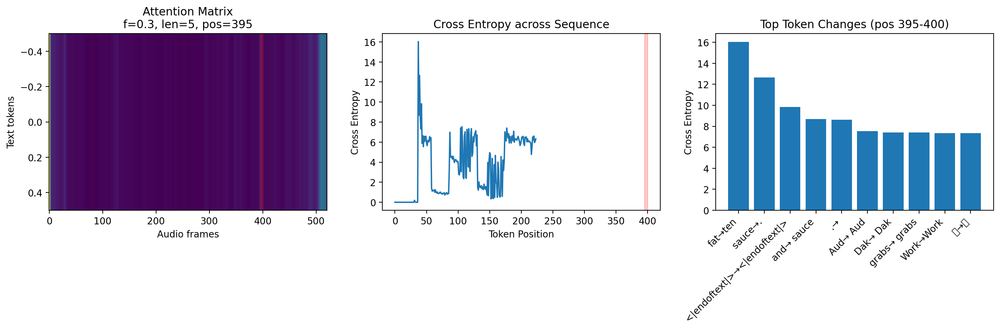


Significant changes detected at position 395:
Position 37: fat → ten
  Baseline prob: 0.884
  Perturbed prob: 0.506
  Cross Entropy: 16.034
Position 39:  sauce → .
  Baseline prob: 0.906
  Perturbed prob: 0.853
  Cross Entropy: 12.655
Position 42: <|endoftext|> → <|endoftext|>
  Baseline prob: 0.996
  Perturbed prob: 0.000
  Cross Entropy: 9.827
Position 38:  and →  sauce
  Baseline prob: 0.305
  Perturbed prob: 0.802
  Cross Entropy: 8.698
Position 40: . → 
  Baseline prob: 0.890
  Perturbed prob: 0.064
  Cross Entropy: 8.636
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Ent

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


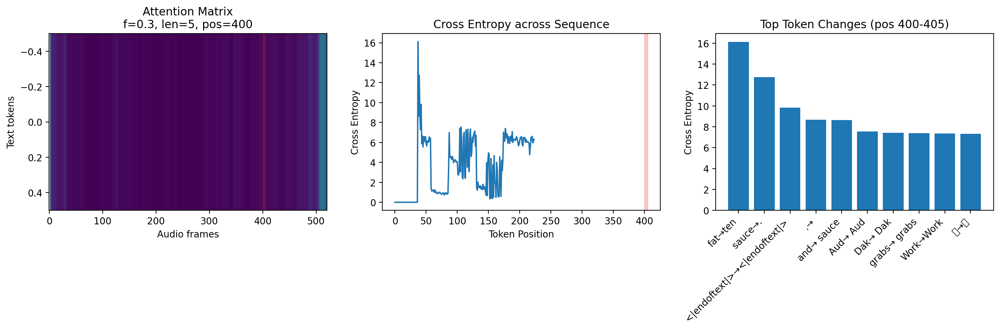


Significant changes detected at position 400:
Position 37: fat → ten
  Baseline prob: 0.884
  Perturbed prob: 0.542
  Cross Entropy: 16.122
Position 39:  sauce → .
  Baseline prob: 0.906
  Perturbed prob: 0.850
  Cross Entropy: 12.740
Position 42: <|endoftext|> → <|endoftext|>
  Baseline prob: 0.996
  Perturbed prob: 0.000
  Cross Entropy: 9.827
Position 40: . → 
  Baseline prob: 0.890
  Perturbed prob: 0.064
  Cross Entropy: 8.661
Position 38:  and →  sauce
  Baseline prob: 0.305
  Perturbed prob: 0.790
  Cross Entropy: 8.658
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Ent

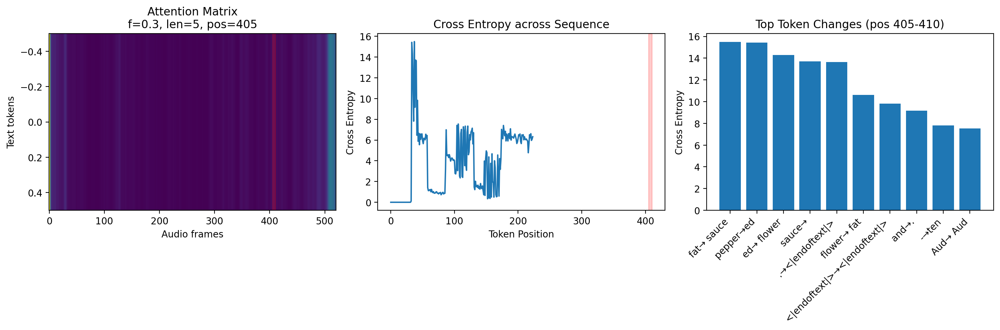


Significant changes detected at position 405:
Position 37: fat →  sauce
  Baseline prob: 0.884
  Perturbed prob: 0.835
  Cross Entropy: 15.491
Position 33:  pepper → ed
  Baseline prob: 0.657
  Perturbed prob: 0.962
  Cross Entropy: 15.419
Position 34: ed →  flower
  Baseline prob: 0.990
  Perturbed prob: 0.527
  Cross Entropy: 14.300
Position 39:  sauce → 
  Baseline prob: 0.906
  Perturbed prob: 0.063
  Cross Entropy: 13.710
Position 40: . → <|endoftext|>
  Baseline prob: 0.890
  Perturbed prob: 0.995
  Cross Entropy: 13.643
Position 35:  flower →  fat
  Baseline prob: 0.350
  Perturbed prob: 0.498
  Cross Entropy: 10.604
Position 42: <|endoftext|> → <|endoftext|>
  Baseline prob: 0.996
  Perturbed prob: 0.000
  Cross Entropy: 9.827
Position 38:  and → .
  Baseline prob: 0.305
  Perturbed prob: 0.850
  Cross Entropy: 9.158
Position 36: - → ten
  Baseline prob: 0.474
  Perturbed prob: 0.594
  Cross Entropy: 7.817
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.00

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


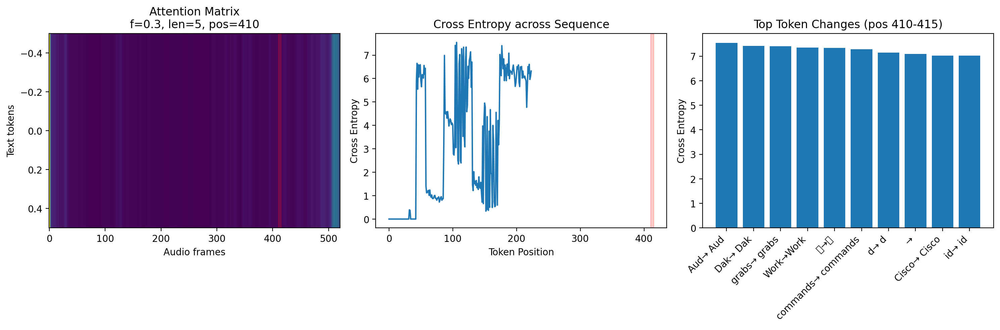


Significant changes detected at position 410:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


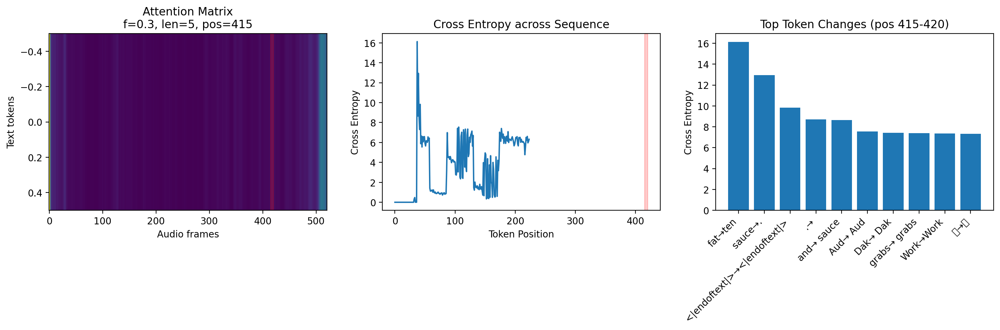


Significant changes detected at position 415:
Position 37: fat → ten
  Baseline prob: 0.884
  Perturbed prob: 0.505
  Cross Entropy: 16.126
Position 39:  sauce → .
  Baseline prob: 0.906
  Perturbed prob: 0.861
  Cross Entropy: 12.941
Position 42: <|endoftext|> → <|endoftext|>
  Baseline prob: 0.996
  Perturbed prob: 0.000
  Cross Entropy: 9.827
Position 40: . → 
  Baseline prob: 0.890
  Perturbed prob: 0.065
  Cross Entropy: 8.712
Position 38:  and →  sauce
  Baseline prob: 0.305
  Perturbed prob: 0.792
  Cross Entropy: 8.647
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Ent

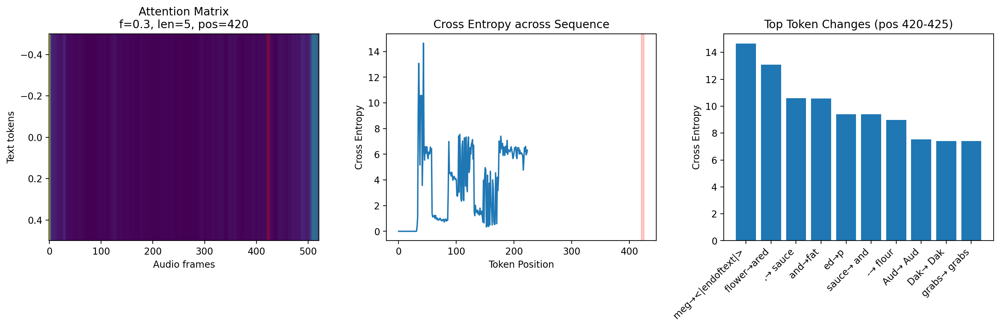


Significant changes detected at position 420:
Position 43:  meg → <|endoftext|>
  Baseline prob: 0.018
  Perturbed prob: 0.995
  Cross Entropy: 14.652
Position 35:  flower → ared
  Baseline prob: 0.350
  Perturbed prob: 0.510
  Cross Entropy: 13.078
Position 40: . →  sauce
  Baseline prob: 0.890
  Perturbed prob: 0.914
  Cross Entropy: 10.587
Position 38:  and → fat
  Baseline prob: 0.305
  Perturbed prob: 0.934
  Cross Entropy: 10.567
Position 34: ed → p
  Baseline prob: 0.990
  Perturbed prob: 0.159
  Cross Entropy: 9.398
Position 39:  sauce →  and
  Baseline prob: 0.906
  Perturbed prob: 0.479
  Cross Entropy: 9.396
Position 36: - →  flour
  Baseline prob: 0.474
  Perturbed prob: 0.453
  Cross Entropy: 8.971
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross E

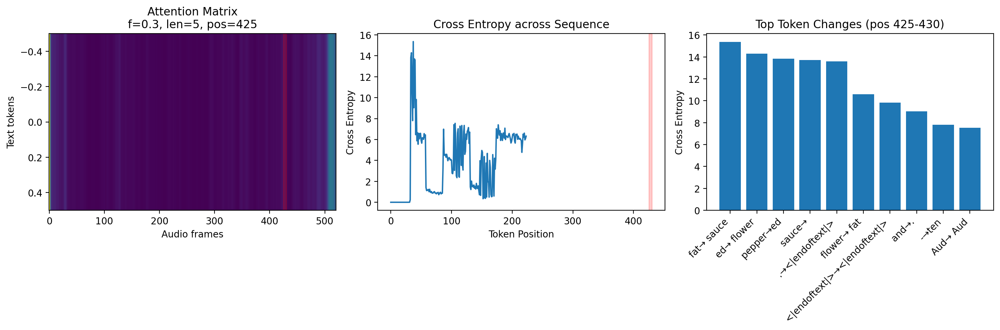


Significant changes detected at position 425:
Position 37: fat →  sauce
  Baseline prob: 0.884
  Perturbed prob: 0.811
  Cross Entropy: 15.364
Position 34: ed →  flower
  Baseline prob: 0.990
  Perturbed prob: 0.589
  Cross Entropy: 14.294
Position 33:  pepper → ed
  Baseline prob: 0.657
  Perturbed prob: 0.834
  Cross Entropy: 13.835
Position 39:  sauce → 
  Baseline prob: 0.906
  Perturbed prob: 0.062
  Cross Entropy: 13.706
Position 40: . → <|endoftext|>
  Baseline prob: 0.890
  Perturbed prob: 0.995
  Cross Entropy: 13.598
Position 35:  flower →  fat
  Baseline prob: 0.350
  Perturbed prob: 0.508
  Cross Entropy: 10.586
Position 42: <|endoftext|> → <|endoftext|>
  Baseline prob: 0.996
  Perturbed prob: 0.000
  Cross Entropy: 9.827
Position 38:  and → .
  Baseline prob: 0.305
  Perturbed prob: 0.844
  Cross Entropy: 9.039
Position 36: - → ten
  Baseline prob: 0.474
  Perturbed prob: 0.570
  Cross Entropy: 7.803
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.00

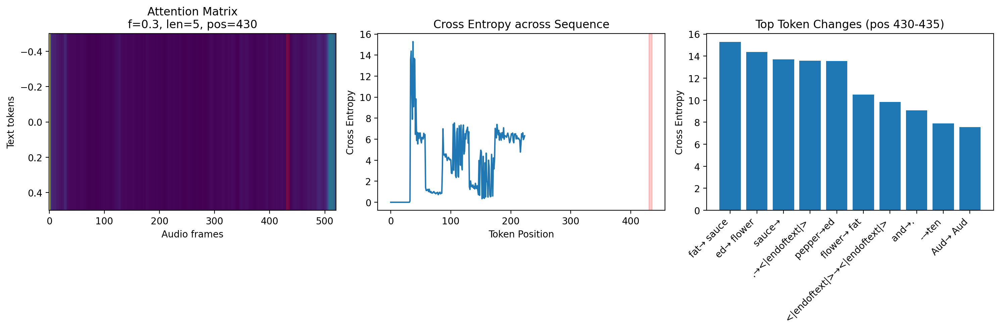


Significant changes detected at position 430:
Position 37: fat →  sauce
  Baseline prob: 0.884
  Perturbed prob: 0.799
  Cross Entropy: 15.284
Position 34: ed →  flower
  Baseline prob: 0.990
  Perturbed prob: 0.465
  Cross Entropy: 14.377
Position 39:  sauce → 
  Baseline prob: 0.906
  Perturbed prob: 0.063
  Cross Entropy: 13.689
Position 40: . → <|endoftext|>
  Baseline prob: 0.890
  Perturbed prob: 0.995
  Cross Entropy: 13.582
Position 33:  pepper → ed
  Baseline prob: 0.657
  Perturbed prob: 0.812
  Cross Entropy: 13.559
Position 35:  flower →  fat
  Baseline prob: 0.350
  Perturbed prob: 0.495
  Cross Entropy: 10.500
Position 42: <|endoftext|> → <|endoftext|>
  Baseline prob: 0.996
  Perturbed prob: 0.000
  Cross Entropy: 9.827
Position 38:  and → .
  Baseline prob: 0.305
  Perturbed prob: 0.846
  Cross Entropy: 9.085
Position 36: - → ten
  Baseline prob: 0.474
  Perturbed prob: 0.617
  Cross Entropy: 7.896
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.00

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


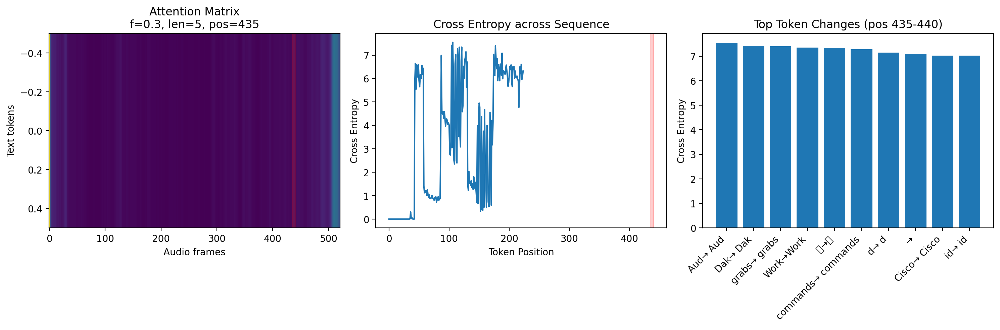


Significant changes detected at position 435:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


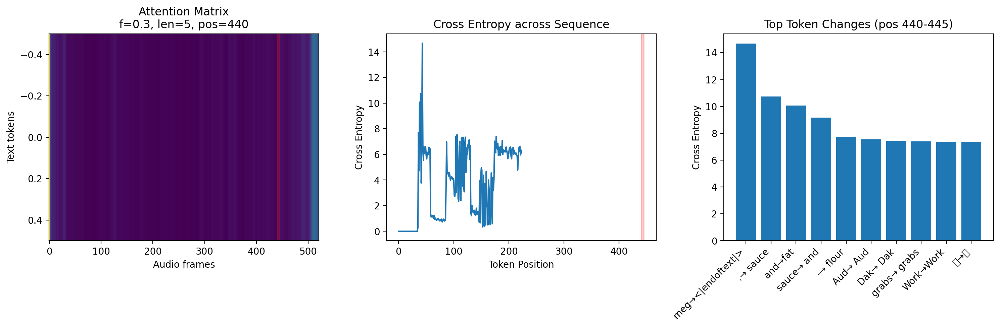


Significant changes detected at position 440:
Position 43:  meg → <|endoftext|>
  Baseline prob: 0.018
  Perturbed prob: 0.996
  Cross Entropy: 14.679
Position 40: . →  sauce
  Baseline prob: 0.890
  Perturbed prob: 0.944
  Cross Entropy: 10.741
Position 38:  and → fat
  Baseline prob: 0.305
  Perturbed prob: 0.920
  Cross Entropy: 10.075
Position 39:  sauce →  and
  Baseline prob: 0.906
  Perturbed prob: 0.465
  Cross Entropy: 9.158
Position 36: - →  flour
  Baseline prob: 0.474
  Perturbed prob: 0.572
  Cross Entropy: 7.719
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entr

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


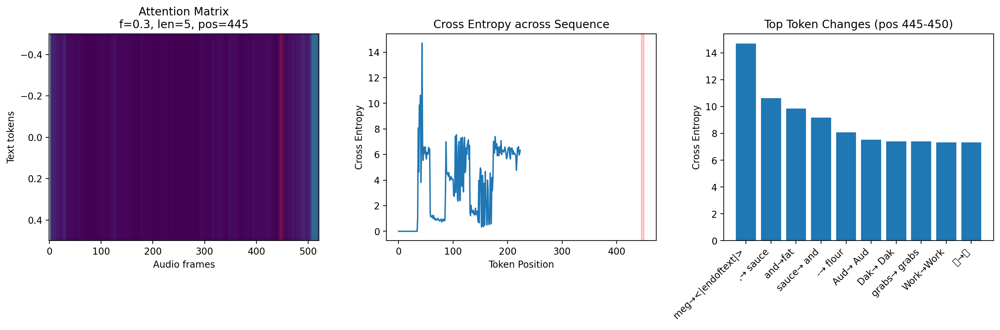


Significant changes detected at position 445:
Position 43:  meg → <|endoftext|>
  Baseline prob: 0.018
  Perturbed prob: 0.996
  Cross Entropy: 14.703
Position 40: . →  sauce
  Baseline prob: 0.890
  Perturbed prob: 0.944
  Cross Entropy: 10.630
Position 38:  and → fat
  Baseline prob: 0.305
  Perturbed prob: 0.918
  Cross Entropy: 9.866
Position 39:  sauce →  and
  Baseline prob: 0.906
  Perturbed prob: 0.446
  Cross Entropy: 9.190
Position 36: - →  flour
  Baseline prob: 0.474
  Perturbed prob: 0.300
  Cross Entropy: 8.075
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entro

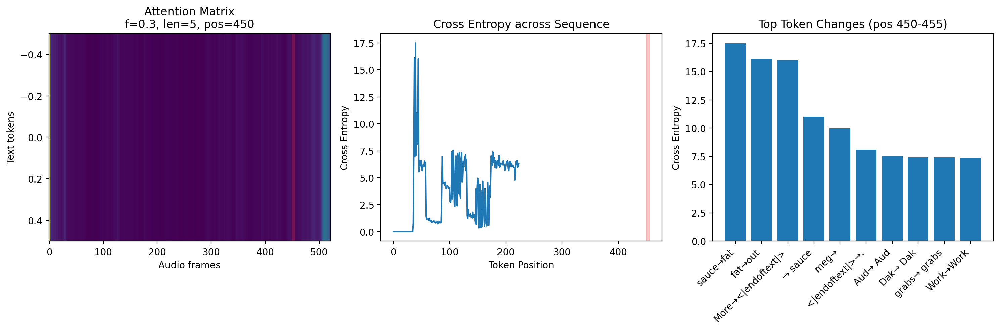


Significant changes detected at position 450:
Position 39:  sauce → fat
  Baseline prob: 0.906
  Perturbed prob: 0.889
  Cross Entropy: 17.499
Position 37: fat → out
  Baseline prob: 0.884
  Perturbed prob: 0.365
  Cross Entropy: 16.105
Position 44: More → <|endoftext|>
  Baseline prob: 0.132
  Perturbed prob: 0.996
  Cross Entropy: 16.031
Position 41:  →  sauce
  Baseline prob: 0.064
  Perturbed prob: 0.923
  Cross Entropy: 11.012
Position 43:  meg → 
  Baseline prob: 0.018
  Perturbed prob: 0.063
  Cross Entropy: 9.984
Position 42: <|endoftext|> → .
  Baseline prob: 0.996
  Perturbed prob: 0.895
  Cross Entropy: 8.105
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cros

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


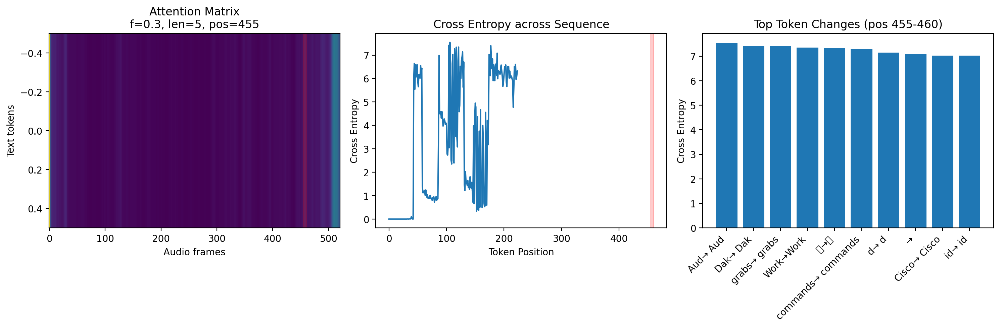


Significant changes detected at position 455:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


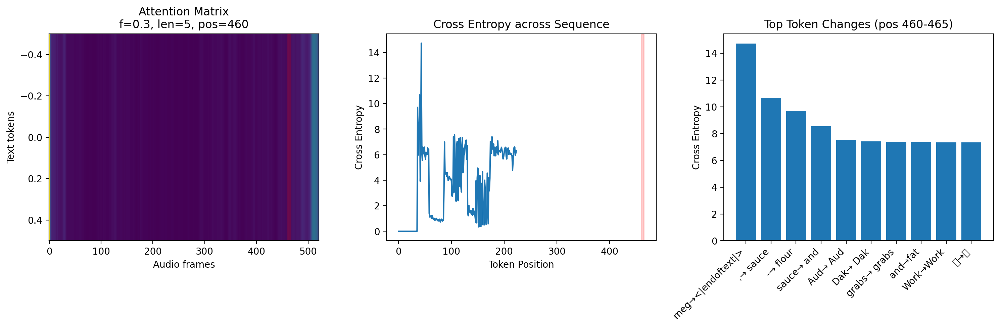


Significant changes detected at position 460:
Position 43:  meg → <|endoftext|>
  Baseline prob: 0.018
  Perturbed prob: 0.996
  Cross Entropy: 14.730
Position 40: . →  sauce
  Baseline prob: 0.890
  Perturbed prob: 0.942
  Cross Entropy: 10.682
Position 36: - →  flour
  Baseline prob: 0.474
  Perturbed prob: 0.555
  Cross Entropy: 9.701
Position 39:  sauce →  and
  Baseline prob: 0.906
  Perturbed prob: 0.527
  Cross Entropy: 8.555
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 38:  and → fat
  Baseline prob: 0.305
  Perturbed prob: 0.655
  Cross Entropy: 7.368
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entro

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


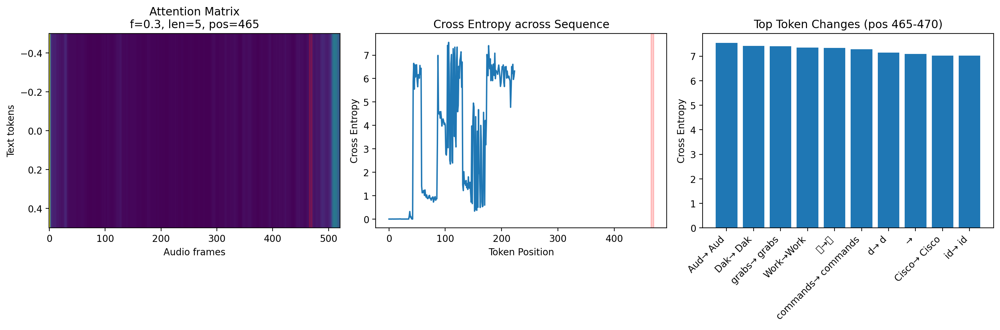


Significant changes detected at position 465:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


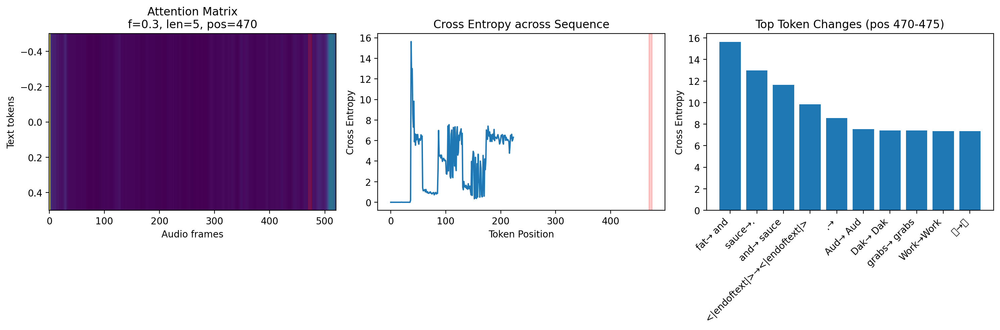


Significant changes detected at position 470:
Position 37: fat →  and
  Baseline prob: 0.884
  Perturbed prob: 0.850
  Cross Entropy: 15.628
Position 39:  sauce → .
  Baseline prob: 0.906
  Perturbed prob: 0.896
  Cross Entropy: 12.997
Position 38:  and →  sauce
  Baseline prob: 0.305
  Perturbed prob: 0.894
  Cross Entropy: 11.642
Position 42: <|endoftext|> → <|endoftext|>
  Baseline prob: 0.996
  Perturbed prob: 0.000
  Cross Entropy: 9.827
Position 40: . → 
  Baseline prob: 0.890
  Perturbed prob: 0.063
  Cross Entropy: 8.552
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross E

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


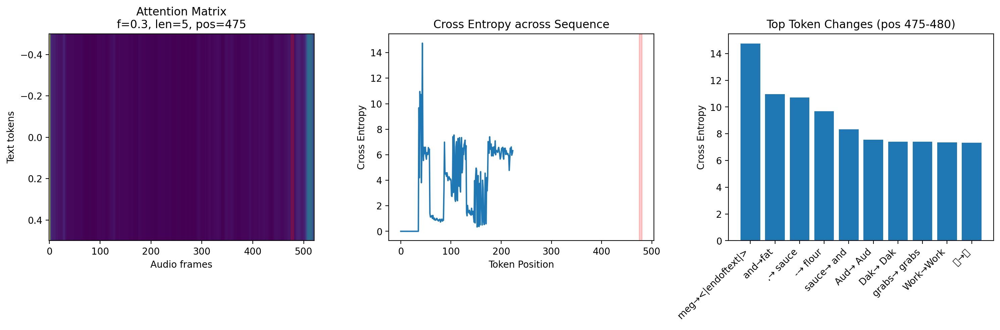


Significant changes detected at position 475:
Position 43:  meg → <|endoftext|>
  Baseline prob: 0.018
  Perturbed prob: 0.996
  Cross Entropy: 14.744
Position 38:  and → fat
  Baseline prob: 0.305
  Perturbed prob: 0.954
  Cross Entropy: 10.957
Position 40: . →  sauce
  Baseline prob: 0.890
  Perturbed prob: 0.944
  Cross Entropy: 10.725
Position 36: - →  flour
  Baseline prob: 0.474
  Perturbed prob: 0.561
  Cross Entropy: 9.681
Position 39:  sauce →  and
  Baseline prob: 0.906
  Perturbed prob: 0.514
  Cross Entropy: 8.340
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entr

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


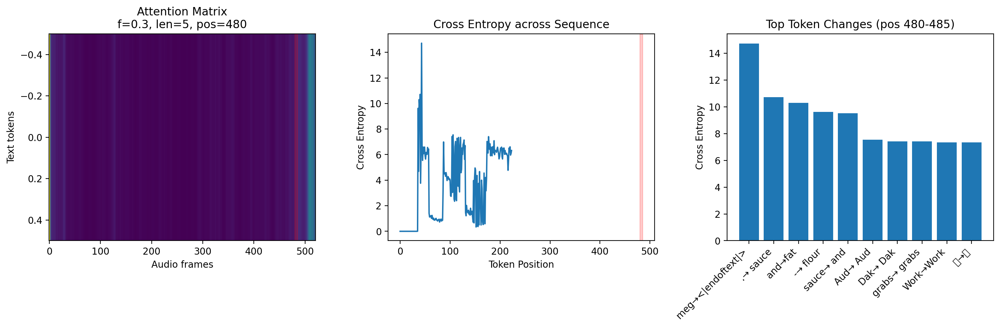


Significant changes detected at position 480:
Position 43:  meg → <|endoftext|>
  Baseline prob: 0.018
  Perturbed prob: 0.993
  Cross Entropy: 14.717
Position 40: . →  sauce
  Baseline prob: 0.890
  Perturbed prob: 0.950
  Cross Entropy: 10.713
Position 38:  and → fat
  Baseline prob: 0.305
  Perturbed prob: 0.932
  Cross Entropy: 10.301
Position 36: - →  flour
  Baseline prob: 0.474
  Perturbed prob: 0.568
  Cross Entropy: 9.623
Position 39:  sauce →  and
  Baseline prob: 0.906
  Perturbed prob: 0.476
  Cross Entropy: 9.529
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entr

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


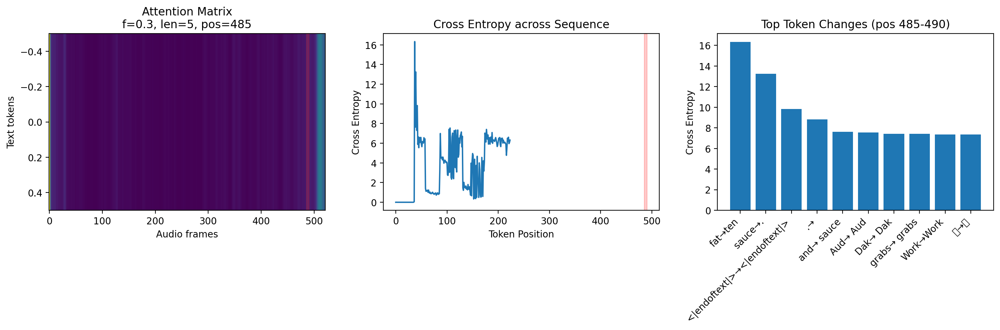


Significant changes detected at position 485:
Position 37: fat → ten
  Baseline prob: 0.884
  Perturbed prob: 0.805
  Cross Entropy: 16.332
Position 39:  sauce → .
  Baseline prob: 0.906
  Perturbed prob: 0.872
  Cross Entropy: 13.250
Position 42: <|endoftext|> → <|endoftext|>
  Baseline prob: 0.996
  Perturbed prob: 0.000
  Cross Entropy: 9.827
Position 40: . → 
  Baseline prob: 0.890
  Perturbed prob: 0.068
  Cross Entropy: 8.826
Position 38:  and →  sauce
  Baseline prob: 0.305
  Perturbed prob: 0.410
  Cross Entropy: 7.631
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Ent

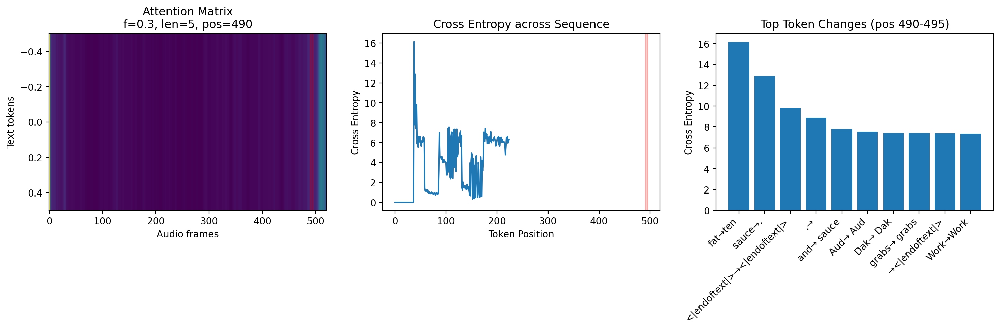


Significant changes detected at position 490:
Position 37: fat → ten
  Baseline prob: 0.884
  Perturbed prob: 0.681
  Cross Entropy: 16.149
Position 39:  sauce → .
  Baseline prob: 0.906
  Perturbed prob: 0.869
  Cross Entropy: 12.870
Position 42: <|endoftext|> → <|endoftext|>
  Baseline prob: 0.996
  Perturbed prob: 0.000
  Cross Entropy: 9.827
Position 40: . → 
  Baseline prob: 0.890
  Perturbed prob: 0.068
  Cross Entropy: 8.872
Position 38:  and →  sauce
  Baseline prob: 0.305
  Perturbed prob: 0.414
  Cross Entropy: 7.781
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 41:  → <|endoftext|>
  Baseline prob: 0.064
  Perturbed prob: 0.996
  Cross Entropy: 7.380
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
 

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


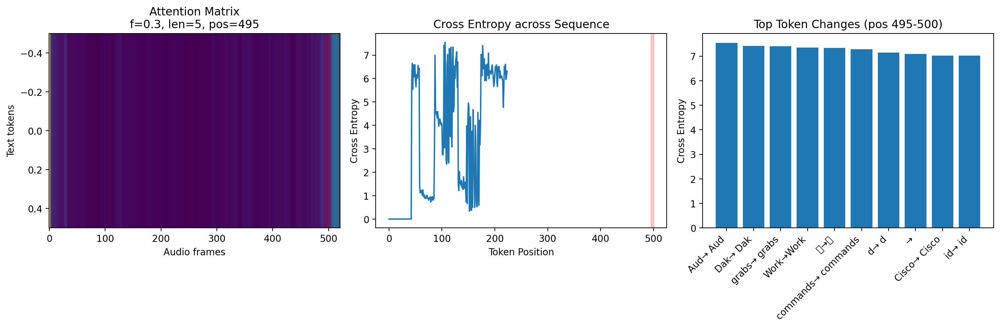


Significant changes detected at position 495:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


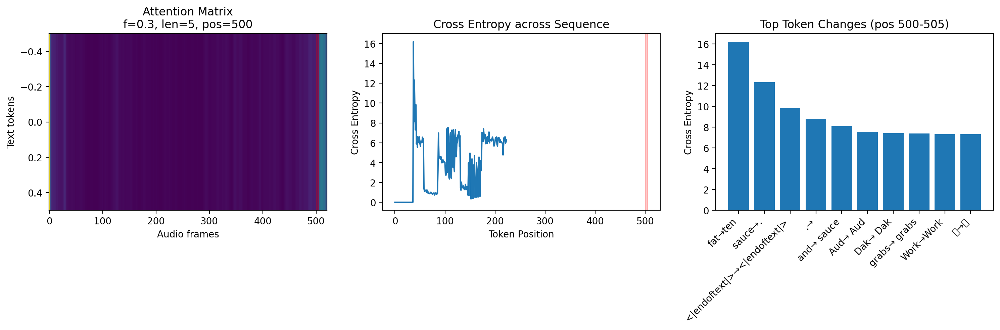


Significant changes detected at position 500:
Position 37: fat → ten
  Baseline prob: 0.884
  Perturbed prob: 0.565
  Cross Entropy: 16.206
Position 39:  sauce → .
  Baseline prob: 0.906
  Perturbed prob: 0.867
  Cross Entropy: 12.321
Position 42: <|endoftext|> → <|endoftext|>
  Baseline prob: 0.996
  Perturbed prob: 0.000
  Cross Entropy: 9.827
Position 40: . → 
  Baseline prob: 0.890
  Perturbed prob: 0.061
  Cross Entropy: 8.826
Position 38:  and →  sauce
  Baseline prob: 0.305
  Perturbed prob: 0.700
  Cross Entropy: 8.120
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Ent

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


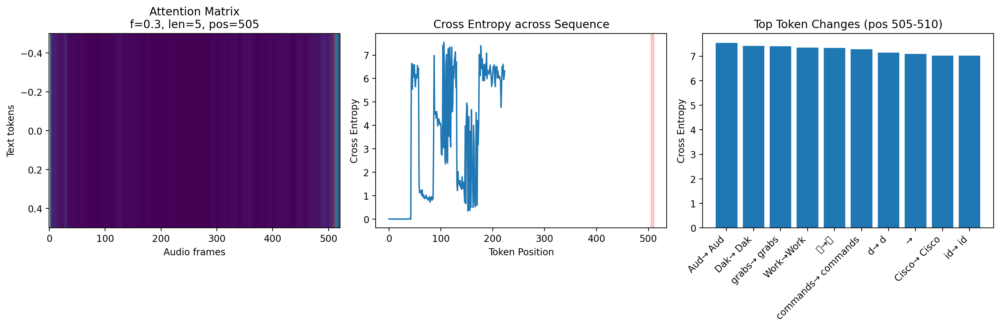


Significant changes detected at position 505:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


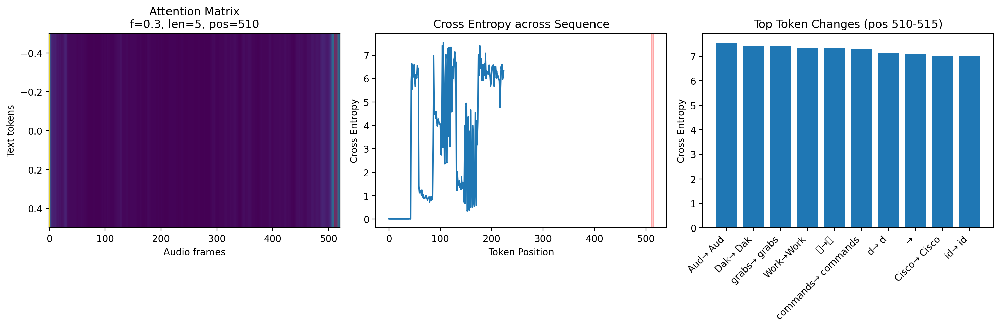


Significant changes detected at position 510:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


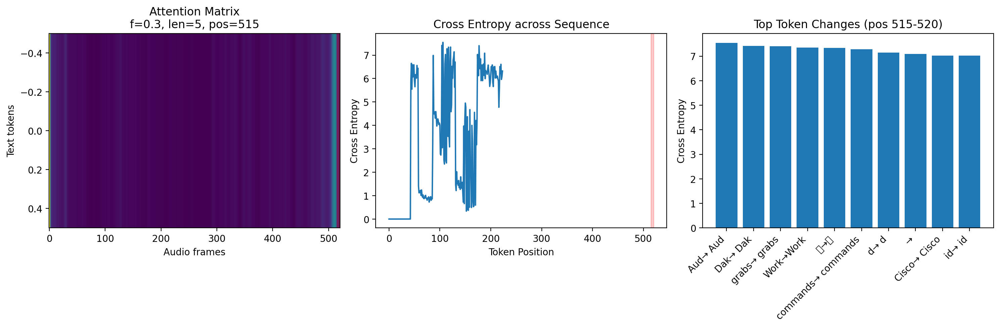


Significant changes detected at position 515:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


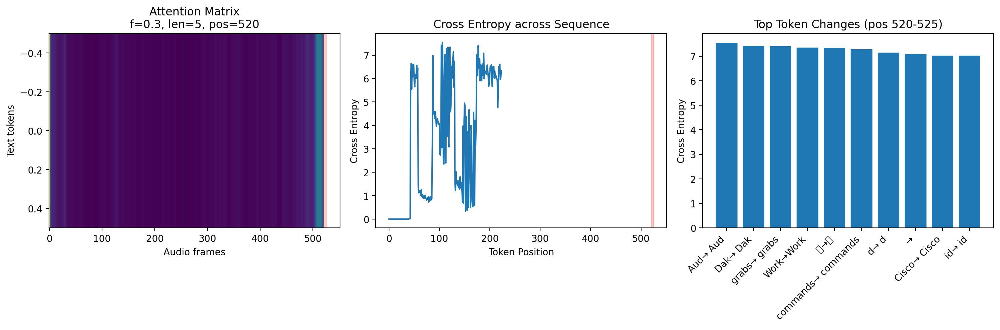


Significant changes detected at position 520:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


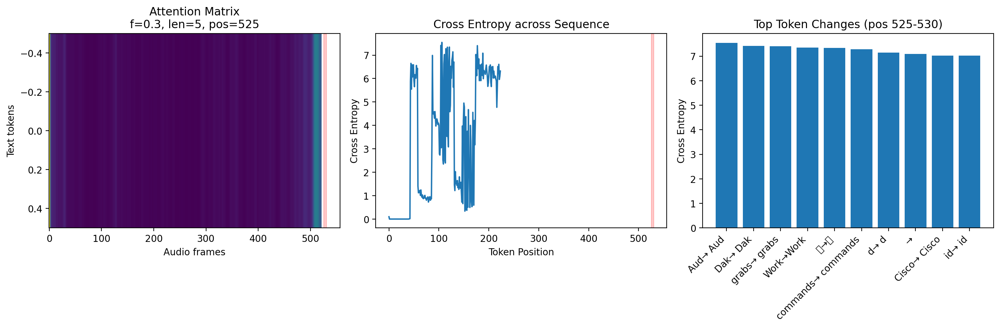


Significant changes detected at position 525:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


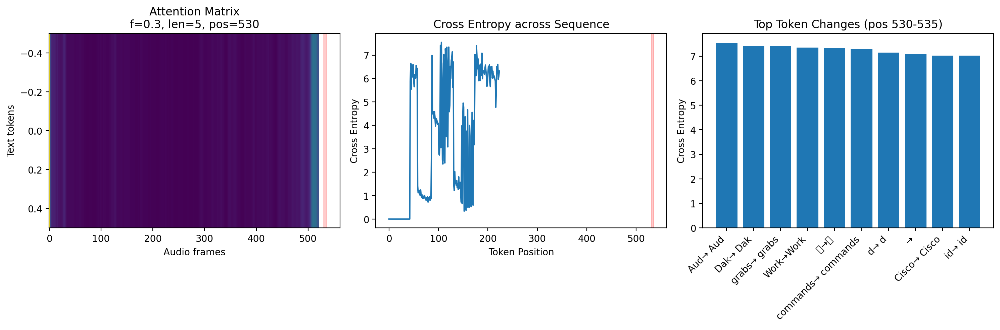


Significant changes detected at position 530:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


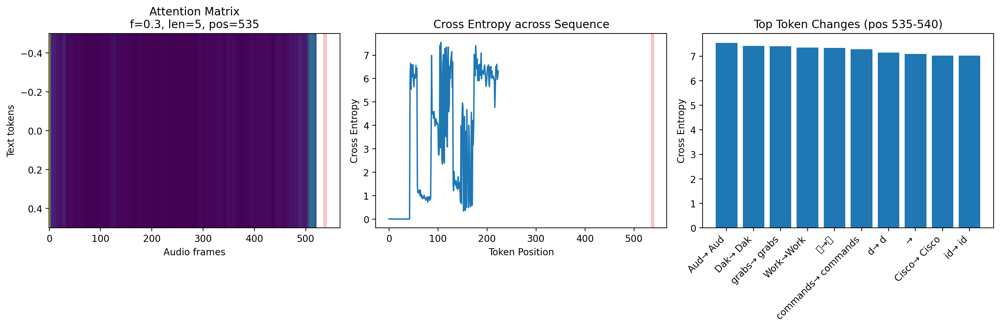


Significant changes detected at position 535:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


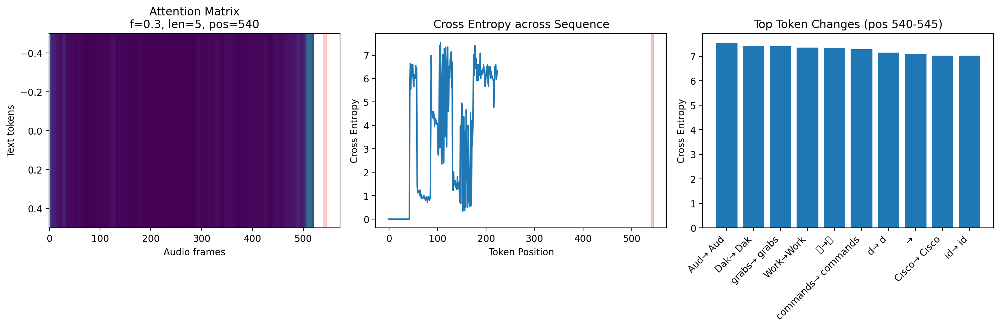


Significant changes detected at position 540:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


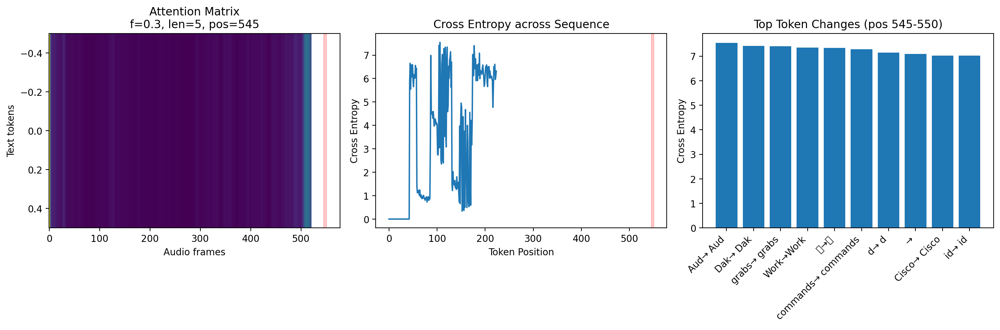


Significant changes detected at position 545:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


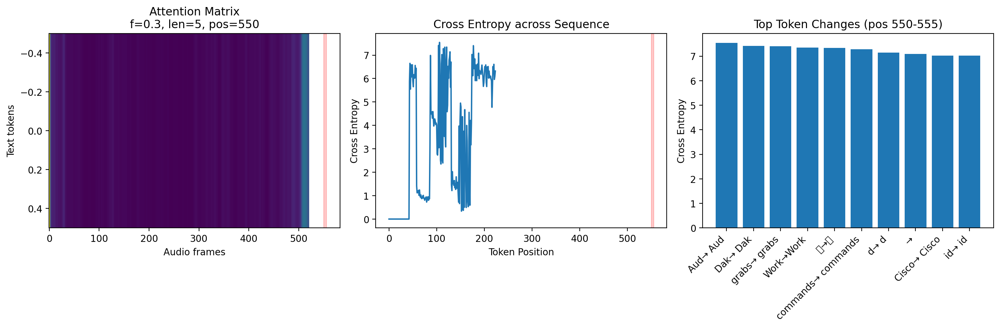


Significant changes detected at position 550:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


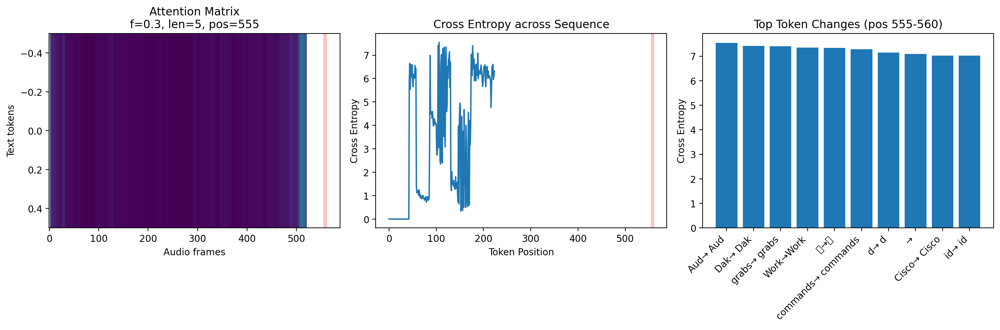


Significant changes detected at position 555:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


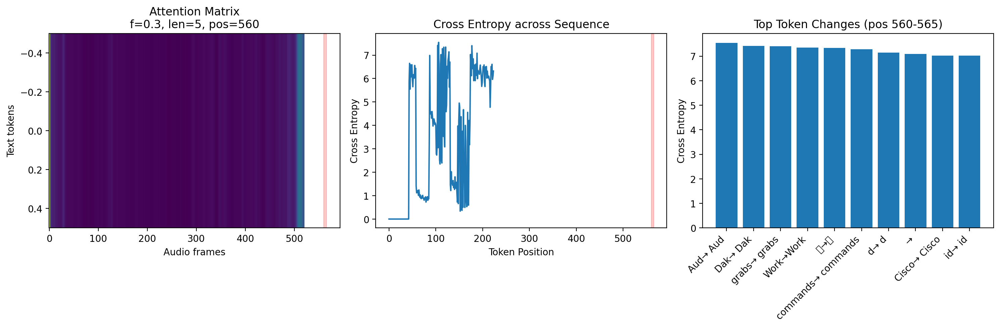


Significant changes detected at position 560:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


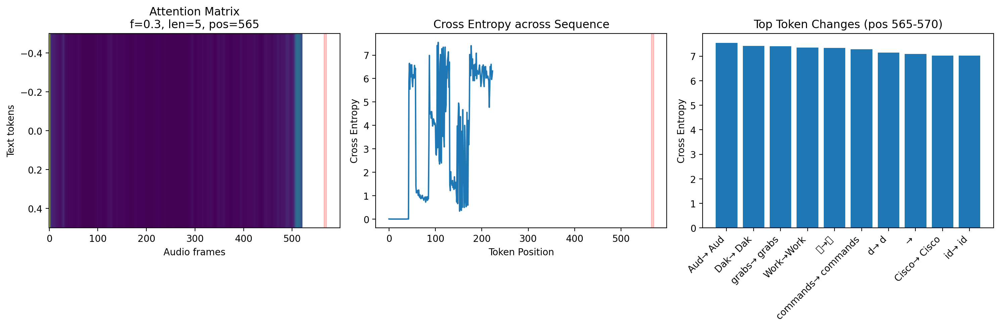


Significant changes detected at position 565:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


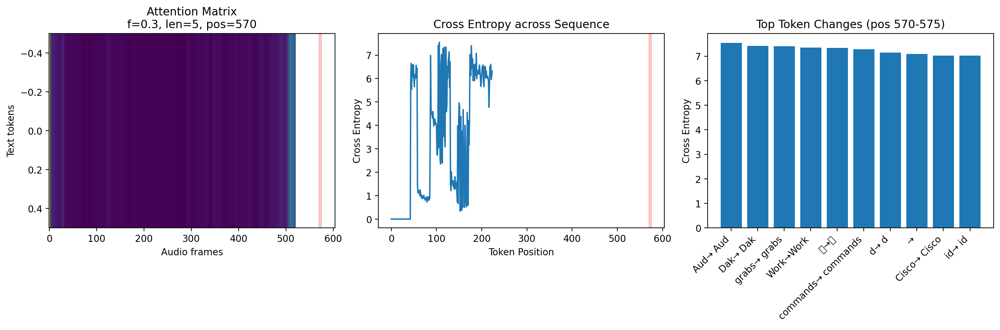


Significant changes detected at position 570:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


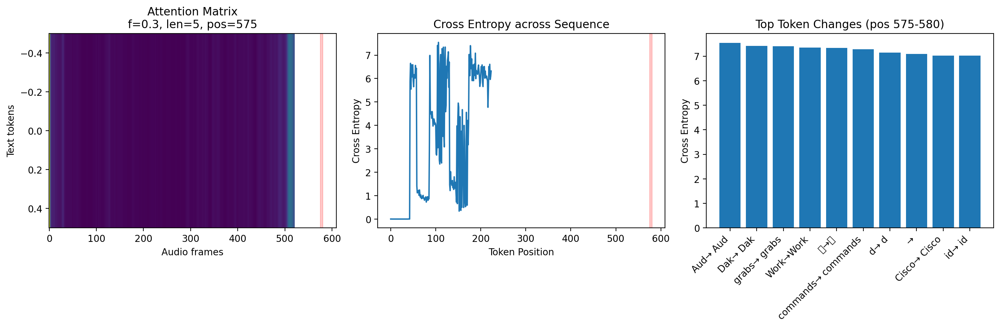


Significant changes detected at position 575:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


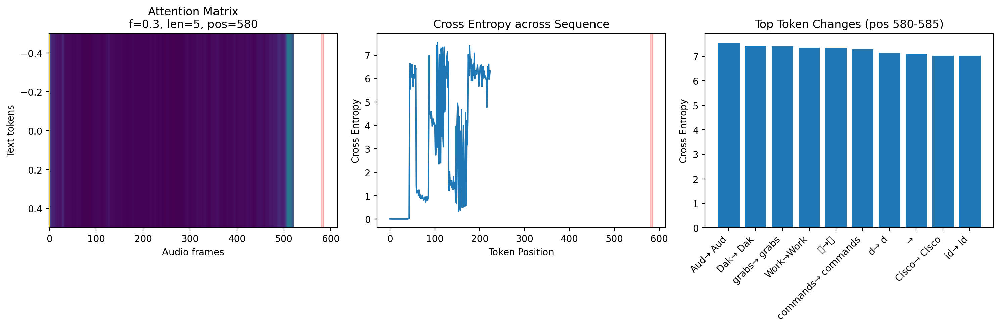


Significant changes detected at position 580:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


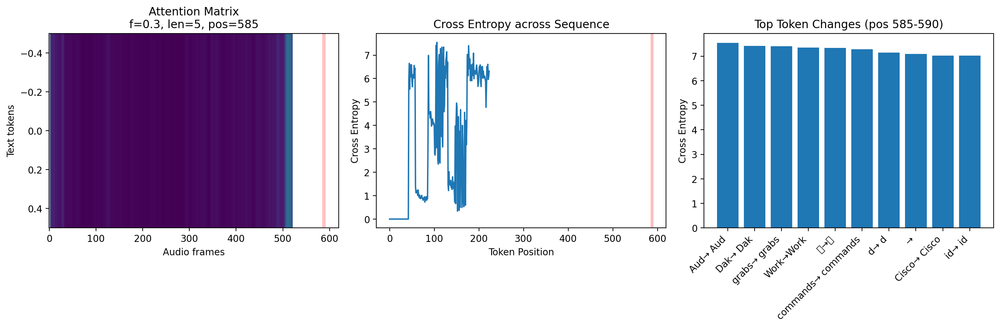


Significant changes detected at position 585:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


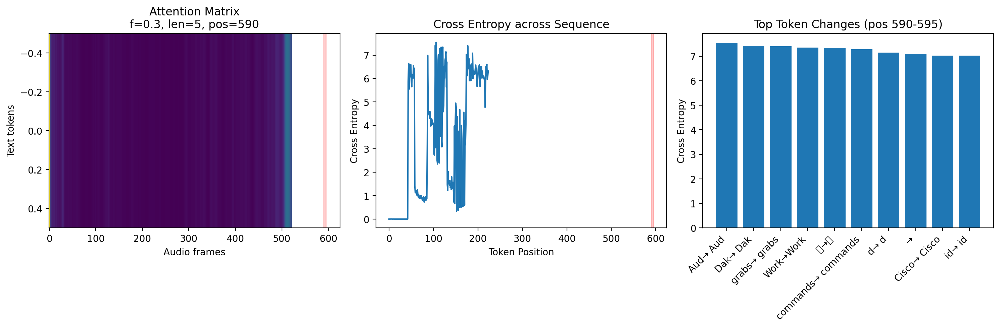


Significant changes detected at position 590:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


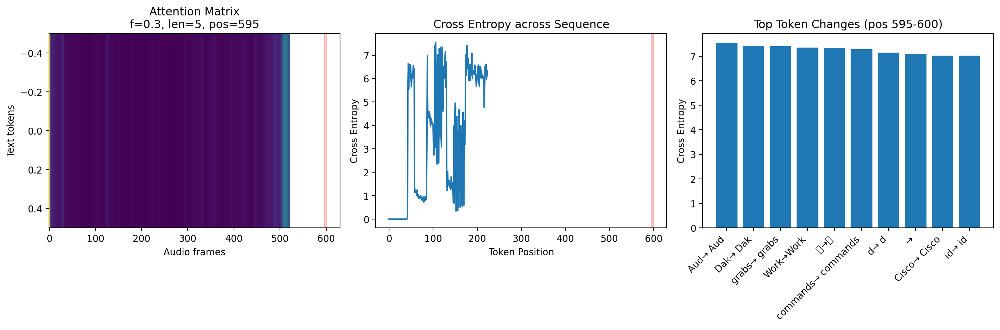


Significant changes detected at position 595:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


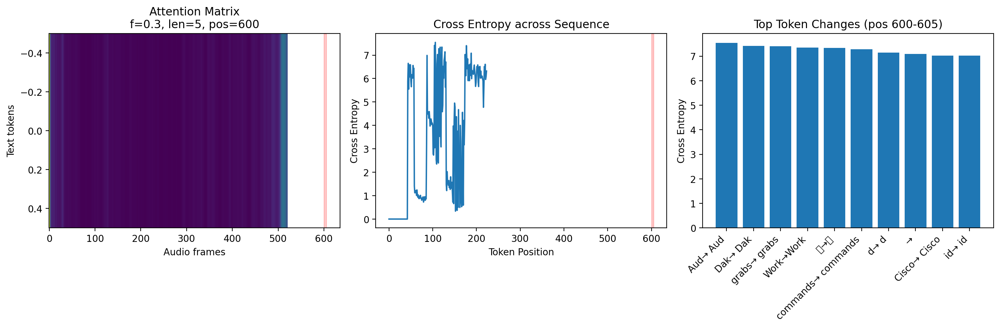


Significant changes detected at position 600:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


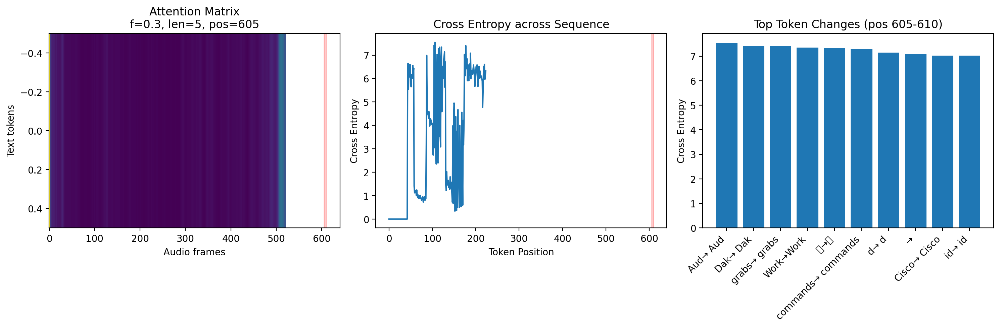


Significant changes detected at position 605:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


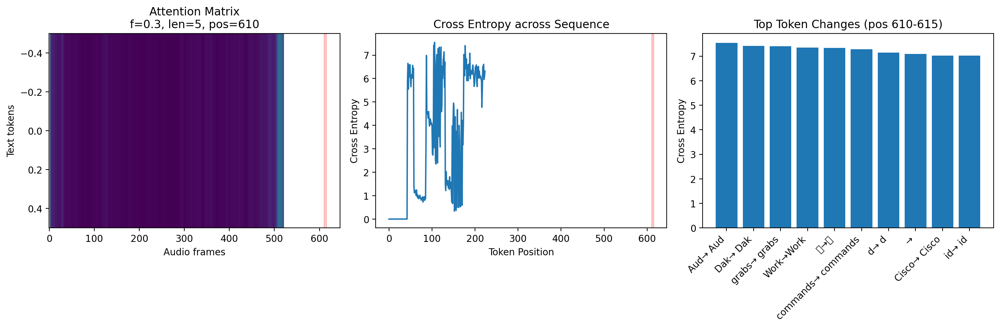


Significant changes detected at position 610:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


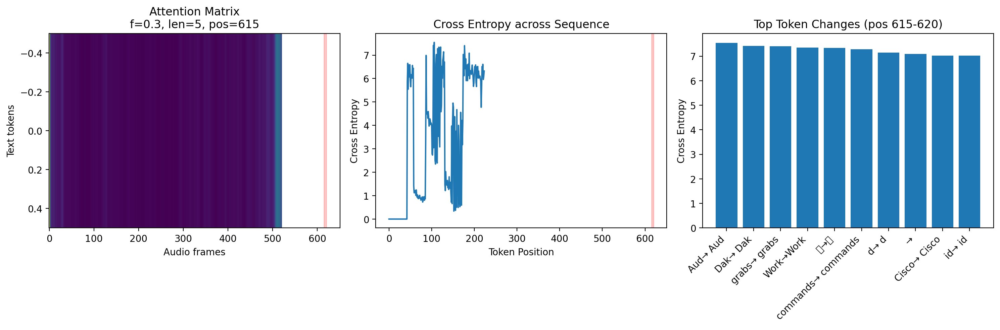


Significant changes detected at position 615:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


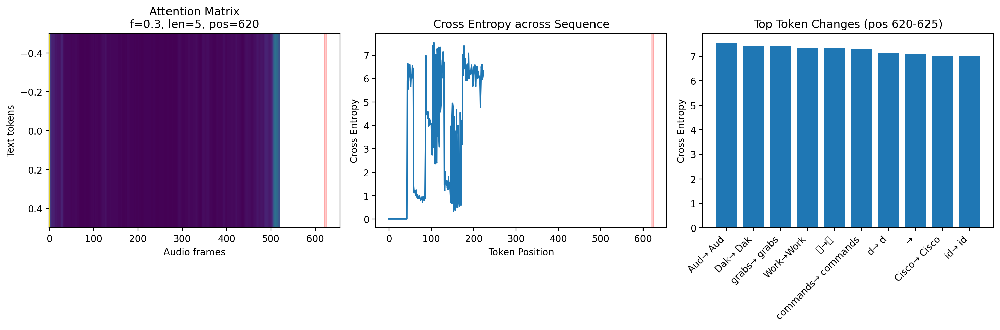


Significant changes detected at position 620:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


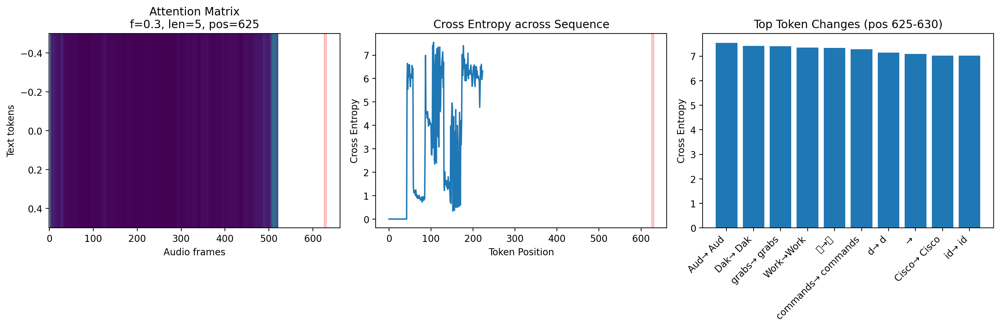


Significant changes detected at position 625:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


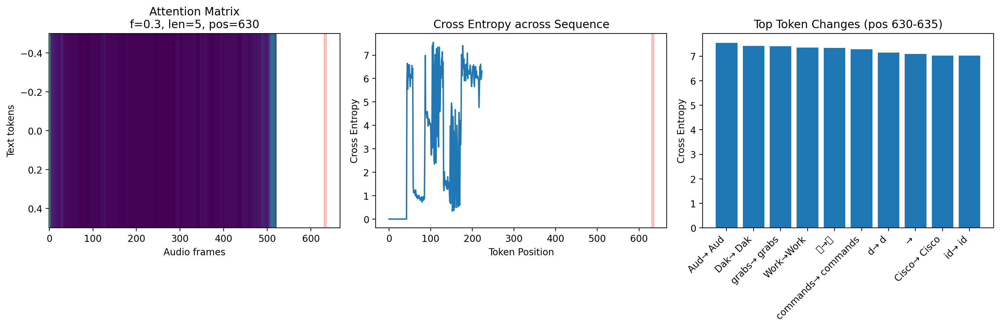


Significant changes detected at position 630:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


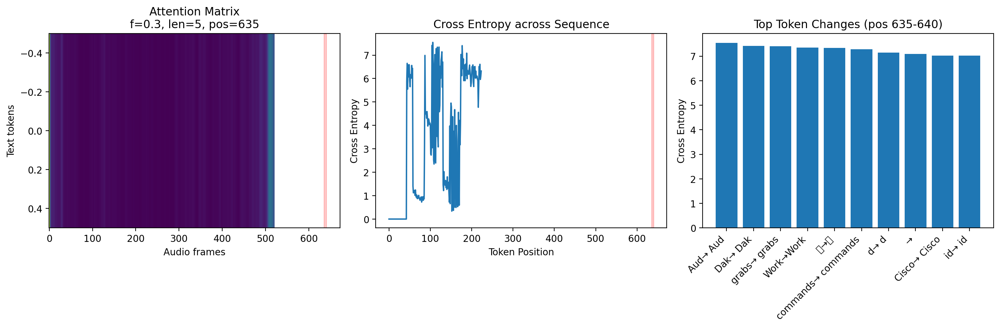


Significant changes detected at position 635:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


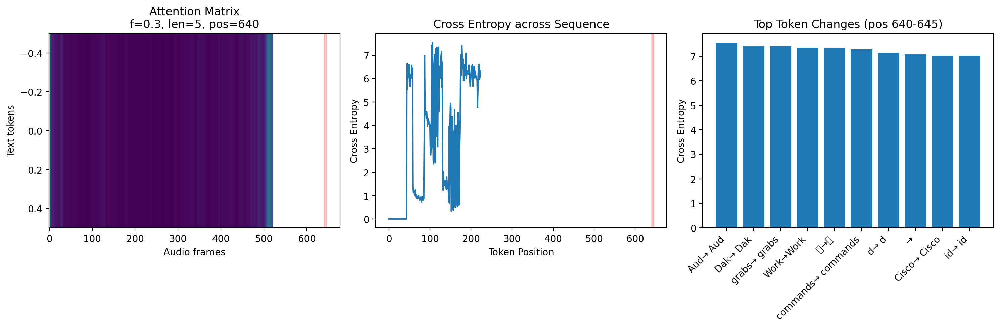


Significant changes detected at position 640:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


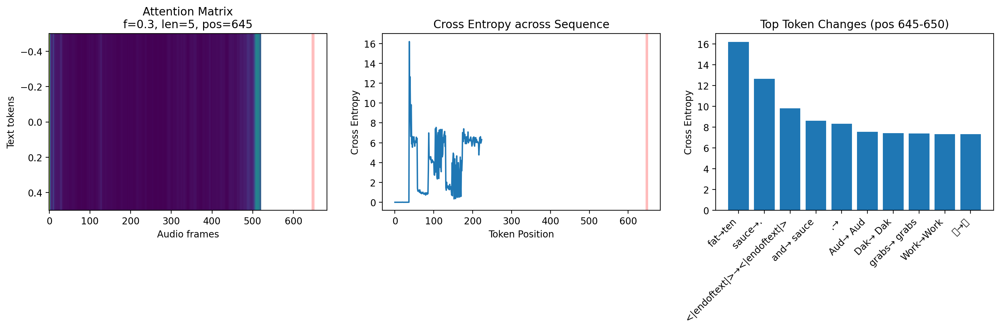


Significant changes detected at position 645:
Position 37: fat → ten
  Baseline prob: 0.884
  Perturbed prob: 0.514
  Cross Entropy: 16.200
Position 39:  sauce → .
  Baseline prob: 0.906
  Perturbed prob: 0.855
  Cross Entropy: 12.651
Position 42: <|endoftext|> → <|endoftext|>
  Baseline prob: 0.996
  Perturbed prob: 0.000
  Cross Entropy: 9.827
Position 38:  and →  sauce
  Baseline prob: 0.305
  Perturbed prob: 0.770
  Cross Entropy: 8.605
Position 40: . → 
  Baseline prob: 0.890
  Perturbed prob: 0.061
  Cross Entropy: 8.344
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Ent

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


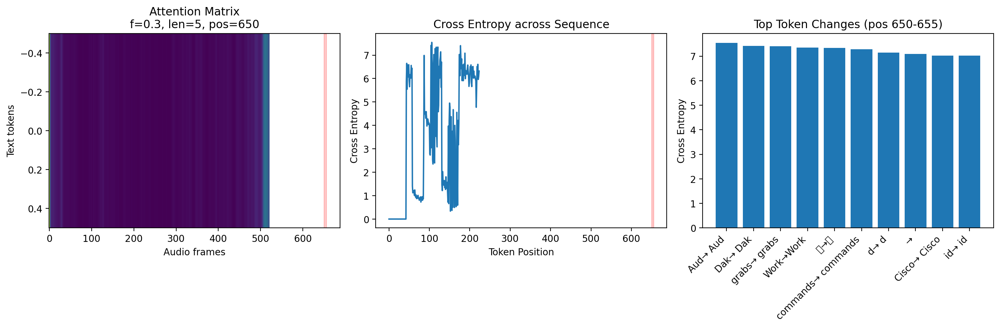


Significant changes detected at position 650:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


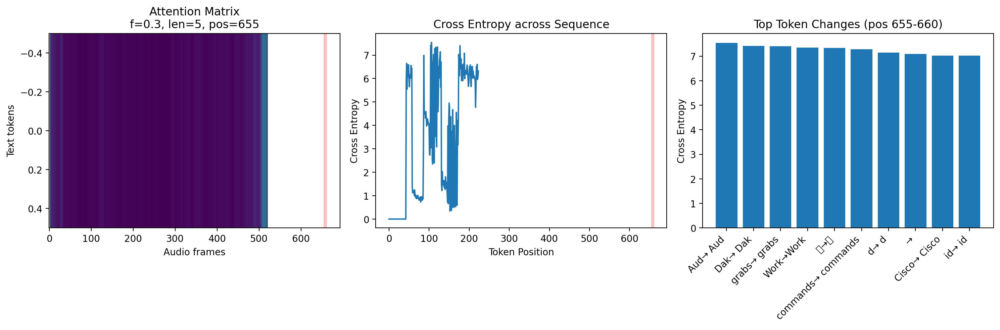


Significant changes detected at position 655:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


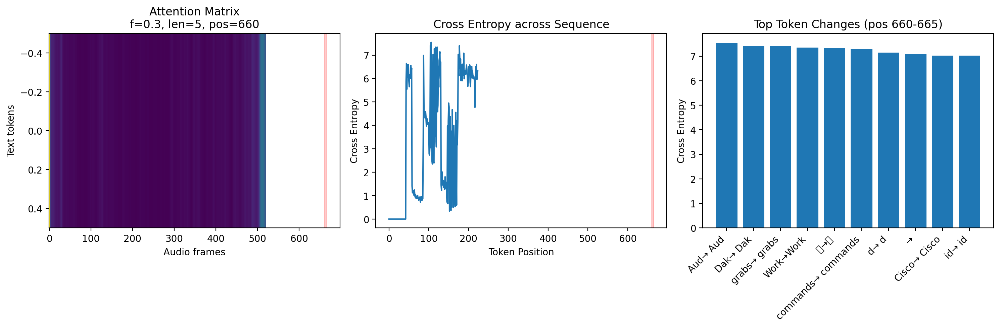


Significant changes detected at position 660:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


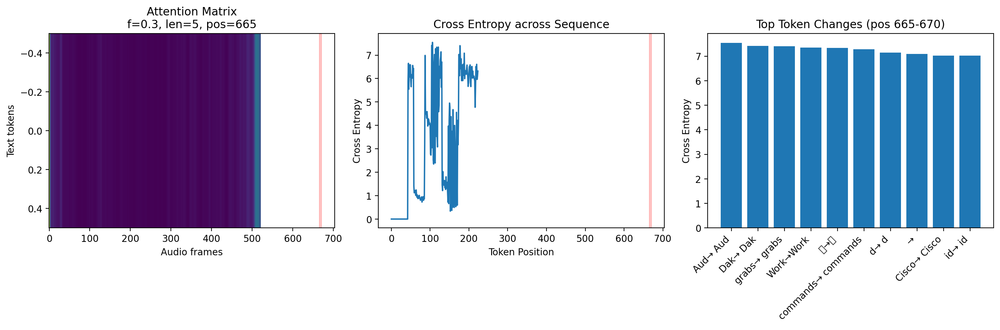


Significant changes detected at position 665:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


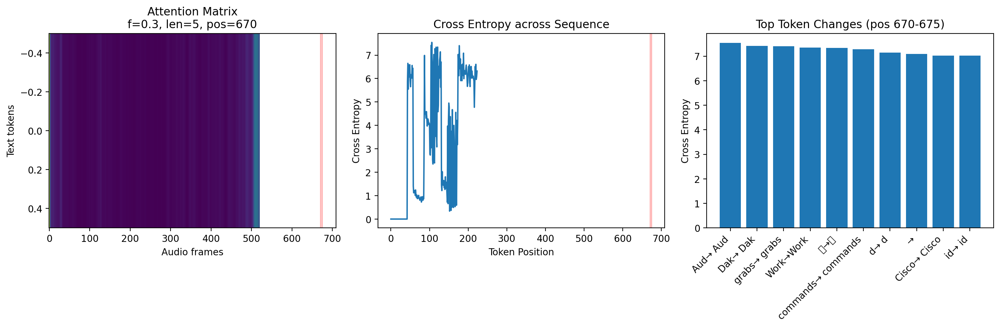


Significant changes detected at position 670:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


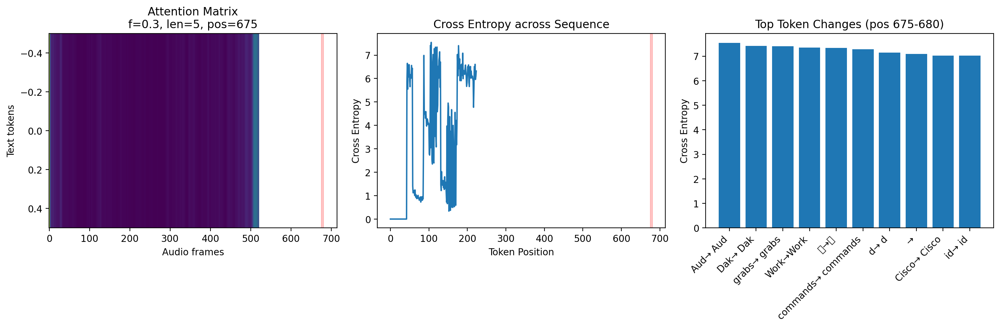


Significant changes detected at position 675:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


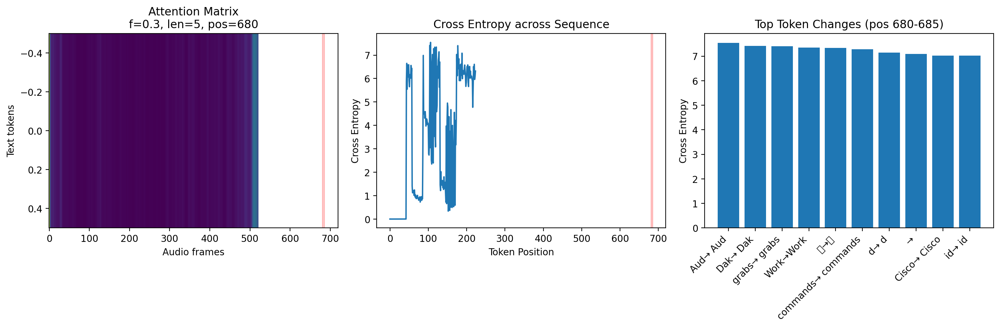


Significant changes detected at position 680:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


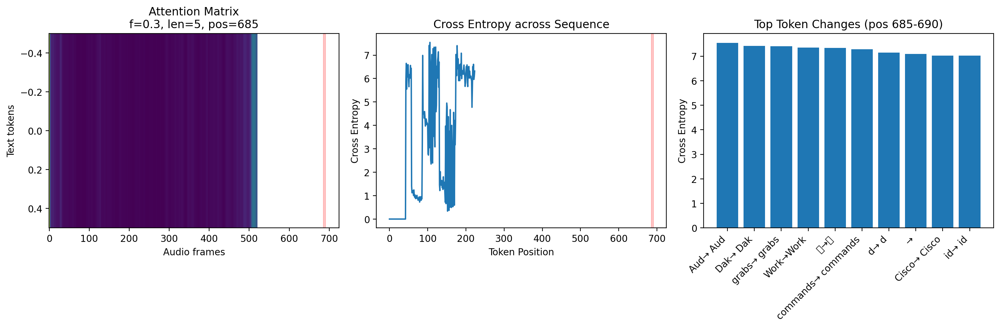


Significant changes detected at position 685:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


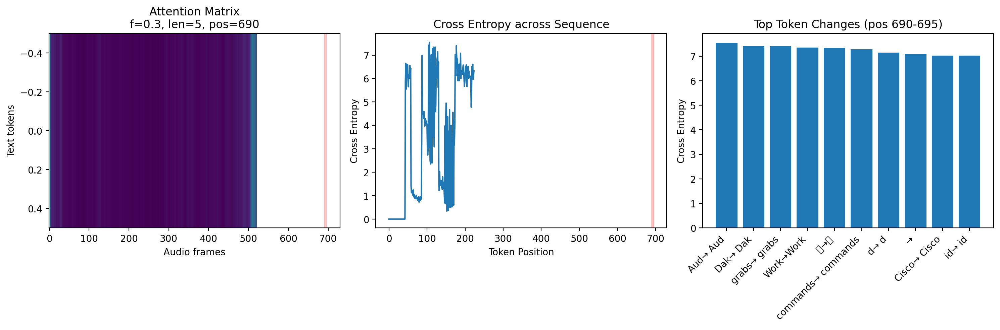


Significant changes detected at position 690:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


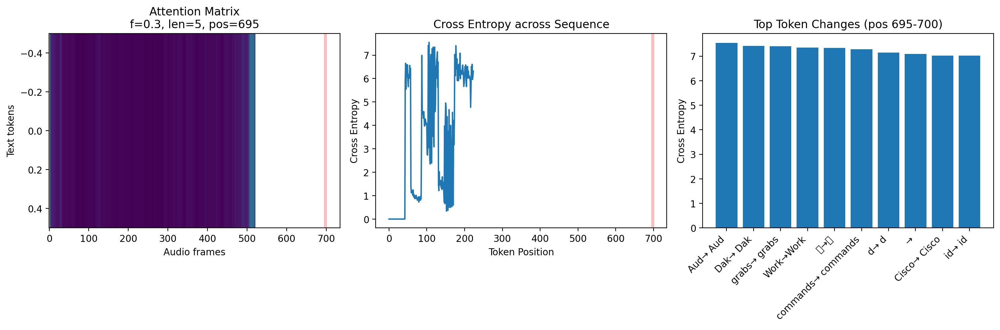


Significant changes detected at position 695:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


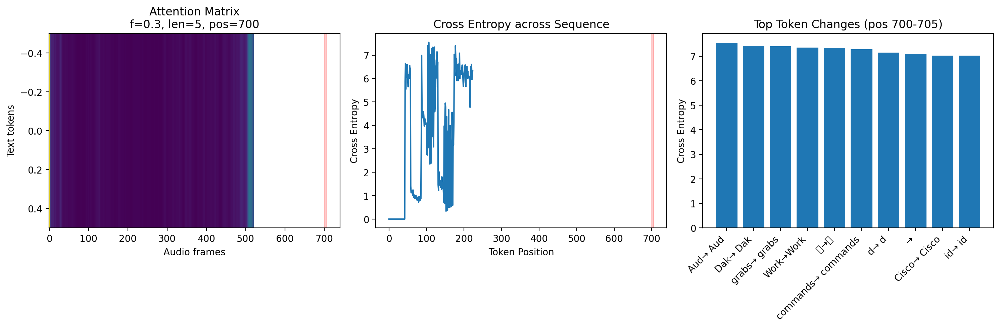


Significant changes detected at position 700:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


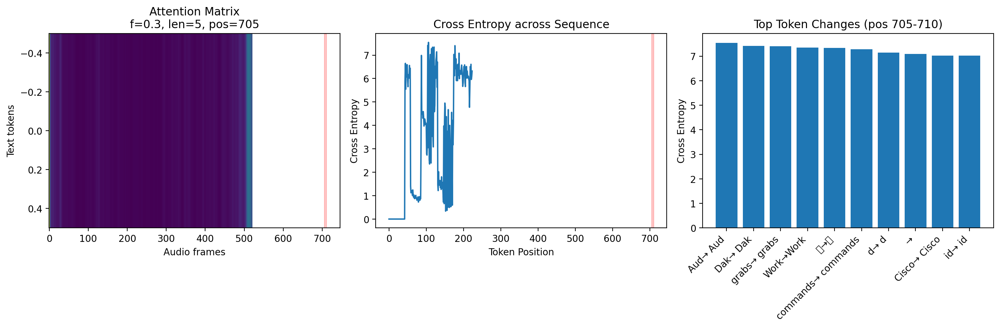


Significant changes detected at position 705:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


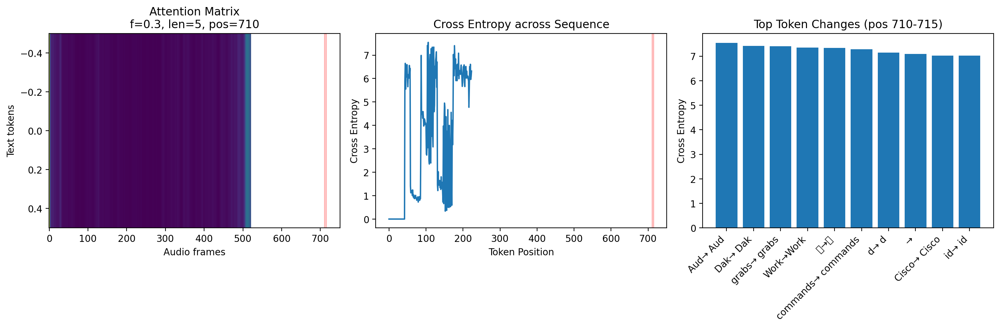


Significant changes detected at position 710:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


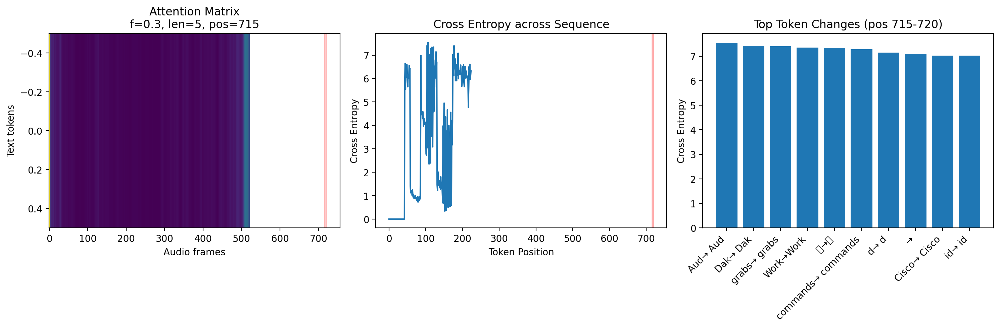


Significant changes detected at position 715:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


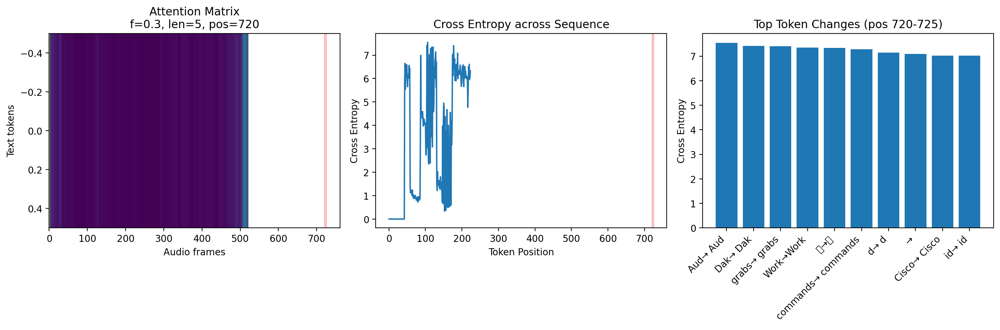


Significant changes detected at position 720:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


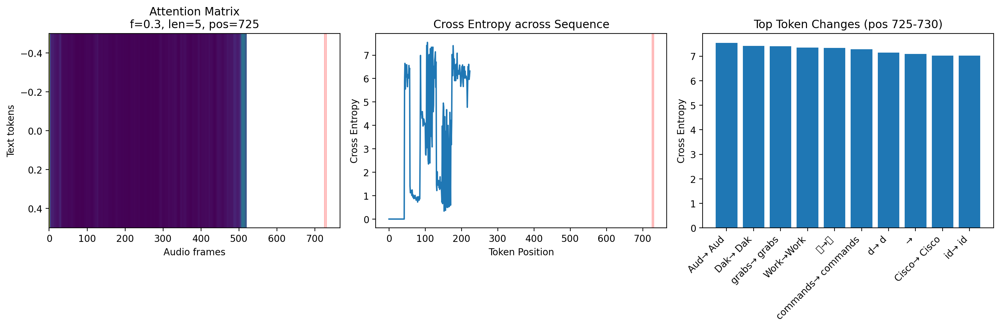


Significant changes detected at position 725:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


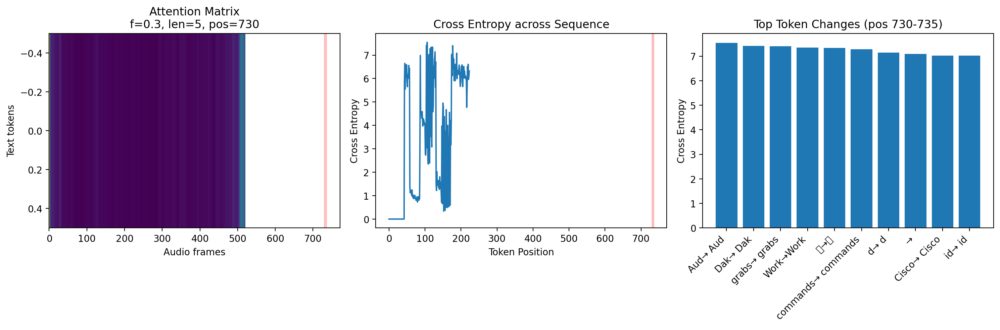


Significant changes detected at position 730:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


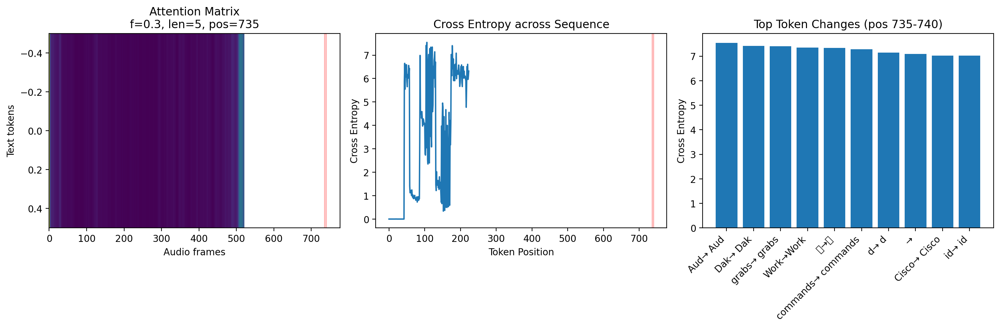


Significant changes detected at position 735:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


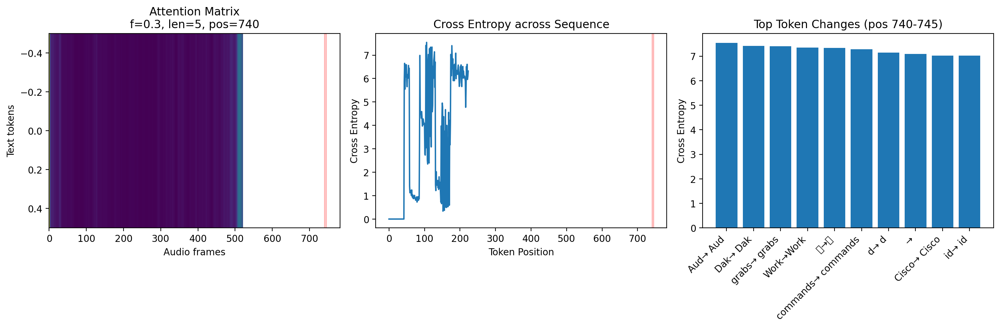


Significant changes detected at position 740:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


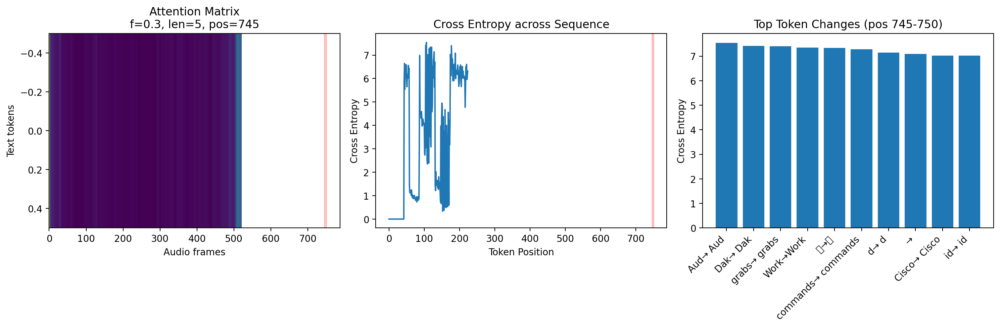


Significant changes detected at position 745:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


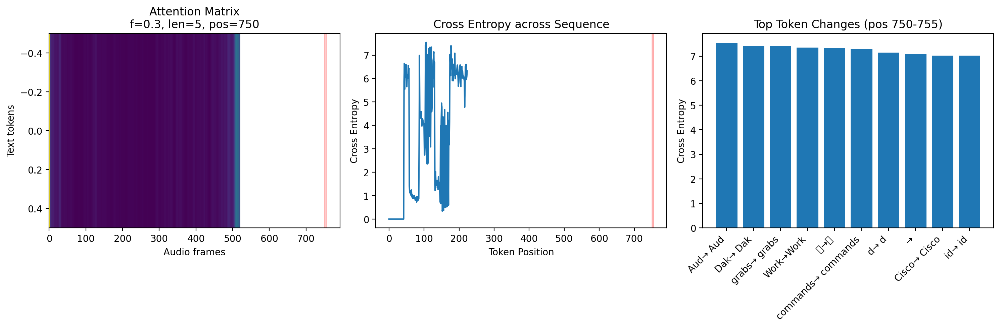


Significant changes detected at position 750:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


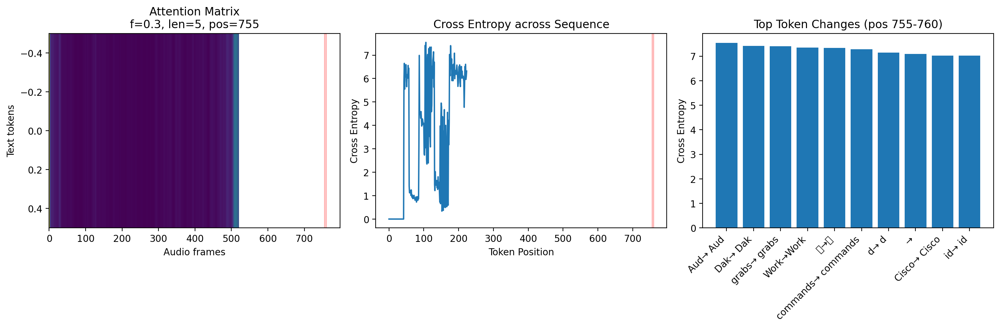


Significant changes detected at position 755:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


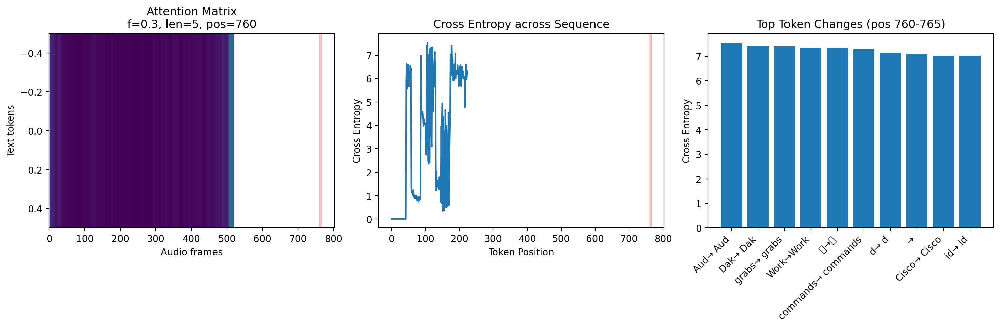


Significant changes detected at position 760:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


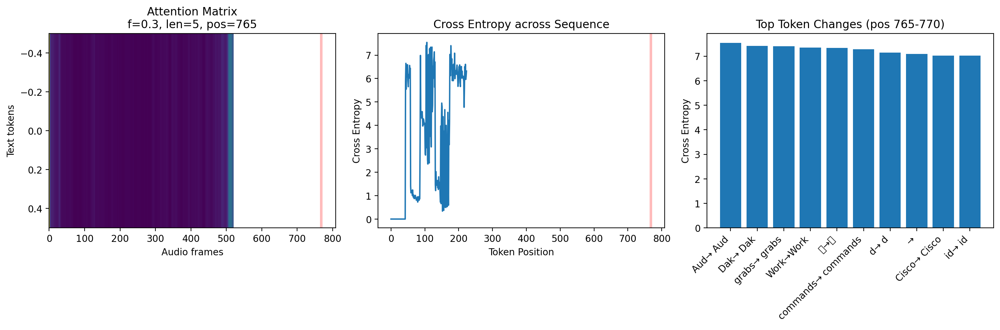


Significant changes detected at position 765:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


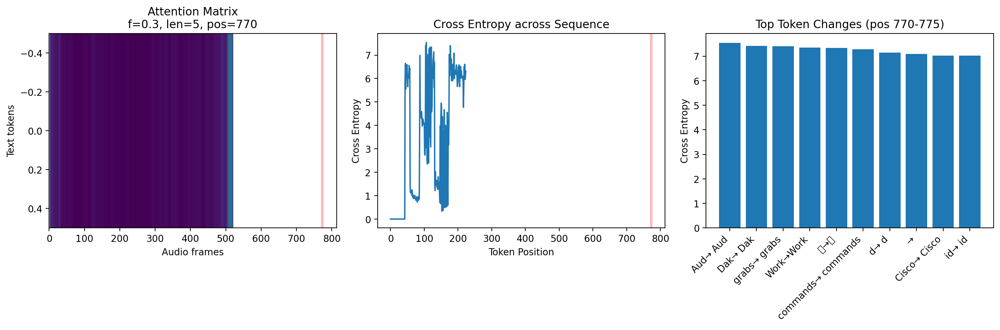


Significant changes detected at position 770:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


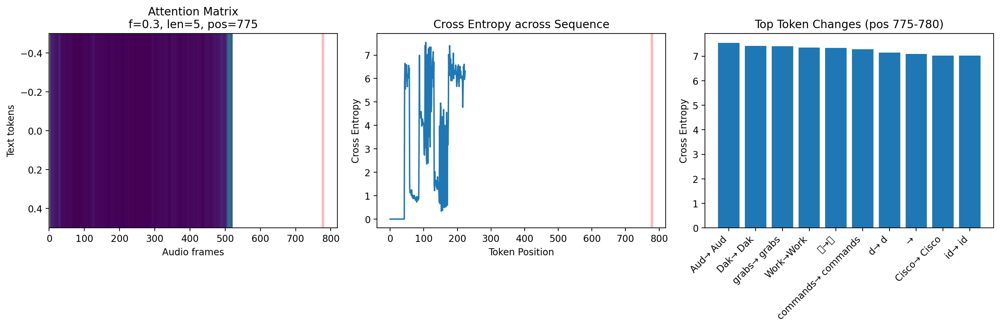


Significant changes detected at position 775:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


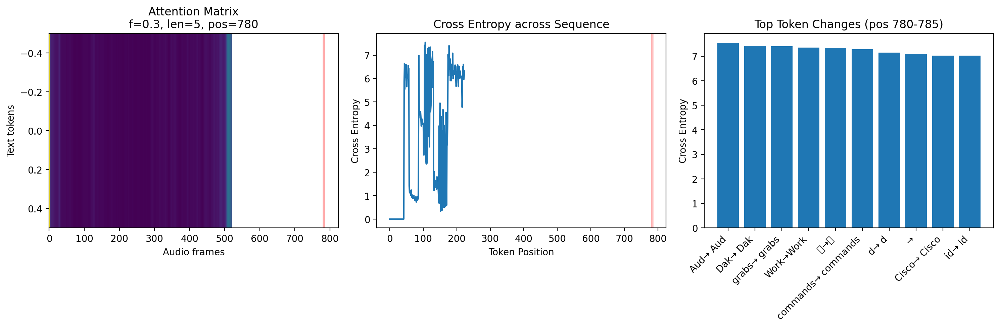


Significant changes detected at position 780:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


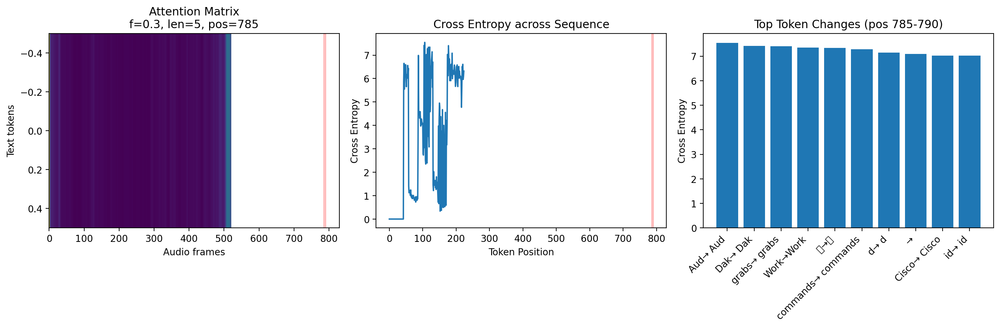


Significant changes detected at position 785:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


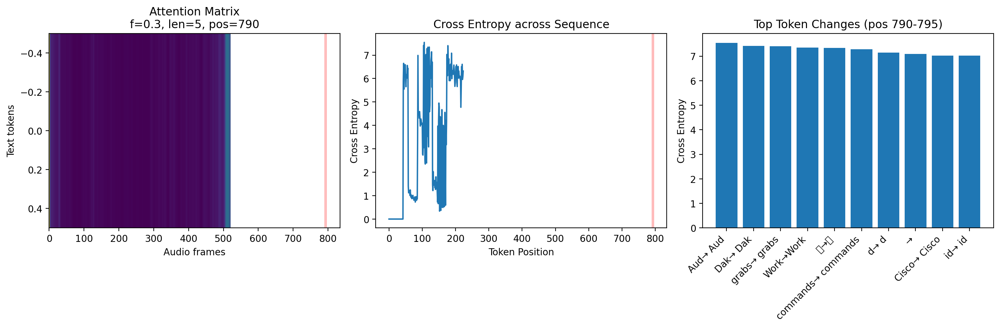


Significant changes detected at position 790:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


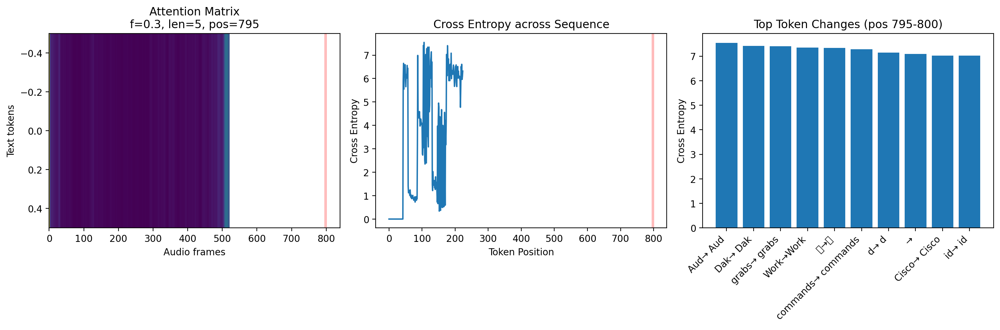


Significant changes detected at position 795:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


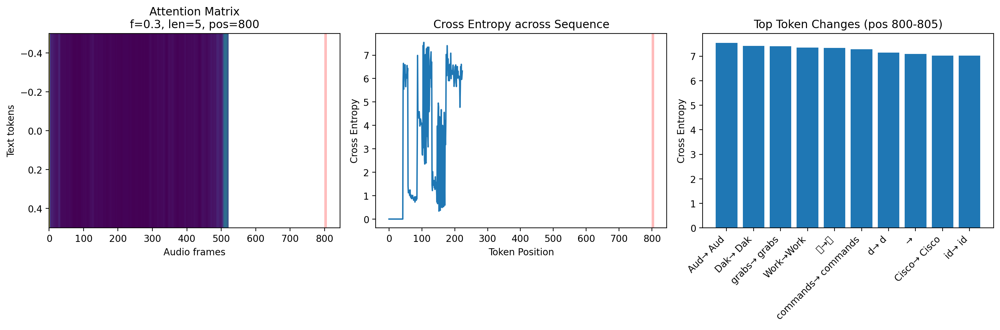


Significant changes detected at position 800:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


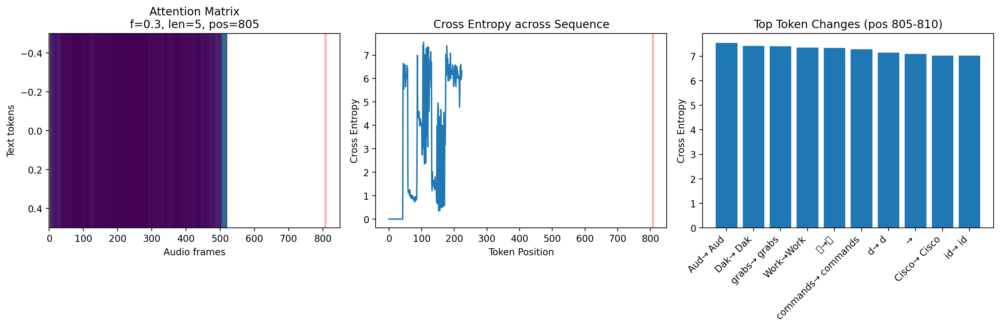


Significant changes detected at position 805:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


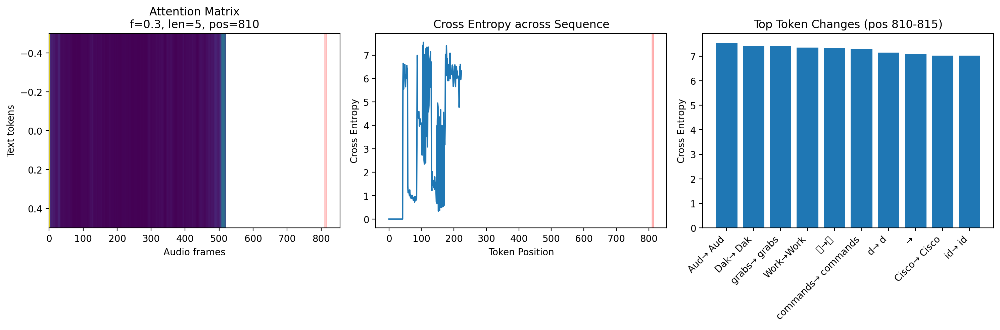


Significant changes detected at position 810:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


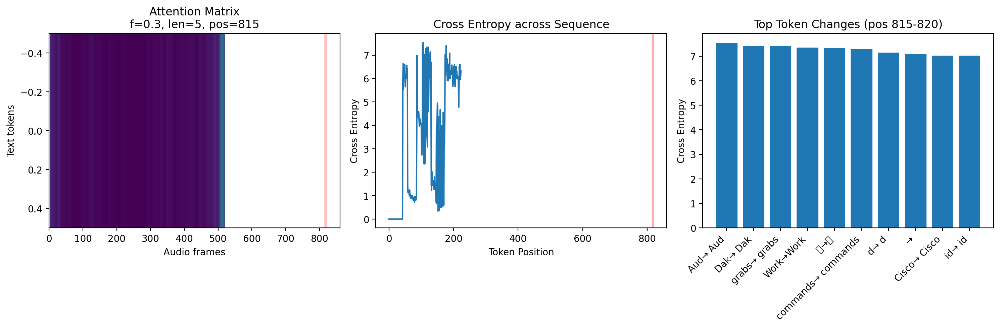


Significant changes detected at position 815:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


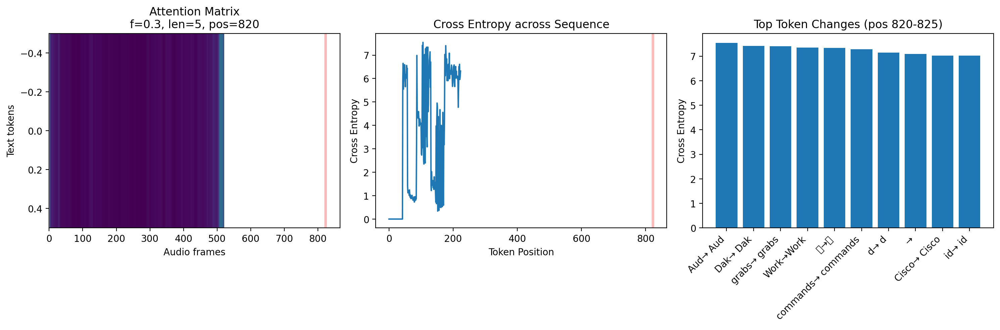


Significant changes detected at position 820:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


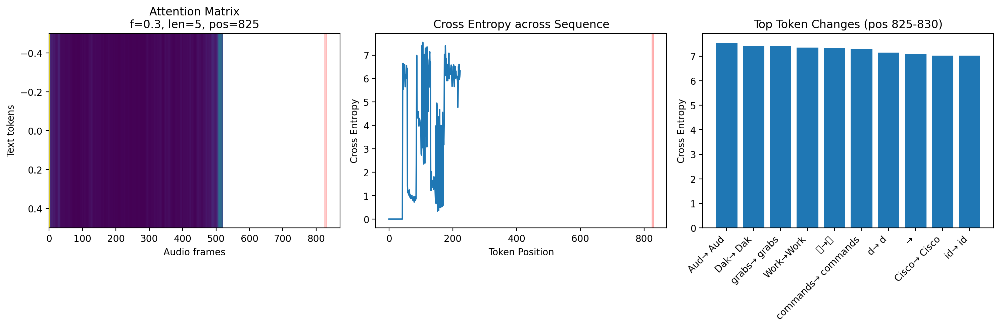


Significant changes detected at position 825:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


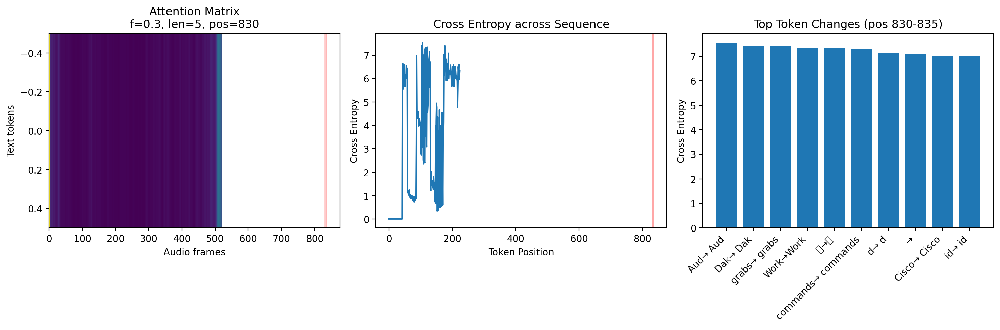


Significant changes detected at position 830:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


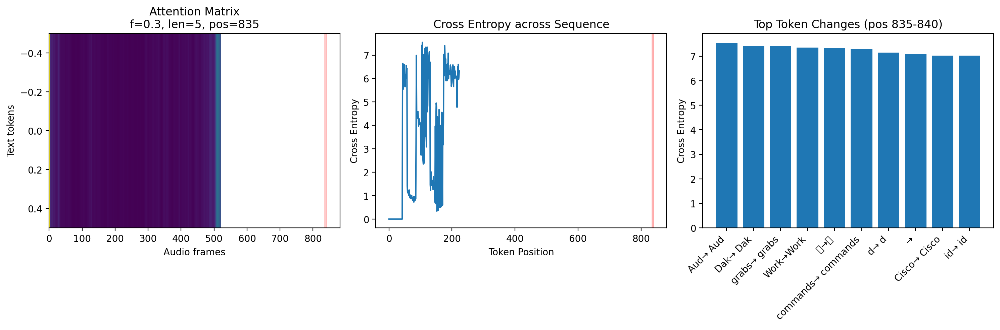


Significant changes detected at position 835:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


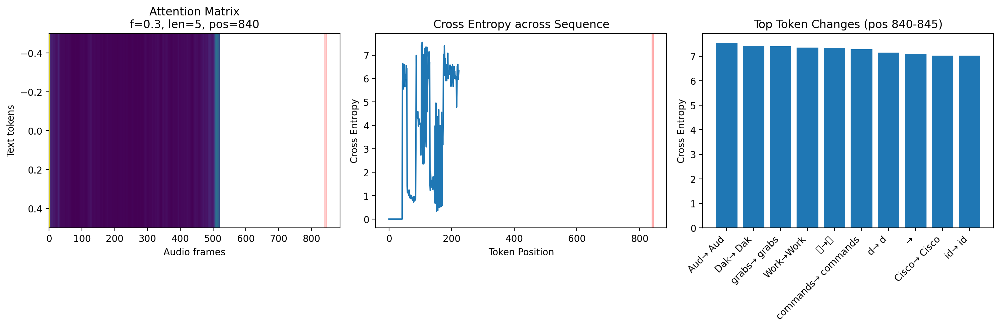


Significant changes detected at position 840:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


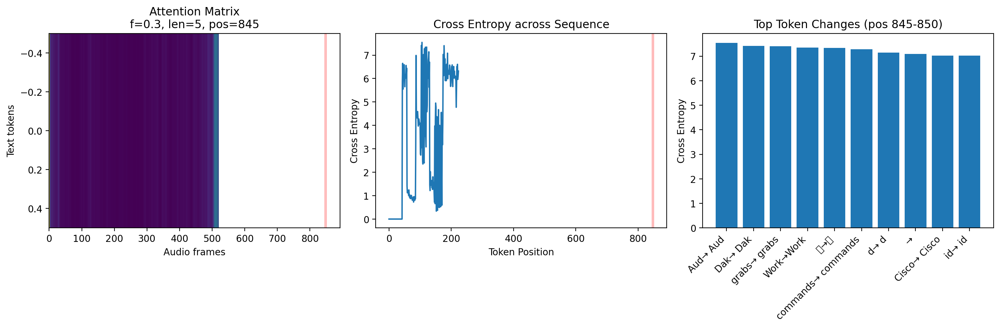


Significant changes detected at position 845:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


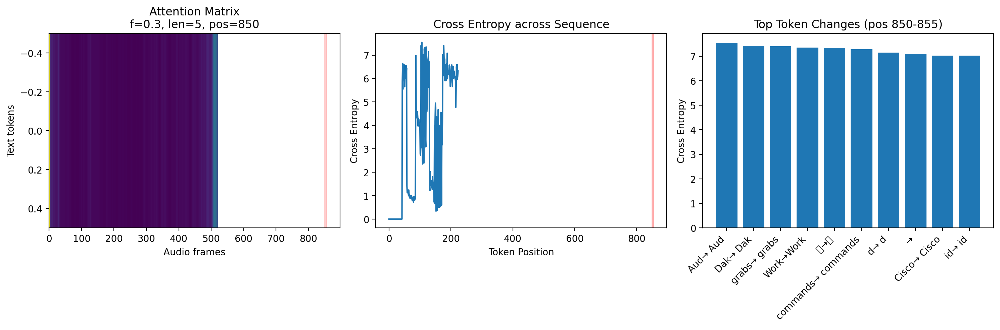


Significant changes detected at position 850:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


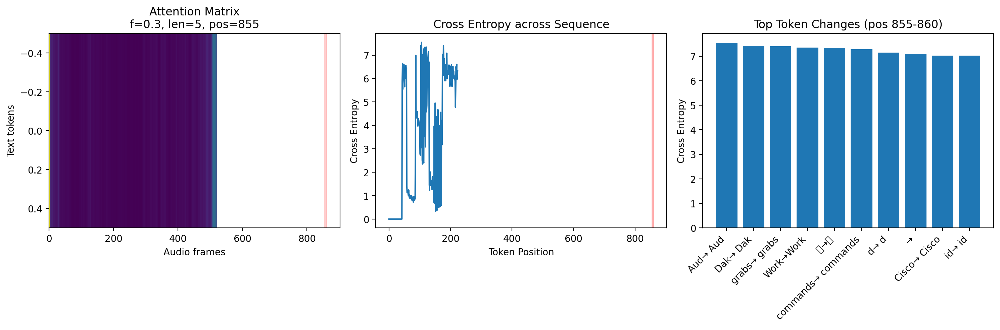


Significant changes detected at position 855:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


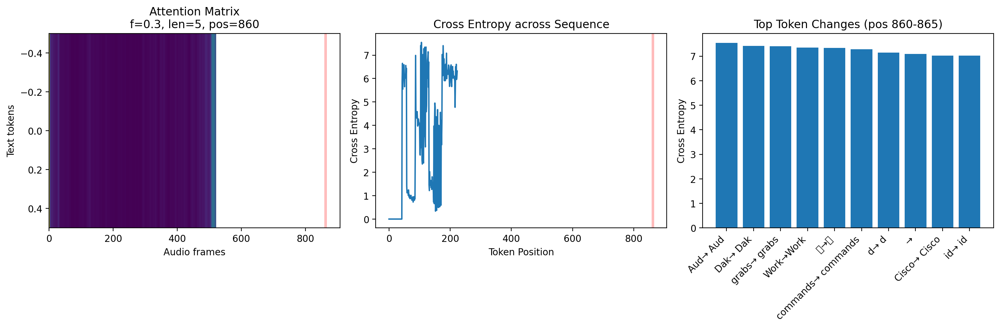


Significant changes detected at position 860:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


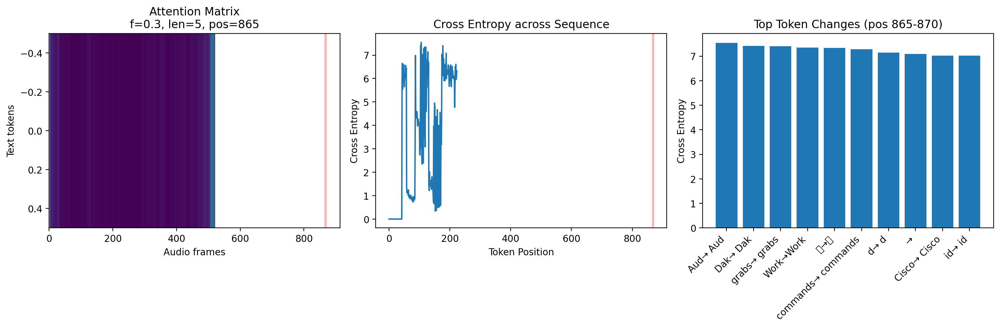


Significant changes detected at position 865:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


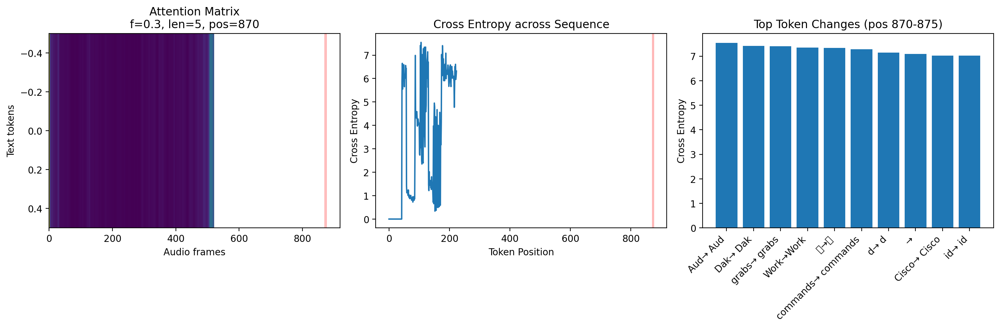


Significant changes detected at position 870:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


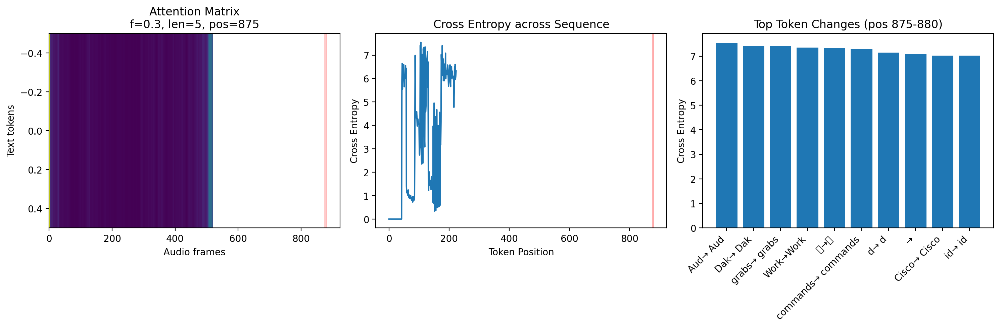


Significant changes detected at position 875:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


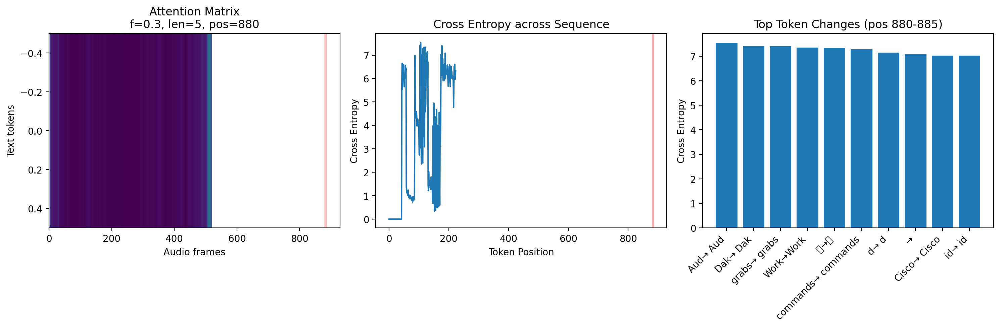


Significant changes detected at position 880:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


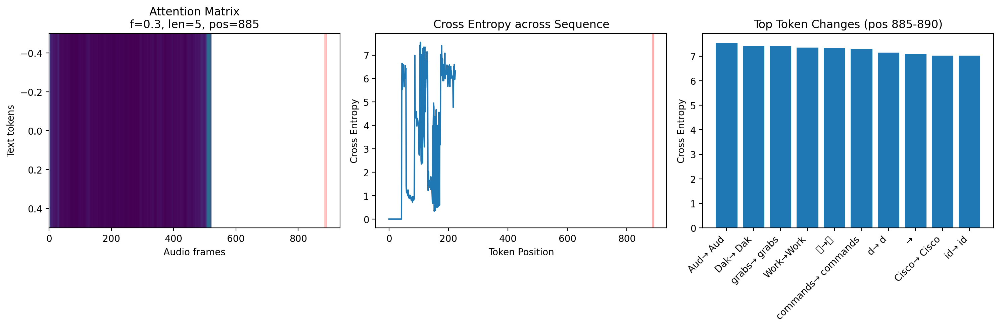


Significant changes detected at position 885:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


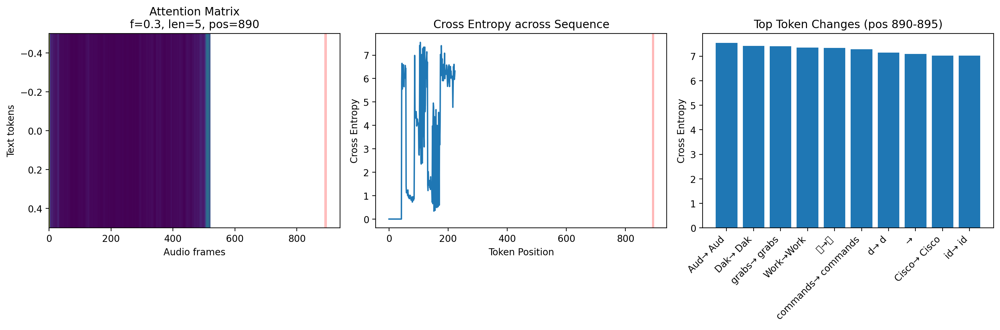


Significant changes detected at position 890:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


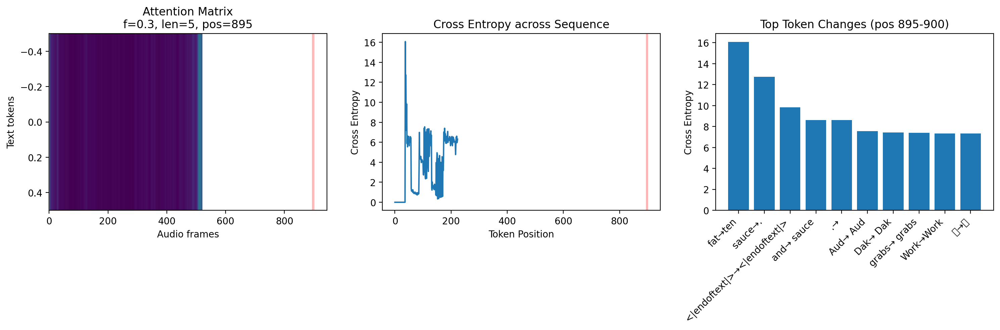


Significant changes detected at position 895:
Position 37: fat → ten
  Baseline prob: 0.884
  Perturbed prob: 0.549
  Cross Entropy: 16.075
Position 39:  sauce → .
  Baseline prob: 0.906
  Perturbed prob: 0.848
  Cross Entropy: 12.740
Position 42: <|endoftext|> → <|endoftext|>
  Baseline prob: 0.996
  Perturbed prob: 0.000
  Cross Entropy: 9.827
Position 38:  and →  sauce
  Baseline prob: 0.305
  Perturbed prob: 0.780
  Cross Entropy: 8.610
Position 40: . → 
  Baseline prob: 0.890
  Perturbed prob: 0.063
  Cross Entropy: 8.602
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Ent

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


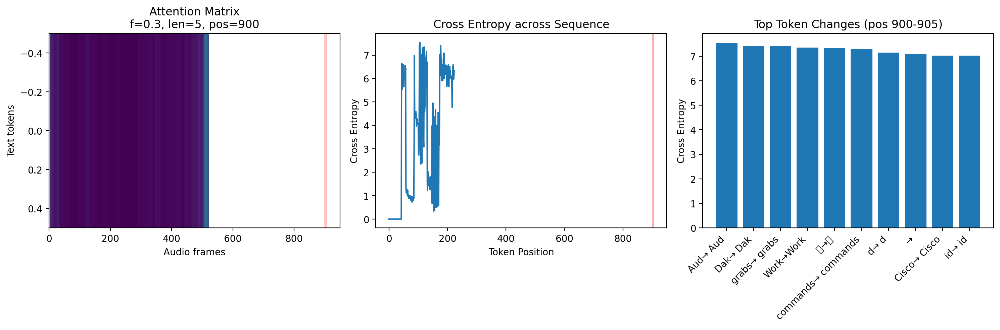


Significant changes detected at position 900:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


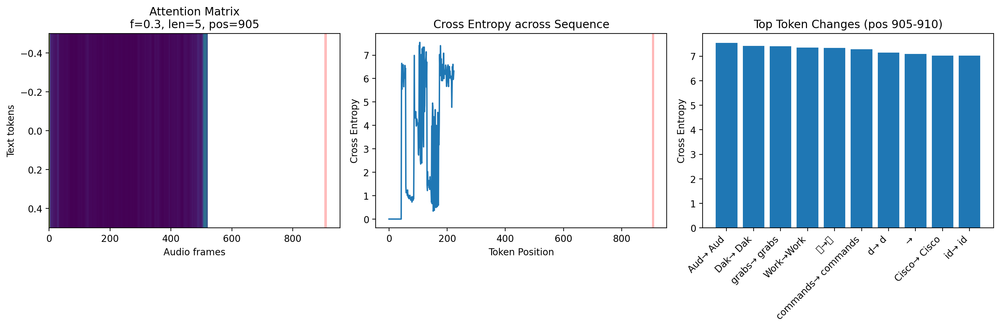


Significant changes detected at position 905:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


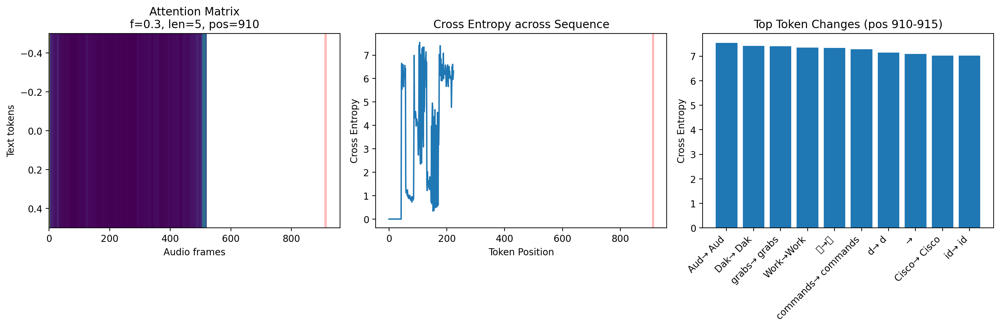


Significant changes detected at position 910:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


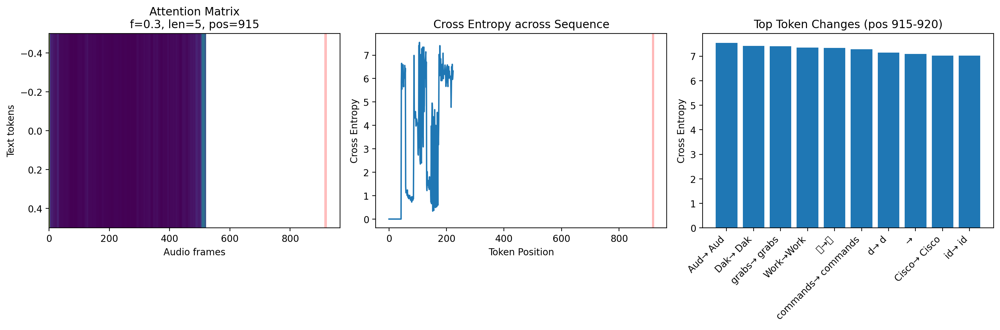


Significant changes detected at position 915:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


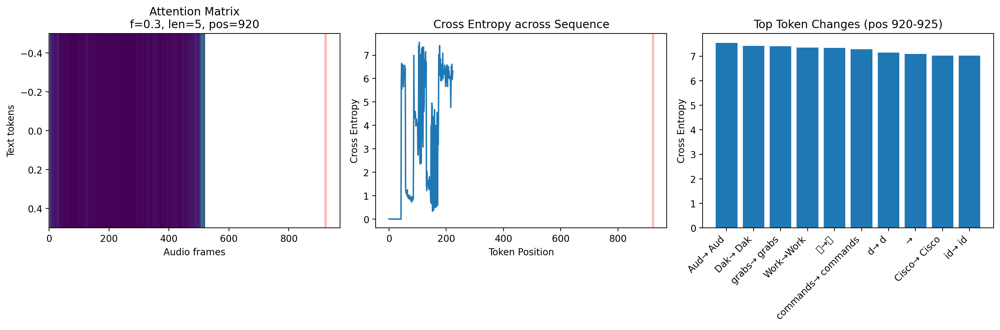


Significant changes detected at position 920:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


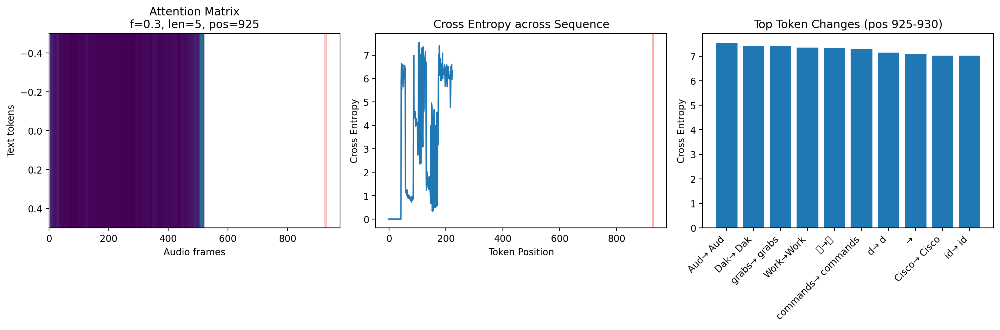


Significant changes detected at position 925:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


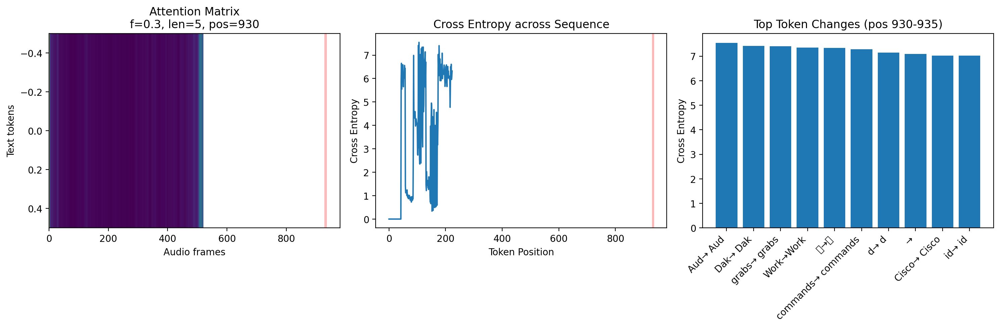


Significant changes detected at position 930:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


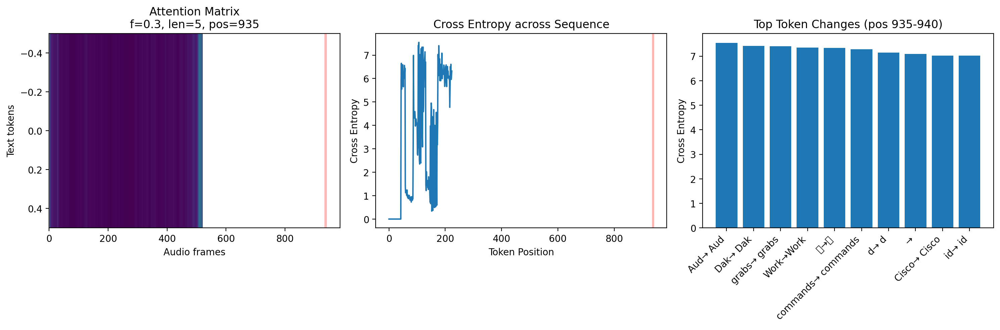


Significant changes detected at position 935:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


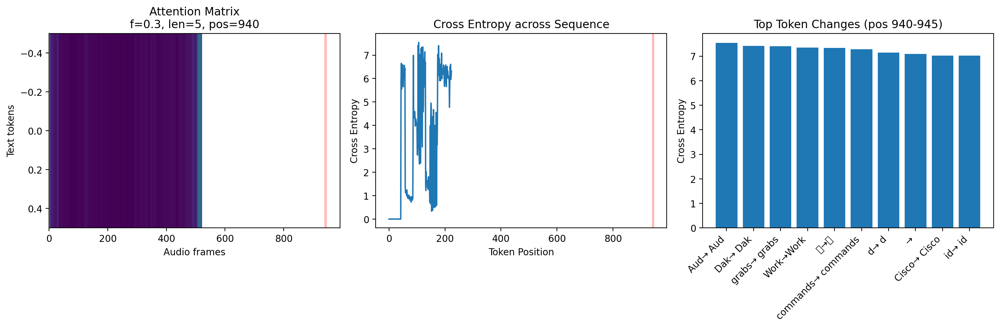


Significant changes detected at position 940:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

/tmp/ipykernel_17812/1280955213.py:118: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/arunima/anaconda3/envs/xai/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27874 (\N{CJK UNIFIED IDEOGRAPH-6CE2}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


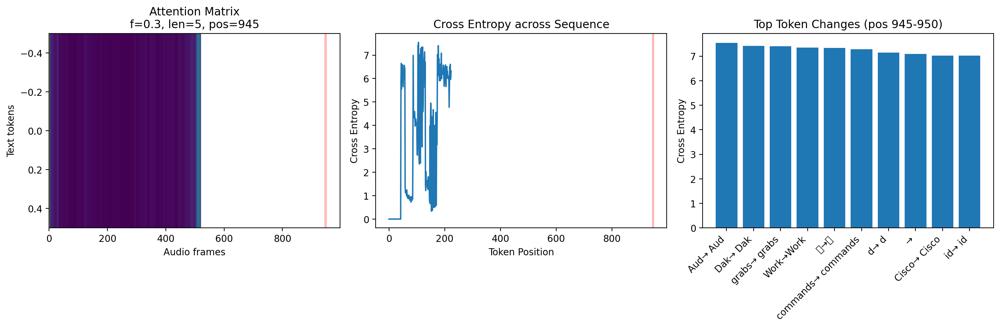


Significant changes detected at position 945:
Position 106:  Aud →  Aud
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.545
Position 104:  Dak →  Dak
  Baseline prob: 0.081
  Perturbed prob: 0.000
  Cross Entropy: 7.417
Position 177:  grabs →  grabs
  Baseline prob: 0.236
  Perturbed prob: 0.000
  Cross Entropy: 7.405
Position 121: Work → Work
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.344
Position 117: 波 → 波
  Baseline prob: 0.080
  Perturbed prob: 0.000
  Cross Entropy: 7.339
Position 114:  commands →  commands
  Baseline prob: 0.076
  Perturbed prob: 0.000
  Cross Entropy: 7.277
Position 128:  d →  d
  Baseline prob: 0.100
  Perturbed prob: 0.000
  Cross Entropy: 7.141
Position 188:  → 
  Baseline prob: 0.231
  Perturbed prob: 0.000
  Cross Entropy: 7.084
Position 174:  Cisco →  Cisco
  Baseline prob: 0.192
  Perturbed prob: 0.000
  Cross Entropy: 7.029
Position 111:  id →  id
  Baseline prob: 0.062
  Perturbed prob: 0.000
  Cross Entropy: 7

KeyboardInterrupt: 

In [57]:
import numpy as np
import torch.nn as nn
from torch.nn.functional import cross_entropy
import torch.nn.functional as F

def analyze_token_changes(baseline_logits, perturbed_logits, tokenizer, top_k=10):
    """
    Analyze token-level changes between baseline and perturbed outputs
    Returns token-wise cross entropy and top changed tokens
    """
    # Calculate token-wise cross entropy
    baseline_probs = F.softmax(baseline_logits, dim=-1)
    perturbed_probs = F.softmax(perturbed_logits, dim=-1)
    
    # Calculate KL divergence for each position
    token_ce = torch.sum(baseline_probs * torch.log(baseline_probs / perturbed_probs), dim=-1)
    # Get top-k changed positions
    top_changes = torch.topk(token_ce, min(top_k, token_ce.size(0)))
    
    # Get the actual tokens and their probabilities
    results = []
    for idx, ce_val in zip(top_changes.indices, top_changes.values):
        baseline_token = torch.argmax(baseline_probs[idx])
        perturbed_token = torch.argmax(perturbed_probs[idx])
        
        results.append({
            'position': idx.item(),
            'ce_value': ce_val.item(),
            'baseline_token': tokenizer.decode([baseline_token.item()]),
            'perturbed_token': tokenizer.decode([perturbed_token.item()]),
            'baseline_prob': baseline_probs[idx, baseline_token].item(),
            'perturbed_prob': perturbed_probs[idx, perturbed_token].item()
        })
    
    return token_ce, results

def create_suppression_dict(ind, suppresion_factor, perturbation_len):
    """Create a dictionary for suppressing attention values starting from index ind"""
    suppression_dict = {i: suppresion_factor for i in range(ind, ind + perturbation_len)}
    return suppression_dict

# For each example in the dataset
for mel, target_text, duration in tqdm(loader):
    decoded = model.decode(mel)
    transcription = decoded.text
    print("\nBaseline transcription:", transcription)
    
    # Get total perturbation length from attention matrix
    perturbation_len = model.dims.n_audio_ctx  # This is typically 1500 for Whisper
    
    # Try different suppression factors and sequence lengths
    suppression_factors = [0.3]
    suppression_seq_lengths = [ 5]  # Length of consecutive tokens to suppress
    
    for factor in suppression_factors:
        for suppression_seq_len in suppression_seq_lengths:
            print(f"\nTesting suppression factor {factor} with sequence length {suppression_seq_len}")
            
            # Iterate through positions in the sequence
            for pos in range(0, perturbation_len, suppression_seq_len):
                # Create perturbation dictionary for current position
                curr_perturbation_len = min(suppression_seq_len, perturbation_len - pos)
                perturbation_dict = create_suppression_dict(pos, factor, curr_perturbation_len)
                
                # Decode with perturbation
                options = DecodingOptions(
                    perturbation=True,
                    perturbation_tokens=perturbation_dict
                )
                
                perturbed_decoded = model.decode(mel, options)
                
                # Analyze token changes
                token_ce, top_changes = analyze_token_changes(
                    decoded.logits,
                    perturbed_decoded.logits,
                    tokenizer
                )
                
                # Visualization
                plt.figure(figsize=(15, 5))
                
                # Plot 1: Attention weights with highlighted perturbed region
                plt.subplot(1, 3, 1)
                weights = torch.cat(QKs)
                weights = weights[:, :, :, : duration // AUDIO_SAMPLES_PER_TOKEN].cpu().numpy()
                weights = median_filter(weights, (1, 1, 1, medfilt_width))
                weights = torch.tensor(weights * qk_scale).softmax(dim=-1)
                matrix = weights[-6:].mean(axis=(0, 1))
                
                plt.imshow(matrix, aspect="auto")
                # Highlight perturbed region
                plt.axvspan(pos, pos + curr_perturbation_len, color='red', alpha=0.2)
                plt.title(f"Attention Matrix\nf={factor}, len={suppression_seq_len}, pos={pos}")
                plt.xlabel("Audio frames")
                plt.ylabel("Text tokens")
                
                # Plot 2: Cross Entropy across sequence
                plt.subplot(1, 3, 2)
                plt.plot(token_ce.cpu().numpy())
                plt.axvspan(pos, pos + curr_perturbation_len, color='red', alpha=0.2)
                plt.title("Cross Entropy across Sequence")
                plt.xlabel("Token Position")
                plt.ylabel("Cross Entropy")
                
                # Plot 3: Top changed tokens
                plt.subplot(1, 3, 3)
                positions = [change['position'] for change in top_changes]
                ce_values = [change['ce_value'] for change in top_changes]
                labels = [f"{change['baseline_token']}→{change['perturbed_token']}" 
                         for change in top_changes]
                
                plt.bar(range(len(positions)), ce_values)
                plt.xticks(range(len(positions)), labels, rotation=45, ha='right')
                plt.title(f"Top Token Changes (pos {pos}-{pos+curr_perturbation_len})")
                plt.ylabel("Cross Entropy")
                
                plt.tight_layout()
                plt.show()
                
                # Print analysis if significant changes detected
                max_ce = max(ce_values) if ce_values else 0
                if max_ce > 0.1:  # Threshold for significant changes
                    print(f"\nSignificant changes detected at position {pos}:")
                    for change in top_changes:
                        if change['ce_value'] > 0.1:
                            print(f"Position {change['position']}: {change['baseline_token']} → {change['perturbed_token']}")
                            print(f"  Baseline prob: {change['baseline_prob']:.3f}")
                            print(f"  Perturbed prob: {change['perturbed_prob']:.3f}")
                            print(f"  Cross Entropy: {change['ce_value']:.3f}")
                
            print("\nCompleted analysis for current settings")
    
    break  # Only process first example